# Setup

In [1]:
import numpy as np
import polars as pl
import polars.selectors as cs
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import missingno as mn

Before proceeding, we prepare some utility functions.

Feature description is found in `feature_definitions.csv`.

In [2]:
df_feature_definitions = pl.read_csv('/kaggle/input/home-credit-credit-risk-model-stability/feature_definitions.csv')

In [3]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(50)
    display(df_feature_definitions.head())

Variable,Description
str,str
"""actualdpd_943P""","""Days Past Due (DPD) of previous contract (actual)…"
"""actualdpdtolerance_344P""","""DPD of client with tolerance."""
"""addres_district_368M""","""District of the person's address."""
"""addres_role_871L""","""Role of person's address."""
"""addres_zip_823M""","""Zip code of the address."""


Select specific features.

In [4]:
def get_feature_definitions(columns):
    return pl.DataFrame({'Variable': columns}).join(
        df_feature_definitions,
        on = 'Variable',
        how = 'left',
    )

In [5]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(50)
    display(get_feature_definitions(['actualdpd_943P', 'addres_zip_823M']))

Variable,Description
str,str
"""actualdpd_943P""","""Days Past Due (DPD) of previous contract (actual)…"
"""addres_zip_823M""","""Zip code of the address."""


Some features should be of dtype `date` (or `datetime`).

> Various predictors were transformed, therefore we have the following notation for similar groups of transformations
> 
> - P - Transform DPD (Days past due)
> - M - Masking categories
> - A - Transform amount
> - D - Transform date
> - T - Unspecified Transform
> - L - Unspecified Transform
> 
> Please note that transformations within a group are denoted by a capital letter at the end of the predictor name (e.g., maxdbddpdtollast6m_4187119P). We hope that this will simplify the manipulation with predictors.

We cast columns ending `D` to `datetime` at read time.
Also note that we use `pl.scan_parquet()` to save memory.

In [6]:
def scan_data_and_parse_dates(parquet_file):
    return pl.scan_parquet(parquet_file).with_columns(
        pl.col(r'^.*D$').str.to_datetime(),
    )

Function to plot (hist+kde & box) features of a specific transformation group.

In [7]:
def plot_numerical(df, group, max_samples = 1000000):
    X = df.select(pl.col(f'^.*{group}$')).collect()
    if len(X) > max_samples:
        X = X.sample(max_samples, seed = 0)
    n = X.shape[1]
    fig, axes = plt.subplots(n, 2, figsize = (16, n * 4), squeeze = False)
    for i, c in enumerate(X.iter_columns()):
        x = c.to_pandas()
        sns.histplot(x = x, bins = 50, kde = True, ax = axes[i, 0])
        sns.boxplot(y = x, ax = axes[i, 1])
    fig.tight_layout()

Function to plot (count & pie) features of a specific transformation group.

In [8]:
def plot_categorical(df, group, max_categories = 30, max_samples = 1000000):
    X = df.select(pl.col(f'^.*{group}$')).collect()
    if len(X) > max_samples:
        X = X.sample(max_samples, seed = 0)
    n = X.shape[1]
    fig, axes = plt.subplots(n, 2, figsize = (16, n * 4), squeeze = False)
    for i, c in enumerate(X.iter_columns()):
        x = c.to_pandas()
        s = x.value_counts()
        if len(s) > max_categories:
            other_count = s[max_categories:].sum()
            s = s[:max_categories]
            s['Other'] = other_count
        sns.barplot(x = s.index, y = s, ax = axes[i, 0])
        axes[i, 1].pie(s, labels = s.index)
    fig.tight_layout()

Function to plot correlation among a group.

In [9]:
def plot_corr(df, group, max_samples = 1000000):
    X = df.select(pl.col(f'^.*{group}$')).collect()
    if len(X) > max_samples:
        X = X.sample(max_samples, seed = 0)
    corr = X.to_pandas(use_pyarrow_extension_array = True).corr()
    w = len(corr)
    h = int(w * 0.8)
    _, ax = plt.subplots(figsize = (w, h))
    sns.heatmap(corr, ax = ax, vmin = -1, vmax = 1, annot = True, cmap = 'coolwarm')

Function to plot null values.

In [10]:
def plot_null(df, group, max_samples = 1000000):
    X = df.select(pl.col(f'^.*{group}$')).collect()
    if len(X) > max_samples:
        X = X.sample(max_samples, seed = 0)
    n = max(X.shape[1], 8)
    X = X.to_pandas(use_pyarrow_extension_array = True)
    fig, axes = plt.subplots(2, figsize = (n, int(1.6 * n)))
    mn.matrix(X, ax = axes[0], sparkline = False)
    mn.heatmap(X, ax = axes[1])
    fig.tight_layout()

Function to plot numerical variables, grouped by target.

In [11]:
def plot_numerical_by_target(df_base, df, group, max_samples = 1000000):
    df_base = df_base.lazy()
    X = df_base.join(
        df, on = 'case_id', how = 'left',
    ).select('target', pl.col(f'^.*{group}$')).collect()
    if len(X) > max_samples:
        X = X.sample(max_samples, seed = 0)
    y = X['target'].to_pandas()
    X = X.drop('target')
    n = X.shape[1]
    fig, axes = plt.subplots(n, 2, figsize = (16, n * 4), squeeze = False)
    for i, c in enumerate(X.iter_columns()):
        x = c.to_pandas()
        sns.violinplot(x = y, y = x, orient = 'v', order = [0, 1], ax = axes[i, 0])
        sns.stripplot(x = y, y = x, orient = 'v', order = [0, 1], ax = axes[i, 1],
                      marker = '.')
    fig.tight_layout()

# Base table

In [12]:
df_train_base = pl.read_parquet('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_base.parquet')
df_train_base = df_train_base.with_columns(
    pl.col('date_decision').str.to_datetime(),
)

In [13]:
display(df_train_base.head())

case_id,date_decision,MONTH,WEEK_NUM,target
i64,datetime[μs],i64,i64,i64
0,2019-01-03 00:00:00,201901,0,0
1,2019-01-03 00:00:00,201901,0,0
2,2019-01-04 00:00:00,201901,0,0
3,2019-01-03 00:00:00,201901,0,0
4,2019-01-04 00:00:00,201901,0,1


In [14]:
display(df_train_base.describe())

describe,case_id,date_decision,MONTH,WEEK_NUM,target
str,f64,str,f64,f64,f64
"""count""",1.526659e6,"""1526659""",1.526659e6,1.526659e6,1.526659e6
"""null_count""",0.0,"""0""",0.0,0.0,0.0
"""mean""",1.2861e6,null,201936.287982,40.769036,0.031437
"""std""",718946.592285,null,44.735975,23.797981,0.174496
"""min""",0.0,"""2019-01-01 00:…",201901.0,0.0,0.0
"""25%""",766198.0,null,201906.0,23.0,0.0
"""50%""",1.357358e6,null,201910.0,40.0,0.0
"""75%""",1.739023e6,null,202001.0,55.0,0.0
"""max""",2.703454e6,"""2020-10-05 00:…",202010.0,91.0,1.0


In [15]:
display(df_train_base['target'].value_counts())

target,count
i64,u32
1,47994
0,1478665


In [16]:
display(df_train_base['target'].value_counts().with_columns(pl.col('count') / len(df_train_base)))

target,count
i64,f64
1,0.031437
0,0.968563


- The target is imbalanced. Only 3% of the entries have defaulted.

`MONTH` column is redundant. Indeed, `year * 100 + month == MONTH`.

In [17]:
display(df_train_base.select(
    (
        pl.col('date_decision').dt.year() * 100 + pl.col('date_decision').dt.month()
         == pl.col('MONTH')
    ).all()))

date_decision
bool
true


`WEEK_NUM` is also redundant. It is the week counting from `2019-01-01`.

In [18]:
display(df_train_base.group_by('WEEK_NUM').agg(pl.col('date_decision').min()).sort('WEEK_NUM').head())

WEEK_NUM,date_decision
i64,datetime[μs]
0,2019-01-01 00:00:00
1,2019-01-08 00:00:00
2,2019-01-15 00:00:00
3,2019-01-22 00:00:00
4,2019-01-29 00:00:00


In [19]:
display(df_train_base.select(
    (
        (pl.col('date_decision') - pl.date(2019, 1, 1)).dt.total_days() // 7
        == pl.col('WEEK_NUM')
    ).all()
))

date_decision
bool
true


`case_id` is a unique identifier.

In [20]:
print(df_train_base['case_id'].n_unique() == len(df_train_base))

True


Plot date.

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


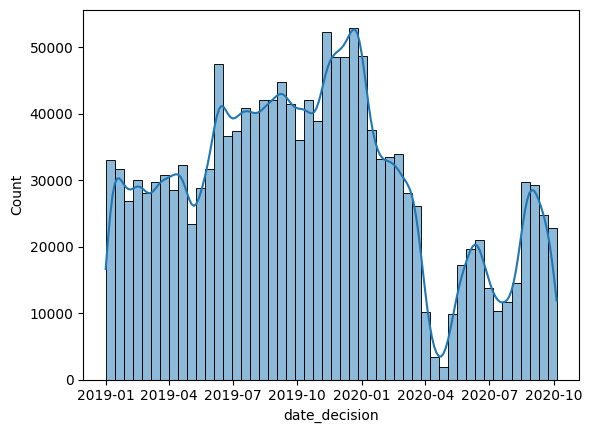

In [21]:
sns.histplot(x = df_train_base['date_decision'].to_pandas(),
             bins = 50,
             kde = True);

- The number of cases significantly decreased around `2020-04`. Might affect CV.

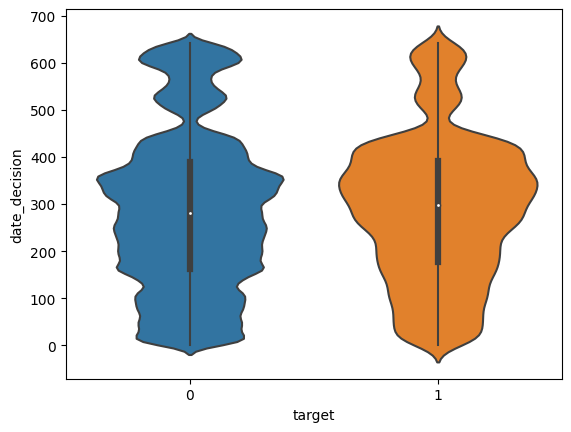

In [22]:
sns.violinplot(y = df_train_base.select((pl.col('date_decision') - pl.date(2019, 1, 1)).dt.total_days())['date_decision'].to_pandas(),
               x = df_train_base['target'].to_pandas(),
               orient = 'v');

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


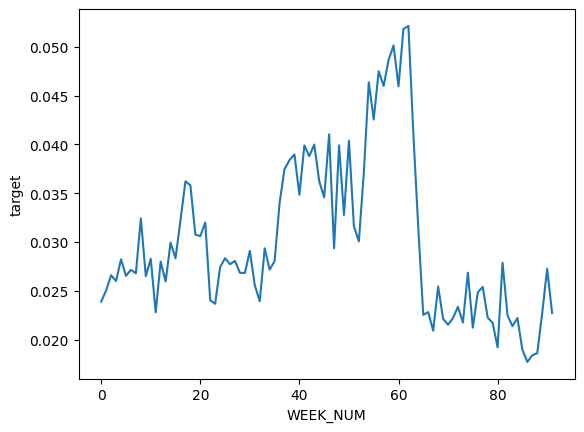

In [23]:
sns.lineplot(df_train_base.group_by('WEEK_NUM').agg(pl.col('target').mean()).to_pandas(),
             x = 'WEEK_NUM', y = 'target');

# static_0

There are two files for static depth 0.

In [24]:
df_train_static_0_0 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_static_0_0.parquet')
df_train_static_0_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_static_0_1.parquet')

They have the same schema.

In [25]:
print(df_train_static_0_0.schema == df_train_static_0_1.schema)

True


So we may scan all tables of the same kind at the same time and concatenate them.
`pl.scan_parquet()` does this job given a globbing pattern.

In [26]:
df_train_static_0 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_static_0_*.parquet')

In [27]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(200)
    cfg.set_tbl_rows(-1)
    display(get_feature_definitions(df_train_static_0.columns))

Variable,Description
str,str
"""case_id""",null
"""actualdpdtolerance_344P""","""DPD of client with tolerance."""
"""amtinstpaidbefduel24m_4187115A""","""Number of instalments paid before due date in the last 24 months."""
"""annuity_780A""","""Monthly annuity amount."""
"""annuitynextmonth_57A""","""Next month's amount of annuity."""
"""applicationcnt_361L""","""Number of applications associated with the same email address as the client."""
"""applications30d_658L""","""Number of applications made by the client in the last 30 days."""
"""applicationscnt_1086L""","""Number of applications associated with the same phone number."""
"""applicationscnt_464L""","""Number of applications made in the last 30 days by other clients with the same employer as the applicant."""


In [28]:
with pl.Config() as cfg:
    cfg.set_tbl_cols(-1)
    display(df_train_static_0.head().collect())

case_id,actualdpdtolerance_344P,amtinstpaidbefduel24m_4187115A,annuity_780A,annuitynextmonth_57A,applicationcnt_361L,applications30d_658L,applicationscnt_1086L,applicationscnt_464L,applicationscnt_629L,applicationscnt_867L,avgdbddpdlast24m_3658932P,avgdbddpdlast3m_4187120P,avgdbdtollast24m_4525197P,avgdpdtolclosure24_3658938P,avginstallast24m_3658937A,avglnamtstart24m_4525187A,avgmaxdpdlast9m_3716943P,avgoutstandbalancel6m_4187114A,avgpmtlast12m_4525200A,bankacctype_710L,cardtype_51L,clientscnt12m_3712952L,clientscnt3m_3712950L,clientscnt6m_3712949L,clientscnt_100L,clientscnt_1022L,clientscnt_1071L,clientscnt_1130L,clientscnt_136L,clientscnt_157L,clientscnt_257L,clientscnt_304L,clientscnt_360L,clientscnt_493L,clientscnt_533L,clientscnt_887L,clientscnt_946L,cntincpaycont9m_3716944L,cntpmts24_3658933L,commnoinclast6m_3546845L,credamount_770A,credtype_322L,currdebt_22A,currdebtcredtyperange_828A,datefirstoffer_1144D,datelastinstal40dpd_247D,datelastunpaid_3546854D,daysoverduetolerancedd_3976961L,deferredmnthsnum_166L,disbursedcredamount_1113A,disbursementtype_67L,downpmt_116A,dtlastpmtallstes_4499206D,eir_270L,equalitydataagreement_891L,equalityempfrom_62L,firstclxcampaign_1125D,firstdatedue_489D,homephncnt_628L,inittransactionamount_650A,inittransactioncode_186L,interestrate_311L,interestrategrace_34L,isbidproduct_1095L,isbidproductrequest_292L,isdebitcard_729L,lastactivateddate_801D,lastapplicationdate_877D,lastapprcommoditycat_1041M,lastapprcommoditytypec_5251766M,lastapprcredamount_781A,lastapprdate_640D,lastcancelreason_561M,lastdelinqdate_224D,lastdependentsnum_448L,lastotherinc_902A,lastotherlnsexpense_631A,lastrejectcommoditycat_161M,lastrejectcommodtypec_5251769M,lastrejectcredamount_222A,lastrejectdate_50D,lastrejectreason_759M,lastrejectreasonclient_4145040M,lastrepayingdate_696D,lastst_736L,maininc_215A,mastercontrelectronic_519L,mastercontrexist_109L,maxannuity_159A,maxannuity_4075009A,maxdbddpdlast1m_3658939P,maxdbddpdtollast12m_3658940P,maxdbddpdtollast6m_4187119P,maxdebt4_972A,maxdpdfrom6mto36m_3546853P,maxdpdinstldate_3546855D,maxdpdinstlnum_3546846P,maxdpdlast12m_727P,maxdpdlast24m_143P,maxdpdlast3m_392P,maxdpdlast6m_474P,maxdpdlast9m_1059P,maxdpdtolerance_374P,maxinstallast24m_3658928A,maxlnamtstart6m_4525199A,maxoutstandbalancel12m_4187113A,maxpmtlast3m_4525190A,mindbddpdlast24m_3658935P,mindbdtollast24m_4525191P,mobilephncnt_593L,monthsannuity_845L,numactivecreds_622L,numactivecredschannel_414L,numactiverelcontr_750L,numcontrs3months_479L,numincomingpmts_3546848L,numinstlallpaidearly3d_817L,numinstls_657L,numinstlsallpaid_934L,numinstlswithdpd10_728L,numinstlswithdpd5_4187116L,numinstlswithoutdpd_562L,numinstmatpaidtearly2d_4499204L,numinstpaid_4499208L,numinstpaidearly3d_3546850L,numinstpaidearly3dest_4493216L,numinstpaidearly5d_1087L,numinstpaidearly5dest_4493211L,numinstpaidearly5dobd_4499205L,numinstpaidearly_338L,numinstpaidearlyest_4493214L,numinstpaidlastcontr_4325080L,numinstpaidlate1d_3546852L,numinstregularpaid_973L,numinstregularpaidest_4493210L,numinsttopaygr_769L,numinsttopaygrest_4493213L,numinstunpaidmax_3546851L,numinstunpaidmaxest_4493212L,numnotactivated_1143L,numpmtchanneldd_318L,numrejects9m_859L,opencred_647L,paytype1st_925L,paytype_783L,payvacationpostpone_4187118D,pctinstlsallpaidearl3d_427L,pctinstlsallpaidlat10d_839L,pctinstlsallpaidlate1d_3546856L,pctinstlsallpaidlate4d_3546849L,pctinstlsallpaidlate6d_3546844L,pmtnum_254L,posfpd10lastmonth_333P,posfpd30lastmonth_3976960P,posfstqpd30lastmonth_3976962P,previouscontdistrict_112M,price_1097A,sellerplacecnt_915L,sellerplacescnt_216L,sumoutstandtotal_3546847A,sumoutstandtotalest_4493215A,totaldebt_9A,totalsettled_863A,totinstallast1m_4525188A,twobodfilling_608L,typesuite_864L,validfrom_1069D
i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,f64,f64,datetime[μs],datetime[μs],datetime[μs],f64,f64,f64,str,f64,datetime[μs],

In [29]:
with pl.Config() as cfg:
    cfg.set_tbl_cols(-1)
    display(df_train_static_0.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,actualdpdtolerance_344P,amtinstpaidbefduel24m_4187115A,annuity_780A,annuitynextmonth_57A,applicationcnt_361L,applications30d_658L,applicationscnt_1086L,applicationscnt_464L,applicationscnt_629L,applicationscnt_867L,avgdbddpdlast24m_3658932P,avgdbddpdlast3m_4187120P,avgdbdtollast24m_4525197P,avgdpdtolclosure24_3658938P,avginstallast24m_3658937A,avglnamtstart24m_4525187A,avgmaxdpdlast9m_3716943P,avgoutstandbalancel6m_4187114A,avgpmtlast12m_4525200A,clientscnt12m_3712952L,clientscnt3m_3712950L,clientscnt6m_3712949L,clientscnt_100L,clientscnt_1022L,clientscnt_1071L,clientscnt_1130L,clientscnt_136L,clientscnt_157L,clientscnt_257L,clientscnt_304L,clientscnt_360L,clientscnt_493L,clientscnt_533L,clientscnt_887L,clientscnt_946L,cntincpaycont9m_3716944L,cntpmts24_3658933L,commnoinclast6m_3546845L,credamount_770A,currdebt_22A,currdebtcredtyperange_828A,datefirstoffer_1144D,datelastinstal40dpd_247D,datelastunpaid_3546854D,daysoverduetolerancedd_3976961L,deferredmnthsnum_166L,disbursedcredamount_1113A,downpmt_116A,dtlastpmtallstes_4499206D,eir_270L,firstclxcampaign_1125D,firstdatedue_489D,homephncnt_628L,inittransactionamount_650A,interestrate_311L,interestrategrace_34L,lastactivateddate_801D,lastapplicationdate_877D,lastapprcredamount_781A,lastapprdate_640D,lastdelinqdate_224D,lastdependentsnum_448L,lastotherinc_902A,lastotherlnsexpense_631A,lastrejectcredamount_222A,lastrejectdate_50D,lastrepayingdate_696D,maininc_215A,mastercontrelectronic_519L,mastercontrexist_109L,maxannuity_159A,maxannuity_4075009A,maxdbddpdlast1m_3658939P,maxdbddpdtollast12m_3658940P,maxdbddpdtollast6m_4187119P,maxdebt4_972A,maxdpdfrom6mto36m_3546853P,maxdpdinstldate_3546855D,maxdpdinstlnum_3546846P,maxdpdlast12m_727P,maxdpdlast24m_143P,maxdpdlast3m_392P,maxdpdlast6m_474P,maxdpdlast9m_1059P,maxdpdtolerance_374P,maxinstallast24m_3658928A,maxlnamtstart6m_4525199A,maxoutstandbalancel12m_4187113A,maxpmtlast3m_4525190A,mindbddpdlast24m_3658935P,mindbdtollast24m_4525191P,mobilephncnt_593L,monthsannuity_845L,numactivecreds_622L,numactivecredschannel_414L,numactiverelcontr_750L,numcontrs3months_479L,numincomingpmts_3546848L,numinstlallpaidearly3d_817L,numinstls_657L,numinstlsallpaid_934L,numinstlswithdpd10_728L,numinstlswithdpd5_4187116L,numinstlswithoutdpd_562L,numinstmatpaidtearly2d_4499204L,numinstpaid_4499208L,numinstpaidearly3d_3546850L,numinstpaidearly3dest_4493216L,numinstpaidearly5d_1087L,numinstpaidearly5dest_4493211L,numinstpaidearly5dobd_4499205L,numinstpaidearly_338L,numinstpaidearlyest_4493214L,numinstpaidlastcontr_4325080L,numinstpaidlate1d_3546852L,numinstregularpaid_973L,numinstregularpaidest_4493210L,numinsttopaygr_769L,numinsttopaygrest_4493213L,numinstunpaidmax_3546851L,numinstunpaidmaxest_4493212L,numnotactivated_1143L,numpmtchanneldd_318L,numrejects9m_859L,payvacationpostpone_4187118D,pctinstlsallpaidearl3d_427L,pctinstlsallpaidlat10d_839L,pctinstlsallpaidlate1d_3546856L,pctinstlsallpaidlate4d_3546849L,pctinstlsallpaidlate6d_3546844L,pmtnum_254L,posfpd10lastmonth_333P,posfpd30lastmonth_3976960P,posfstqpd30lastmonth_3976962P,price_1097A,sellerplacecnt_915L,sellerplacescnt_216L,sumoutstandtotal_3546847A,sumoutstandtotalest_4493215A,totaldebt_9A,totalsettled_863A,totinstallast1m_4525188A,validfrom_1069D
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,str,f64,f64,f64,f64,str,f64,str,str,f64,f64,f64,f64,str,str,f64,str,str,f64,f64,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str
"""count""",1.526659e6,1.108481e6,965535.0,1.526659e6,1.526655e6,1.526659e6,1.526659e6,1.526659e6,1.526659e6,1.526659e6,1.526659e6,913457.0,578415.0,553832.0,1.059484e6,9

In [30]:
display(df_train_static_0.select(cs.by_dtype(pl.String).n_unique()).collect())

bankacctype_710L,cardtype_51L,credtype_322L,disbursementtype_67L,inittransactioncode_186L,lastapprcommoditycat_1041M,lastapprcommoditytypec_5251766M,lastcancelreason_561M,lastrejectcommoditycat_161M,lastrejectcommodtypec_5251769M,lastrejectreason_759M,lastrejectreasonclient_4145040M,lastst_736L,paytype1st_925L,paytype_783L,previouscontdistrict_112M,twobodfilling_608L,typesuite_864L
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
2,3,4,4,4,45,214,74,45,187,18,14,12,2,2,223,3,2


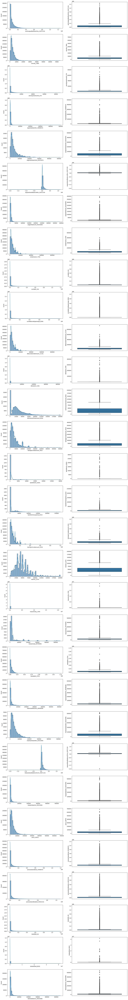

In [31]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_static_0, 'A')

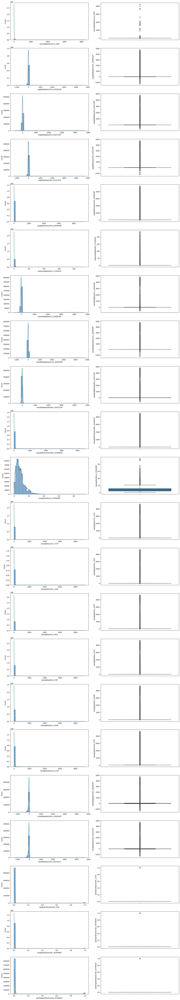

In [32]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_static_0, 'P')

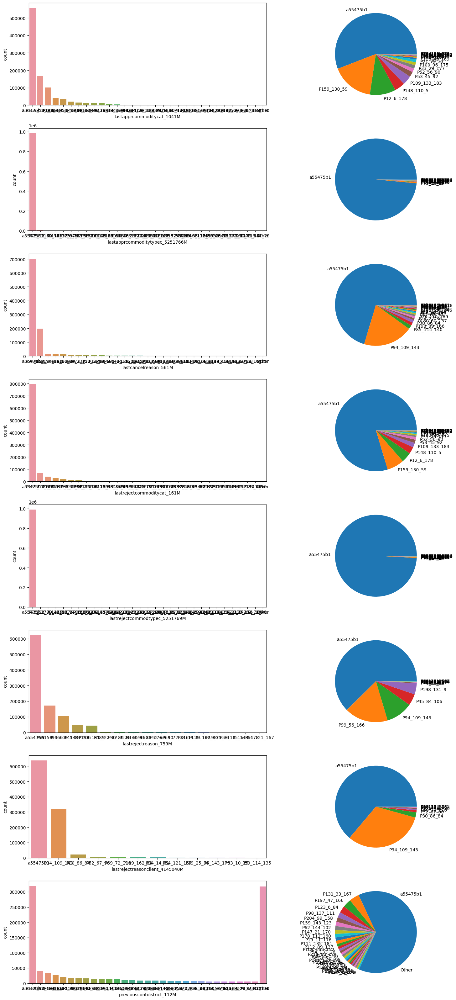

In [33]:
plot_categorical(df_train_static_0, 'M')

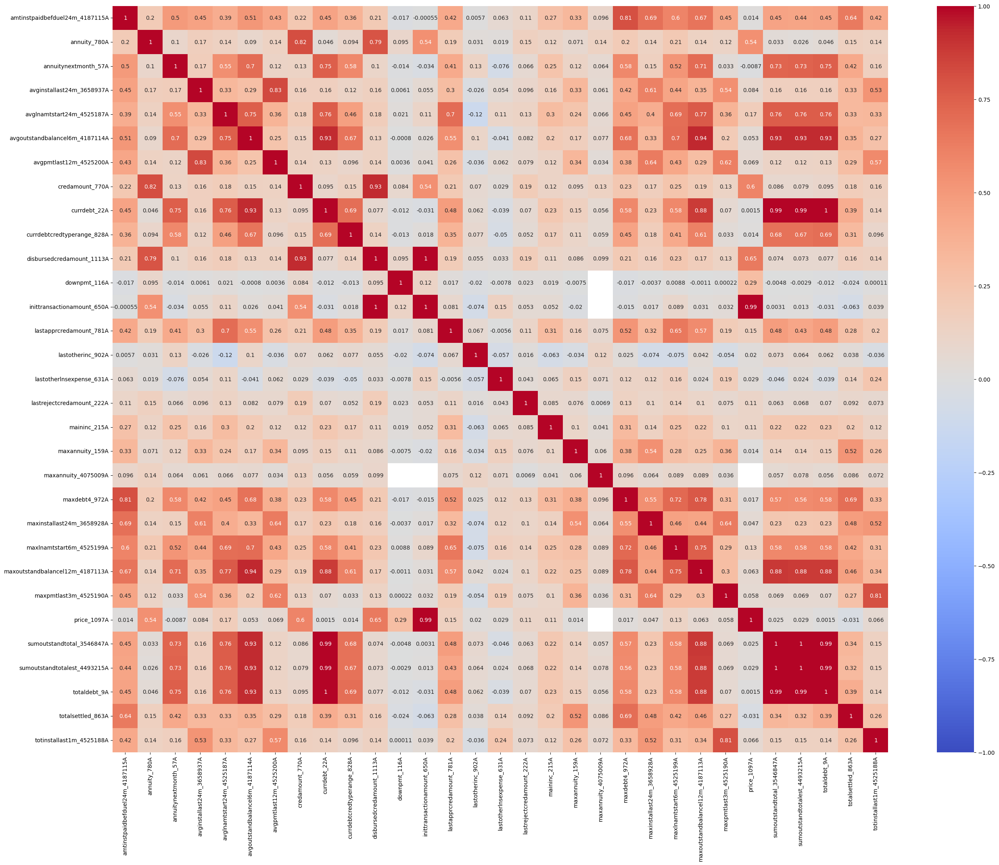

In [34]:
plot_corr(df_train_static_0, 'A')

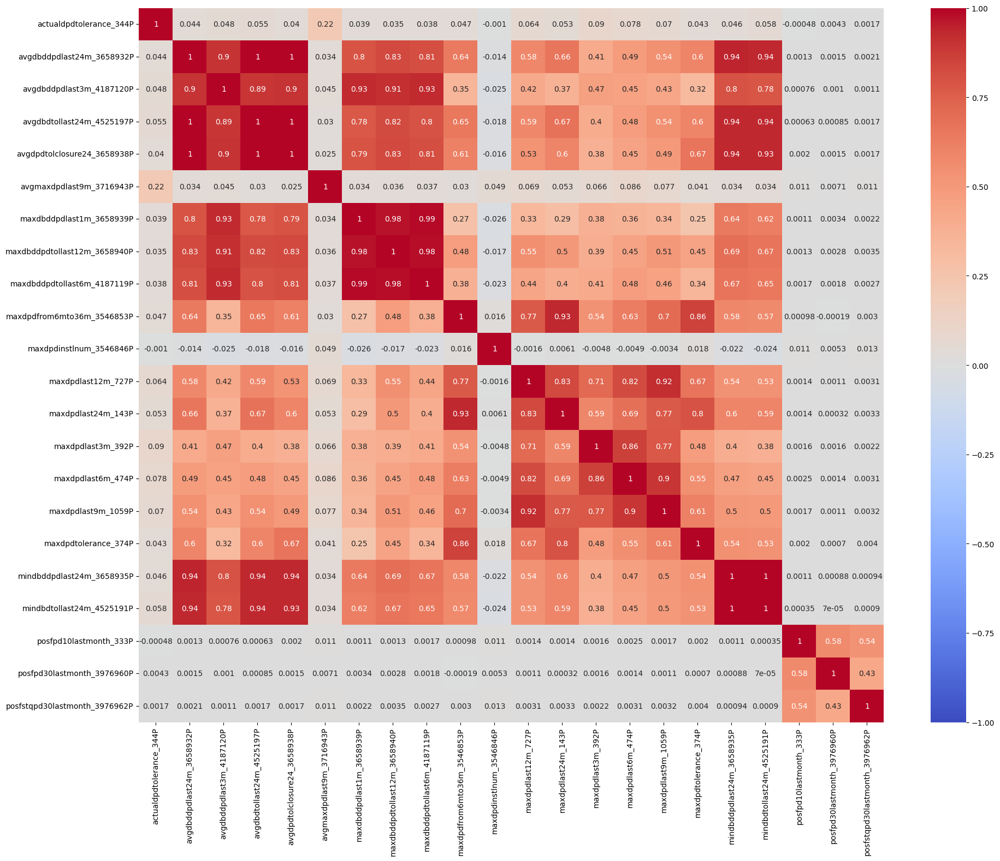

In [35]:
plot_corr(df_train_static_0, 'P')

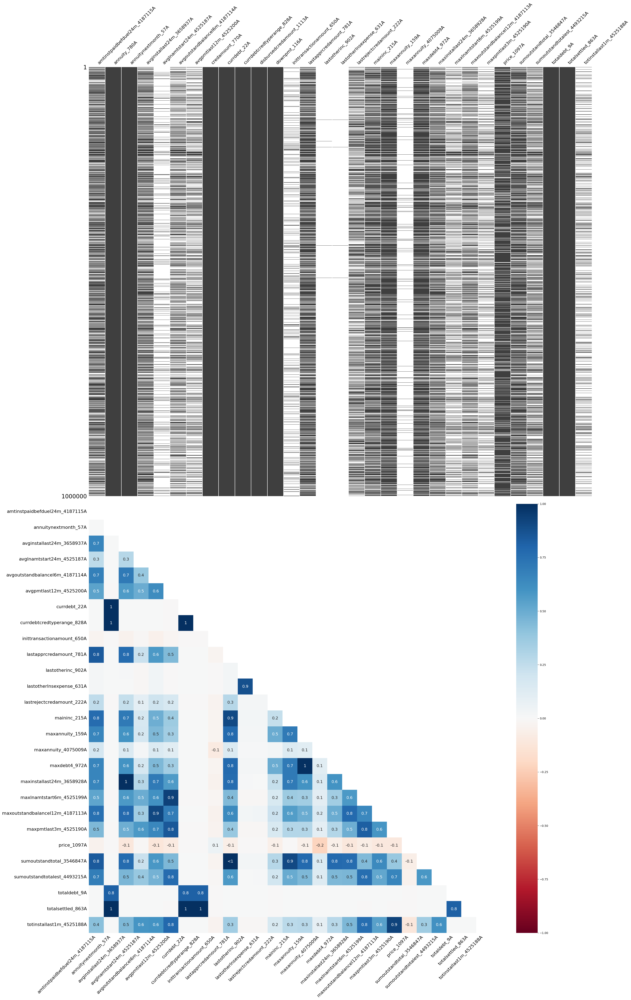

In [36]:
plot_null(df_train_static_0, 'A')

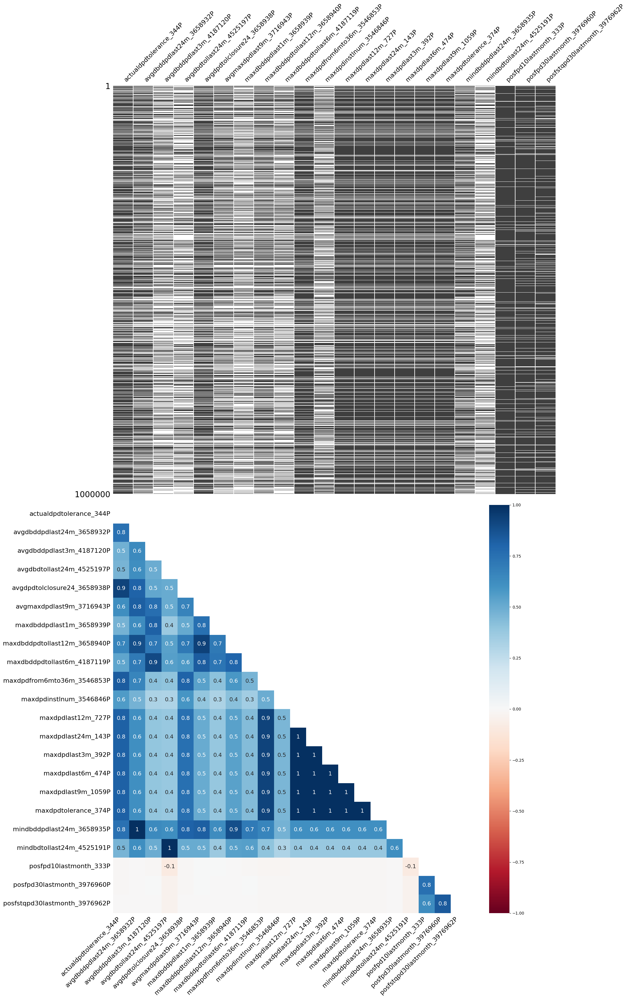

In [37]:
plot_null(df_train_static_0, 'P')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


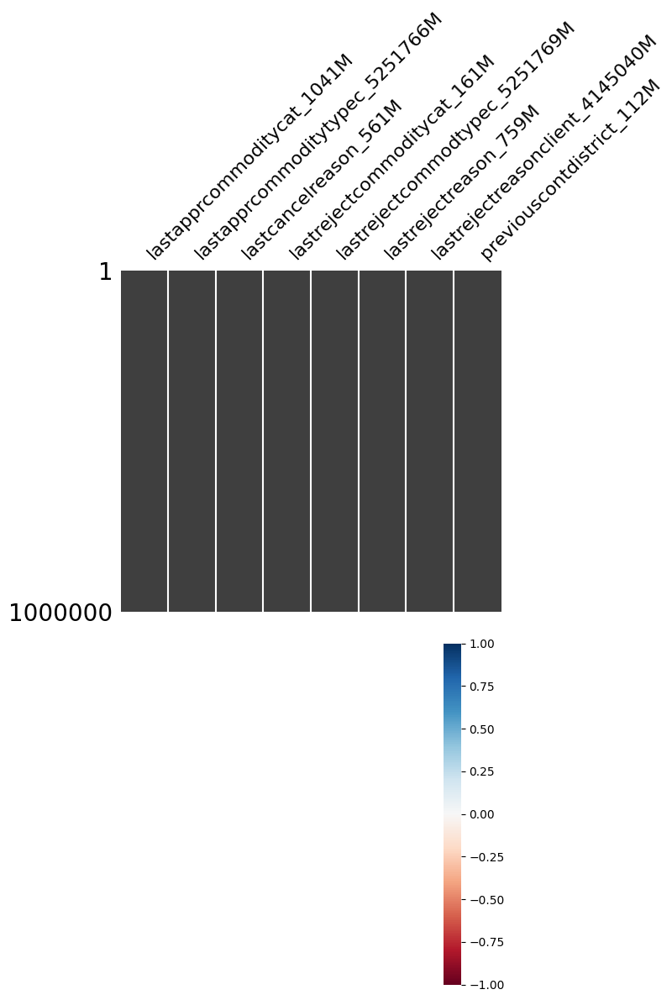

In [38]:
plot_null(df_train_static_0, 'M')

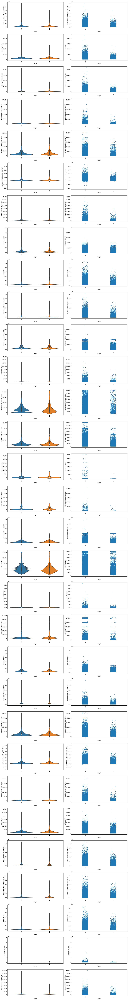

In [39]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_static_0, 'A')

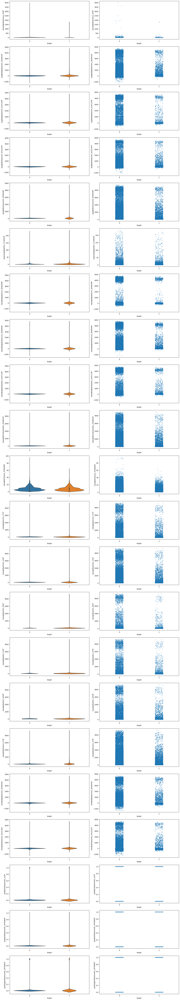

In [40]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_static_0, 'P')

> Each group of tables can comprise one or more individual tables. If a group contains more than one table, they are divided based on `WEEK_NUM`.

In [41]:
import glob

with pl.Config() as cfg:
    cfg.set_tbl_rows(-1)
    for f in glob.iglob('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_static_0_*.parquet'):
        display(
            pl.scan_parquet(f)
            .join(df_train_base.lazy(), on = 'case_id', how = 'left')
            .select(pl.col('WEEK_NUM').unique())
            .collect()
        )

WEEK_NUM
i64
0
1
2
3
4
5
6
7
8


WEEK_NUM
i64
50
51
52
53
54
55
56
57
58


# static_cb_0

In [42]:
df_train_static_cb_0 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_static_cb_0.parquet')

In [43]:
with pl.Config() as cfg:
    cfg.set_tbl_rows(-1)
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_static_cb_0.columns))

Variable,Description
str,str
"""case_id""",null
"""assignmentdate_238D""","""Tax authority data - date of assignment."""
"""assignmentdate_4527235D""","""Tax authority data - Date of assignment."""
"""assignmentdate_4955616D""","""Tax authority assignment date."""
"""birthdate_574D""","""Client's date of birth (credit bureau data)."""
"""contractssum_5085716L""","""Total sum of values of contracts retrieved from external credit bureau."""
"""dateofbirth_337D""","""Client's date of birth."""
"""dateofbirth_342D""","""Client's date of birth."""
"""days120_123L""","""Number of credit bureau queries for the last 120 days."""


In [44]:
display(df_train_static_cb_0.head().collect())

case_id,assignmentdate_238D,assignmentdate_4527235D,assignmentdate_4955616D,birthdate_574D,contractssum_5085716L,dateofbirth_337D,dateofbirth_342D,days120_123L,days180_256L,days30_165L,days360_512L,days90_310L,description_5085714M,education_1103M,education_88M,firstquarter_103L,for3years_128L,for3years_504L,for3years_584L,formonth_118L,formonth_206L,formonth_535L,forquarter_1017L,forquarter_462L,forquarter_634L,fortoday_1092L,forweek_1077L,forweek_528L,forweek_601L,foryear_618L,foryear_818L,foryear_850L,fourthquarter_440L,maritalst_385M,maritalst_893M,numberofqueries_373L,pmtaverage_3A,pmtaverage_4527227A,pmtaverage_4955615A,pmtcount_4527229L,pmtcount_4955617L,pmtcount_693L,pmtscount_423L,pmtssum_45A,requesttype_4525192L,responsedate_1012D,responsedate_4527233D,responsedate_4917613D,riskassesment_302T,riskassesment_940T,secondquarter_766L,thirdquarter_1082L
i64,datetime[μs],datetime[μs],datetime[μs],datetime[μs],f64,datetime[μs],datetime[μs],f64,f64,f64,f64,f64,str,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,datetime[μs],datetime[μs],datetime[μs],str,f64,f64,f64
357,null,null,null,1988-04-01 00:00:00,null,null,null,null,null,null,null,null,"""a55475b1""","""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,6.0,6301.4,null,2019-01-25 00:00:00,null,null,null,null,null,null
381,null,null,null,1973-11-01 00:00:00,null,null,null,null,null,null,null,null,"""a55475b1""","""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,6.0,4019.6,null,2019-01-25 00:00:00,null,null,null,null,null,null
388,null,null,null,1989-04-01 00:00:00,null,1989-04-01 00:00:00,null,6.0,8.0,2.0,10.0,4.0,"""a55475b1""","""a55475b1""","""a55475b1""",2.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,6.0,"""a55475b1""","""a55475b1""",10.0,null,null,null,null,null,null,6.0,14548.0,null,2019-01-28 00:00:00,null,null,null,null,3.0,5.0
405,null,null,null,1974-03-01 00:00:00,null,1974-03-01 00:00:00,null,0.0,0.0,0.0,1.0,0.0,"""a55475b1""","""a55475b1""","""a55475b1""",0.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,4.0,"""a55475b1""","""a55475b1""",1.0,null,null,null,null,null,null,6.0,10498.24,null,2019-01-21 00:00:00,null,null,null,null,2.0,0.0
409,null,null,null,1993-06-01 00:00:00,null,1993-06-01 00:00:00,null,2.0,3.0,0.0,3.0,1.0,"""a55475b1""","""717ddd49""","""a55475b1""",4.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1.0,"""a7fcb6e5""","""a55475b1""",3.0,null,null,null,null,null,null,7.0,6344.8804,null,2019-01-21 00:00:00,null,null,null,null,0.0,4.0


In [45]:
display(df_train_static_cb_0.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,assignmentdate_238D,assignmentdate_4527235D,assignmentdate_4955616D,birthdate_574D,contractssum_5085716L,dateofbirth_337D,dateofbirth_342D,days120_123L,days180_256L,days30_165L,days360_512L,days90_310L,firstquarter_103L,for3years_128L,for3years_504L,for3years_584L,formonth_118L,formonth_206L,formonth_535L,forquarter_1017L,forquarter_462L,forquarter_634L,fortoday_1092L,forweek_1077L,forweek_528L,forweek_601L,foryear_618L,foryear_818L,foryear_850L,fourthquarter_440L,numberofqueries_373L,pmtaverage_3A,pmtaverage_4527227A,pmtaverage_4955615A,pmtcount_4527229L,pmtcount_4955617L,pmtcount_693L,pmtscount_423L,pmtssum_45A,responsedate_1012D,responsedate_4527233D,responsedate_4917613D,riskassesment_940T,secondquarter_766L,thirdquarter_1082L
str,f64,str,str,str,str,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,str,f64,f64,f64
"""count""",1.500476e6,"""136996""","""114978""","""71633""","""607871""",157329.0,"""1385691""","""36500""",1.385691e6,1.385691e6,1.385691e6,1.385691e6,1.385691e6,1.385691e6,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,36514.0,1.385691e6,1.385691e6,143589.0,114978.0,71845.0,114978.0,71845.0,146406.0,572638.0,572638.0,"""720000""","""660327""","""224912""",53560.0,1.385691e6,1.385691e6
"""null_count""",0.0,"""1363480""","""1385498""","""1428843""","""892605""",1.343147e6,"""114785""","""1463976""",114785.0,114785.0,114785.0,114785.0,114785.0,114785.0,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,1.463962e6,114785.0,114785.0,1.356887e6,1.385498e6,1.428631e6,1.385498e6,1.428631e6,1.35407e6,927838.0,927838.0,"""780476""","""840149""","""1275564""",1.446916e6,114785.0,114785.0
"""mean""",1.2840e6,null,null,null,null,641604.417651,null,null,1.607715,2.388656,0.517708,4.777066,1.21142,2.86059,0.000082,4.382346,0.007696,0.0,0.000356,0.236759,0.000959,0.0,0.613929,0.036945,0.000055,0.09013,0.0,0.000055,0.002081,2.420715,2.851214,4.777066,9303.1717,10033.556094,17651.732489,6.598027,13.061118,5.714991,5.839291,13199.93597,null,null,null,0.225968,2.688482,2.918342
"""std""",716088.123478,null,null,null,null,980327.297131,null,null,2.083003,2.891115,0.899238,5.168856,1.655931,3.610966,0.009064,5.815514,0.091071,0.0,0.018866,0.535493,0.033496,0.0,1.150001,0.189209,0.007401,0.291302,0.0,0.007401,0.049049,3.55246,3.431652,5.168856,5562.386995,5455.843604,6871.642301,2.188992,1.855216,1.758117,4.148264,18117.218312,null,null,null,0.97617,3.324546,3.423862
"""min""",357.0,"""1974-05-30 00:…","""2019-09-13 00:…","""1984-12-05 00:…","""1943-03-01 00:…",0.0,"""1900-01-01 00:…","""1915-01-01 00:…",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.2000003,4.4,1.0,1.0,0.0,0.0,0.0,"""2019-01-02 00:…","""2019-09-13 00:…","""2020-03-26 00:…",-3.670423,0.0,0.0
"""25%""",768509.0,null,null,null,null,78531.95,null,null,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,6590.6,7192.0,13664.601,6.0,12.0,6.0,3.0,3156.4001,null,null,null,-0.227985,0.0,0.0
"""50%""",1.361879e6,null,null,null,null,307282.4,null,null,1.0,2.0,0.0,3.0,1.0,2.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,3.0,7305.9,7553.0,15765.2,6.0,14.0,6.0,6.0,8392.0,null,null,null,0.371834,2.0,2.0
"""75%""",1.73701e6,null,null,null,null,802114.08,null,null,2.0,3.0,1.0,7.0,2.0,4.0,0.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4.0,7.0,13023.9,13464.4,21840.0,6.0,14.0,6.0,7.0,16992.0,null,null,null,0.9716525,4.0,4.0
"""max""",2.703454e6,"""2019-10-22 00:…","""2020-10-19 00:…","""2020-09-22 00:…","""1998-09-01 00:…",3.1297e7,"""2020-01-01 00:…","""2015-09-01 00:…",109.0,110.0,22.0,115.0,41.0,76.0,1.0,57.0,2.0,0.0,1.0,11.0,2.0,0.0,19.0,2.0,1.0,4

In [46]:
display(df_train_static_cb_0.select(cs.by_dtype(pl.String).n_unique()).collect())

description_5085714M,education_1103M,education_88M,maritalst_385M,maritalst_893M,requesttype_4525192L,riskassesment_302T
u32,u32,u32,u32,u32,u32,u32
2,5,5,6,6,4,17


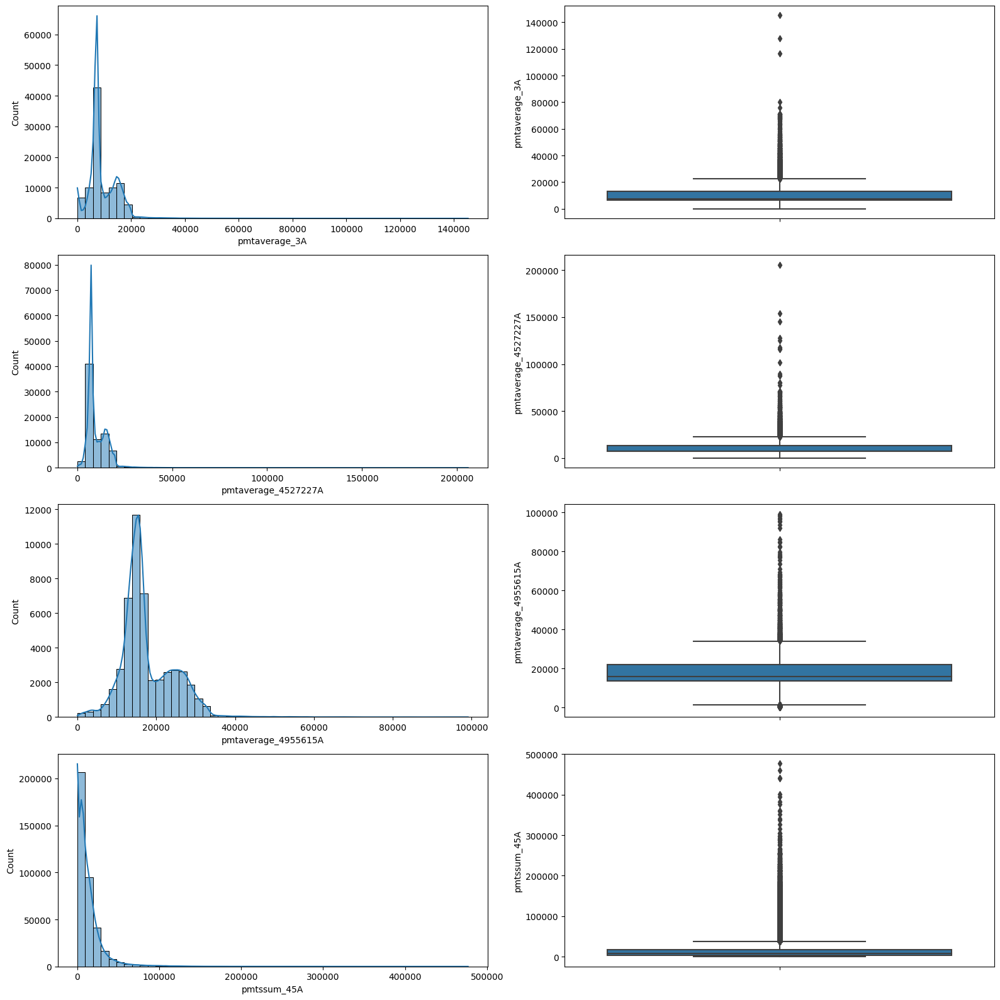

In [47]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_static_cb_0, 'A')

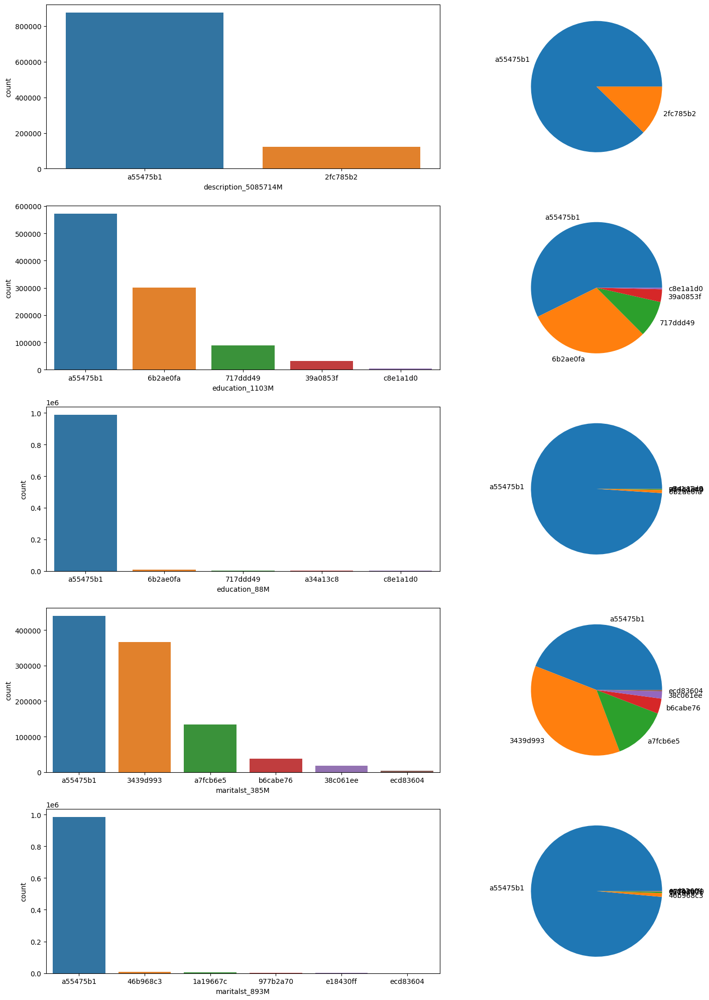

In [48]:
plot_categorical(df_train_static_cb_0, 'M')

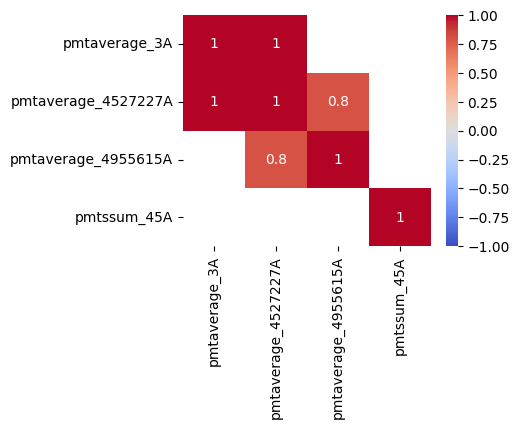

In [49]:
plot_corr(df_train_static_cb_0, 'A')

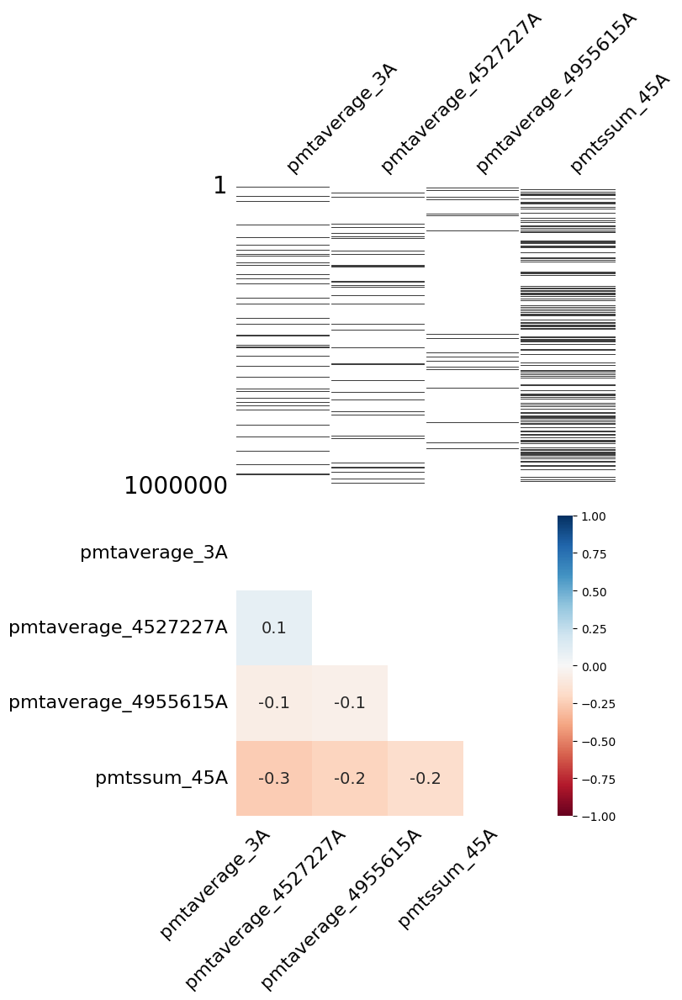

In [50]:
plot_null(df_train_static_cb_0, 'A')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


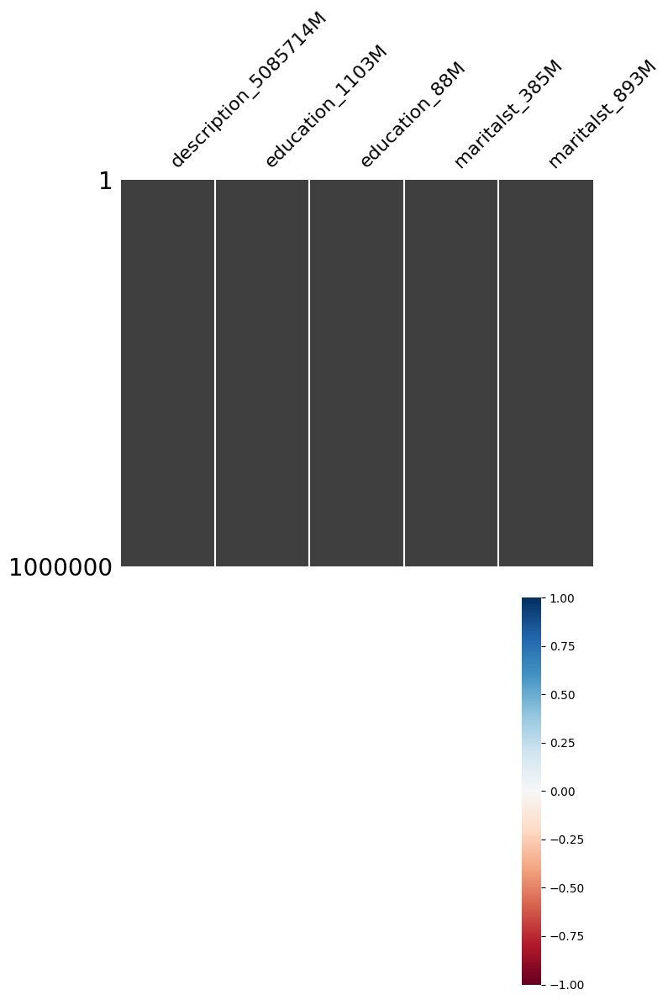

In [51]:
plot_null(df_train_static_cb_0, 'M')

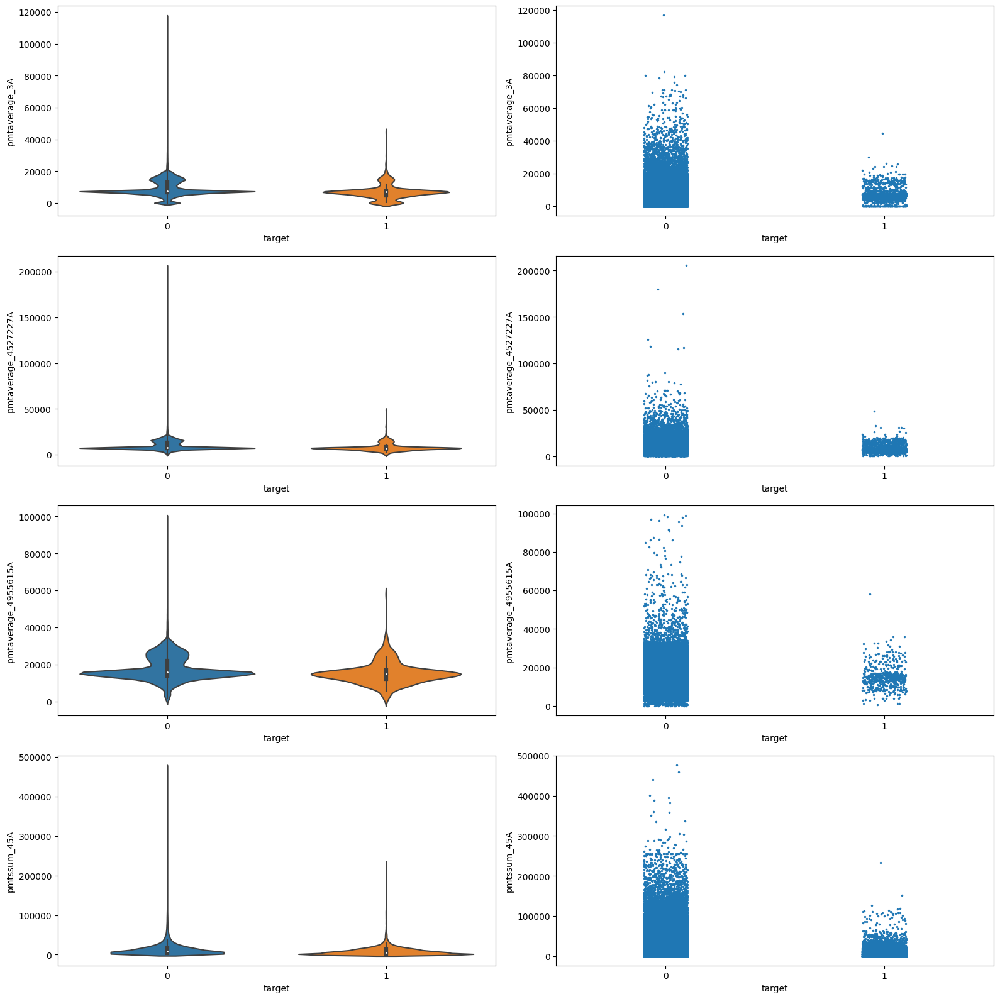

In [52]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_static_cb_0, 'A')

# applprev_1

In [53]:
df_train_applprev_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_applprev_1_*.parquet')

In [54]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    cfg.set_tbl_rows(-1)
    display(get_feature_definitions(df_train_applprev_1.columns))

Variable,Description
str,str
"""case_id""",null
"""actualdpd_943P""","""Days Past Due (DPD) of previous contract (actual)."""
"""annuity_853A""","""Monthly annuity for previous applications."""
"""approvaldate_319D""","""Approval Date of Previous Application"""
"""byoccupationinc_3656910L""","""Applicant's income from previous applications."""
"""cancelreason_3545846M""","""Application cancellation reason."""
"""childnum_21L""","""Number of children in the previous application."""
"""creationdate_885D""","""Date when previous application was created."""
"""credacc_actualbalance_314A""","""Actual balance on credit account."""


In [55]:
display(df_train_applprev_1.head().collect())

case_id,actualdpd_943P,annuity_853A,approvaldate_319D,byoccupationinc_3656910L,cancelreason_3545846M,childnum_21L,creationdate_885D,credacc_actualbalance_314A,credacc_credlmt_575A,credacc_maxhisbal_375A,credacc_minhisbal_90A,credacc_status_367L,credacc_transactions_402L,credamount_590A,credtype_587L,currdebt_94A,dateactivated_425D,district_544M,downpmt_134A,dtlastpmt_581D,dtlastpmtallstes_3545839D,education_1138M,employedfrom_700D,familystate_726L,firstnonzeroinstldate_307D,inittransactioncode_279L,isbidproduct_390L,isdebitcard_527L,mainoccupationinc_437A,maxdpdtolerance_577P,num_group1,outstandingdebt_522A,pmtnum_8L,postype_4733339M,profession_152M,rejectreason_755M,rejectreasonclient_4145042M,revolvingaccount_394A,status_219L,tenor_203L
i64,f64,f64,datetime[μs],f64,str,f64,datetime[μs],f64,f64,f64,f64,str,f64,f64,str,f64,datetime[μs],str,f64,datetime[μs],datetime[μs],str,datetime[μs],str,datetime[μs],str,bool,bool,f64,f64,i64,f64,f64,str,str,str,str,f64,str,f64
2,0.0,640.2,null,null,"""a55475b1""",0.0,2013-04-03 00:00:00,null,0.0,null,null,null,null,10000.0,"""CAL""",null,null,"""P136_108_173""",0.0,null,null,"""P97_36_170""",2010-02-15 00:00:00,"""SINGLE""",2013-05-04 00:00:00,"""CASH""",false,null,8200.0,null,0,null,24.0,"""a55475b1""","""a55475b1""","""a55475b1""","""a55475b1""",null,"""D""",24.0
2,0.0,1682.4,null,null,"""a55475b1""",0.0,2013-04-03 00:00:00,null,0.0,null,null,null,null,16000.0,"""CAL""",null,null,"""P136_108_173""",0.0,null,null,"""P97_36_170""",2010-02-15 00:00:00,"""SINGLE""",2013-05-04 00:00:00,"""CASH""",false,null,8200.0,null,1,null,12.0,"""a55475b1""","""a55475b1""","""a55475b1""","""a55475b1""",null,"""D""",12.0
3,0.0,6140.0,null,null,"""P94_109_143""",null,2019-01-07 00:00:00,null,0.0,null,null,null,null,59999.8,"""CAL""",null,null,"""P131_33_167""",0.0,null,null,"""P97_36_170""",2018-05-15 00:00:00,"""MARRIED""",2019-02-07 00:00:00,"""CASH""",false,null,11000.0,null,0,null,12.0,"""a55475b1""","""a55475b1""","""P94_109_143""","""a55475b1""",null,"""D""",12.0
4,0.0,2556.6,null,null,"""P24_27_36""",null,2019-01-08 00:00:00,null,0.0,null,null,null,null,40000.0,"""CAL""",null,null,"""P194_82_174""",0.0,null,null,"""a55475b1""",null,null,2019-02-08 00:00:00,"""CASH""",false,null,16000.0,null,0,null,24.0,"""a55475b1""","""a55475b1""","""a55475b1""","""a55475b1""",null,"""T""",24.0
5,0.0,null,null,null,"""P85_114_140""",null,2019-01-16 00:00:00,null,null,null,null,null,null,null,null,null,null,"""P54_133_26""",null,null,null,"""a55475b1""",null,null,null,null,false,null,62000.0,null,0,null,null,"""a55475b1""","""a55475b1""","""a55475b1""","""a55475b1""",null,"""T""",null


In [56]:
display(df_train_applprev_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,actualdpd_943P,annuity_853A,approvaldate_319D,byoccupationinc_3656910L,childnum_21L,creationdate_885D,credacc_actualbalance_314A,credacc_credlmt_575A,credacc_maxhisbal_375A,credacc_minhisbal_90A,credacc_transactions_402L,credamount_590A,currdebt_94A,dateactivated_425D,downpmt_134A,dtlastpmt_581D,dtlastpmtallstes_3545839D,employedfrom_700D,firstnonzeroinstldate_307D,mainoccupationinc_437A,maxdpdtolerance_577P,num_group1,outstandingdebt_522A,pmtnum_8L,revolvingaccount_394A,tenor_203L
str,f64,f64,f64,str,f64,f64,str,f64,f64,f64,f64,f64,f64,f64,str,f64,str,str,str,str,f64,f64,f64,f64,f64,f64,f64
"""count""",6.525979e6,6.523479e6,6.275243e6,"""3515685""",1.534448e6,2.966555e6,"""6525913""",320034.0,6.331847e6,320034.0,320034.0,320034.0,6.323781e6,4.279467e6,"""3384226""",6.323781e6,"""1775595""","""2482358""","""2639501""","""5873497""",6.423996e6,3.430275e6,6.525979e6,4.267711e6,5.974159e6,296750.0,5.974159e6
"""null_count""",0.0,2500.0,250736.0,"""3010294""",4.991531e6,3.559424e6,"""66""",6.205945e6,194132.0,6.205945e6,6.205945e6,6.205945e6,202198.0,2.246512e6,"""3141753""",202198.0,"""4750384""","""4043621""","""3886478""","""652482""",101983.0,3.095704e6,0.0,2.258268e6,551820.0,6.229229e6,551820.0
"""mean""",1.4319e6,0.014778,3449.517838,null,20013.915127,0.842838,null,18269.907684,3397.953664,-2619.546228,-6135.211582,0.547695,40409.358357,5257.128562,null,430.003394,null,null,null,null,41237.824111,14.662519,4.194368,7034.656288,16.214212,7.5054e8,16.214212
"""std""",787191.290764,4.644273,2884.078279,null,30775.698466,1.219705,null,27025.635105,15100.397949,28826.236666,17500.892167,3.085479,41139.4187,19747.261948,null,2664.321544,null,null,null,null,31897.721017,144.563834,4.274768,29838.064638,10.798981,5.2726e7,10.798981
"""min""",2.0,0.0,0.0,"""2005-12-30 00:…",0.0,0.0,"""2005-12-26 00:…",-134008.42,0.0,-290265.1,-350532.6,0.0,0.0,0.0,"""2006-01-01 00:…",0.0,"""2008-07-04 00:…","""2008-07-04 00:…","""1961-09-15 00:…","""2006-01-26 00:…",0.0,0.0,0.0,0.0,3.0,5.4034234e8,3.0
"""25%""",958658.0,0.0,1711.0,null,1.0,0.0,null,0.0,0.0,0.0,0.0,0.0,14000.0,0.0,null,0.0,null,null,null,null,18800.0,0.0,1.0,0.0,8.0,7.424304e8,8.0
"""50%""",1.555975e6,0.0,2787.0,null,8000.0,0.0,null,6103.1943,0.0,0.0,0.0,0.0,28000.0,0.0,null,0.0,null,null,null,null,36000.0,0.0,3.0,0.0,12.0,7.605116e8,12.0
"""75%""",1.853312e6,0.0,4482.6,null,30000.0,1.0,null,27514.0,0.0,0.186,0.0,0.0,52792.0,0.0,null,0.0,null,null,null,null,56000.0,1.0,6.0,0.0,24.0,7.80473e8,24.0
"""max""",2.703454e6,4206.0,105130.2,"""2020-10-19 00:…",200000.0,20.0,"""2020-10-19 00:…",2.54073e6,400000.0,7988198.5,239000.0,155.0,1e6,507429.72,"""2020-10-19 00:…",420400.0,"""2020-10-19 00:…","""2020-10-19 00:…","""2020-07-15 00:…","""2020-11-19 00:…",199600.0,4362.0,19.0,1210629.1,63.0,8.006087e8,63.0


In [57]:
display(df_train_applprev_1.select(cs.by_dtype(pl.String).n_unique()).collect())

cancelreason_3545846M,credacc_status_367L,credtype_587L,district_544M,education_1138M,familystate_726L,inittransactioncode_279L,postype_4733339M,profession_152M,rejectreason_755M,rejectreasonclient_4145042M,status_219L
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
76,7,4,1063,6,6,4,9,11508,18,14,12


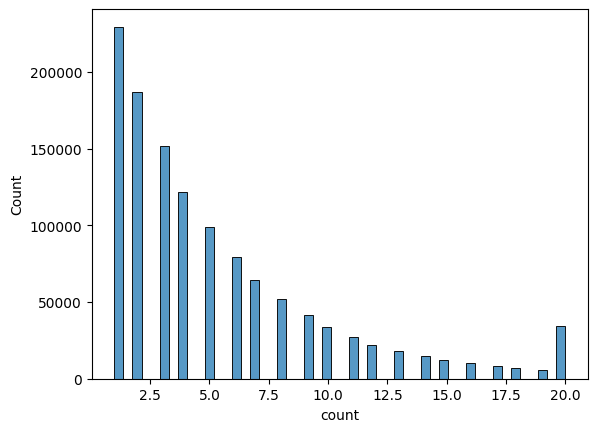

In [58]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(x = df_train_applprev_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

- It is likely that the number of previous applications is clipped at `20`.

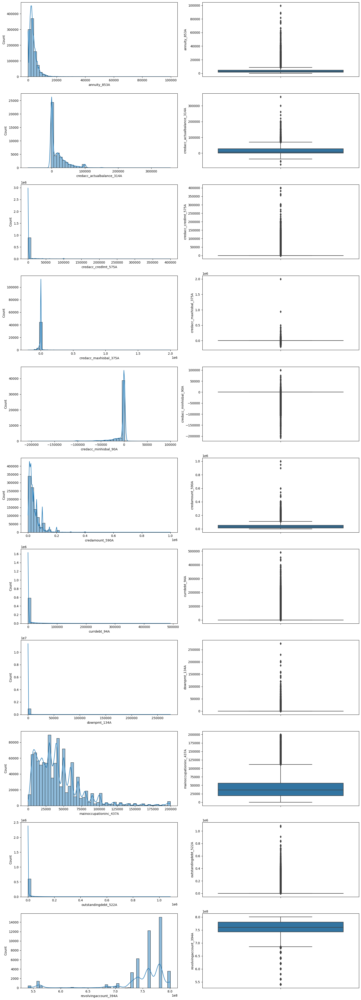

In [59]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_applprev_1, 'A')

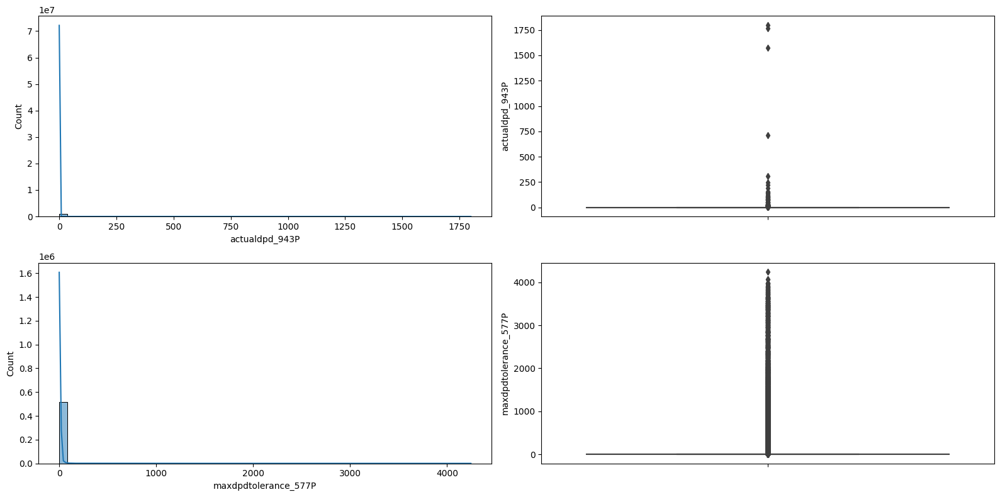

In [60]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_applprev_1, 'P')

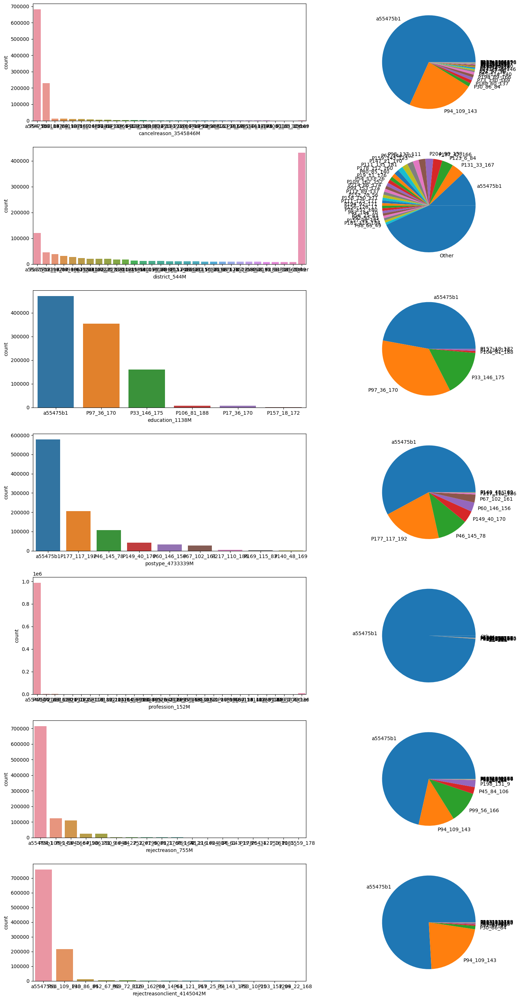

In [61]:
plot_categorical(df_train_applprev_1, 'M')

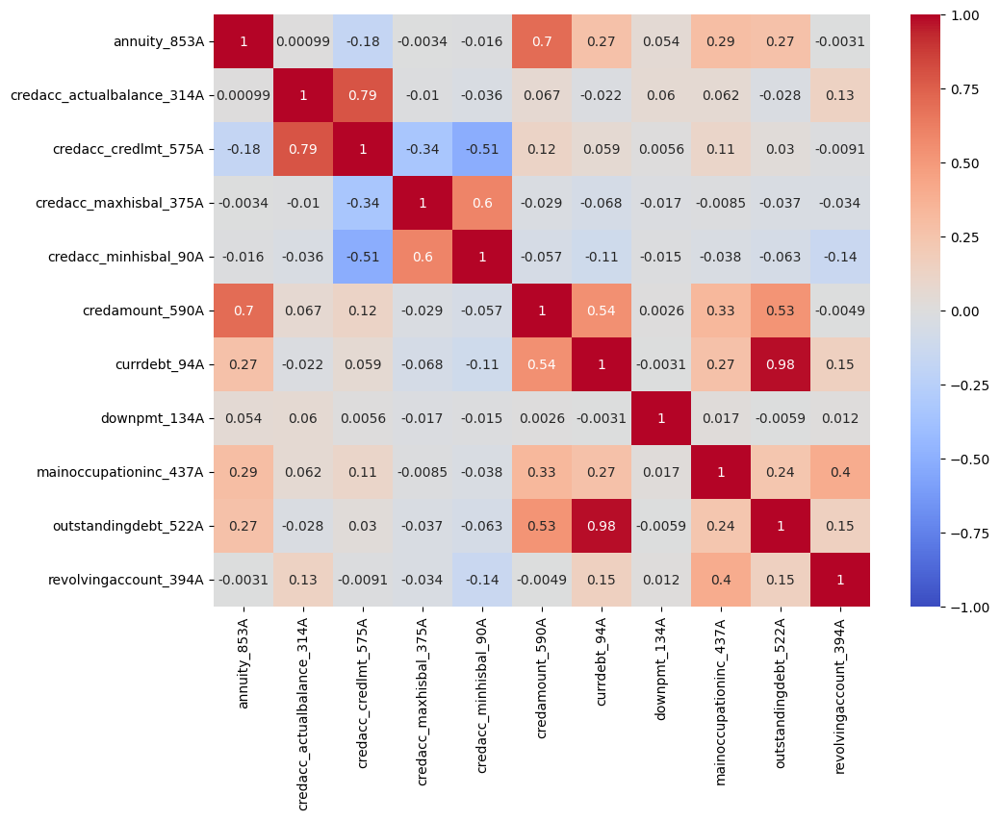

In [62]:
plot_corr(df_train_applprev_1, 'A')

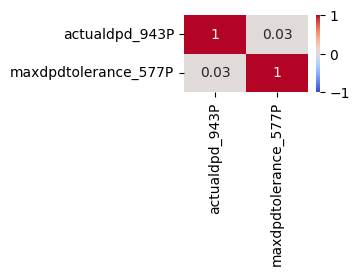

In [63]:
plot_corr(df_train_applprev_1, 'P')

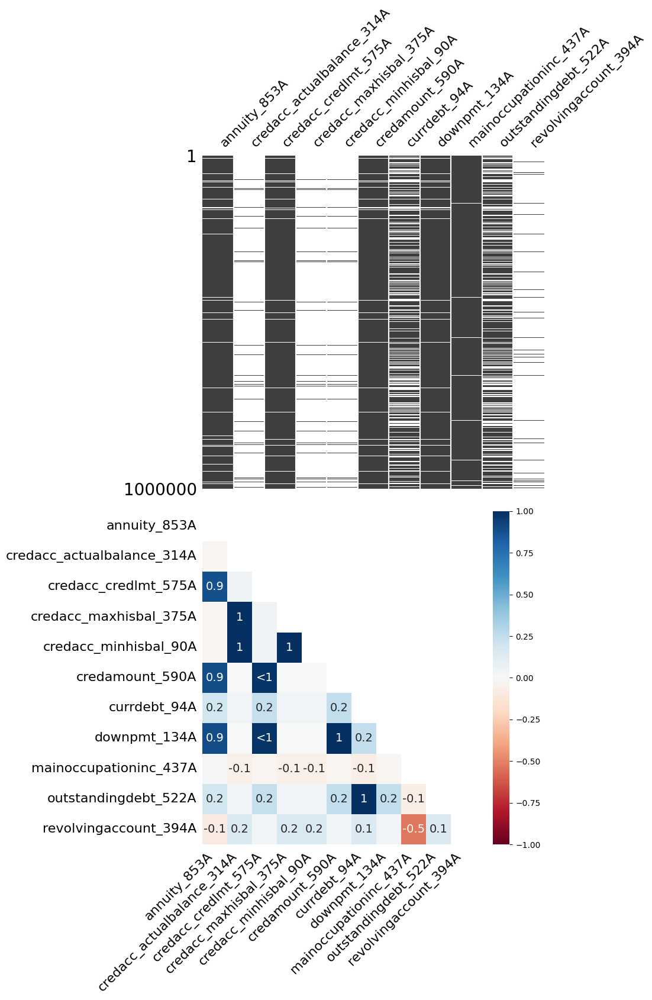

In [64]:
plot_null(df_train_applprev_1, 'A')

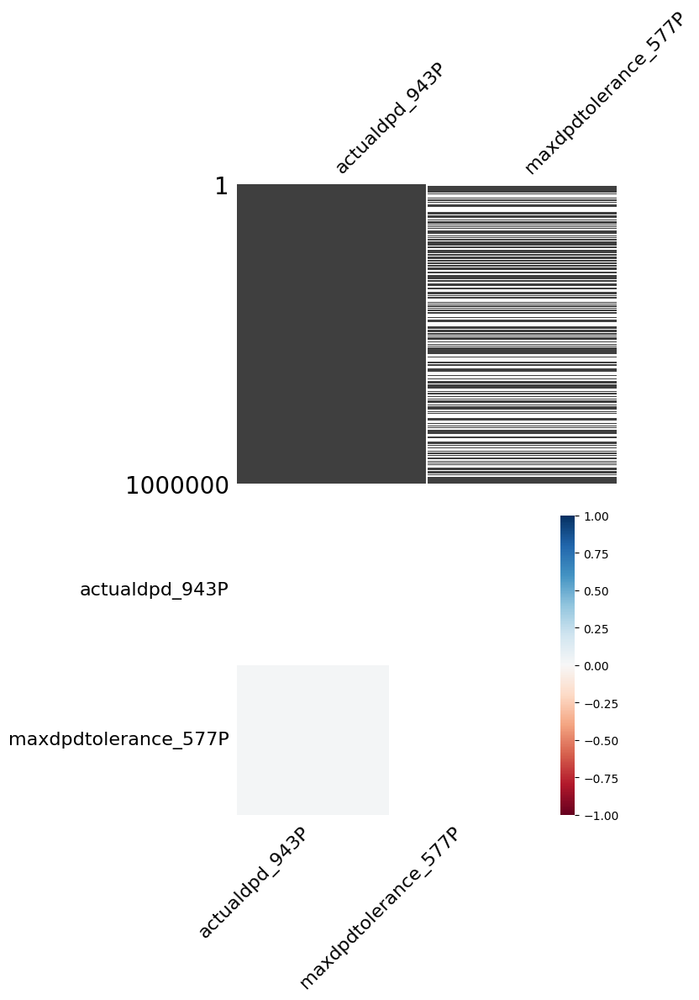

In [65]:
plot_null(df_train_applprev_1, 'P')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


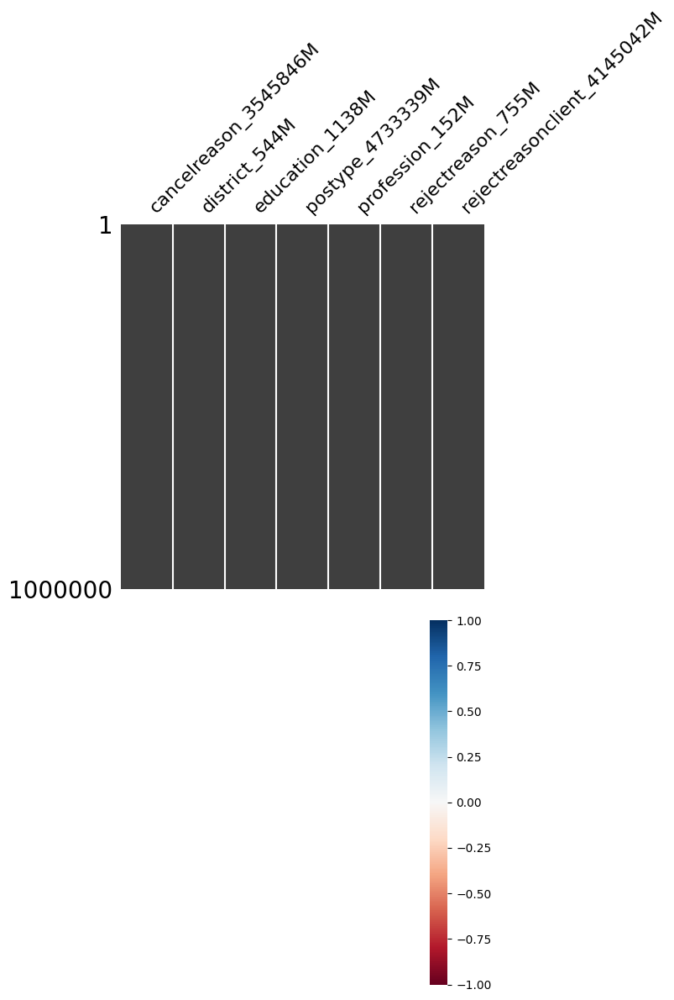

In [66]:
plot_null(df_train_applprev_1, 'M')

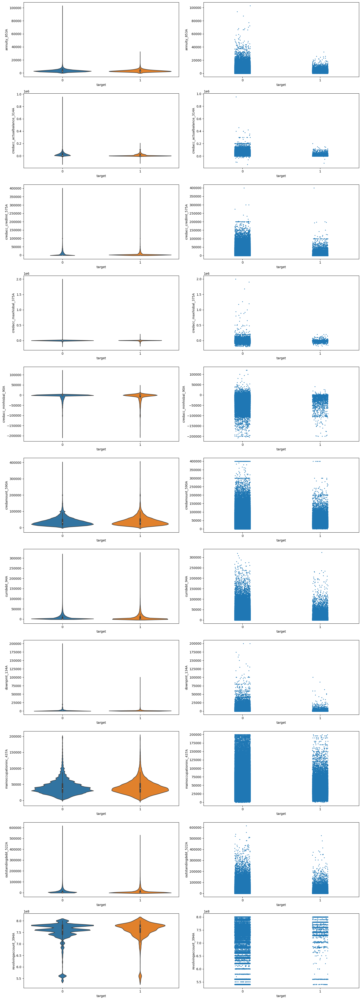

In [67]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_applprev_1.group_by('case_id').mean(), 'A')

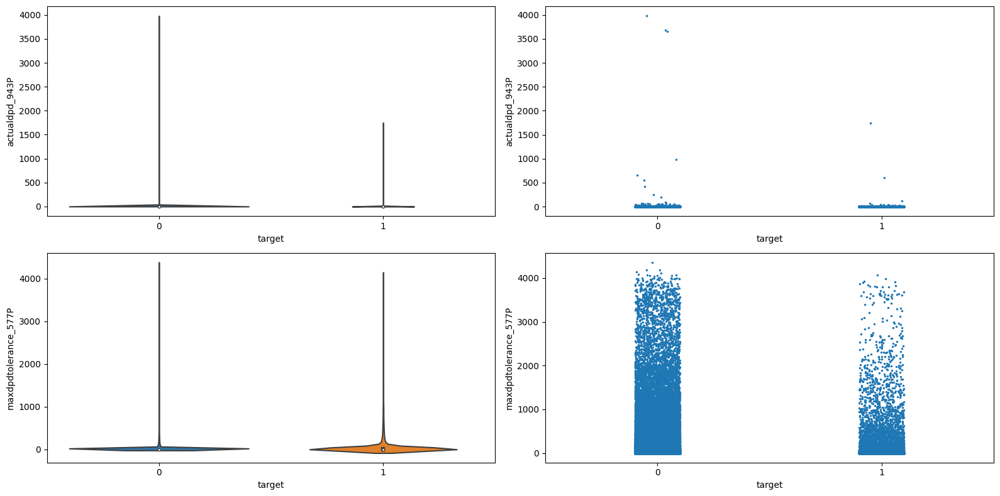

In [68]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_applprev_1.group_by('case_id').mean(), 'P')

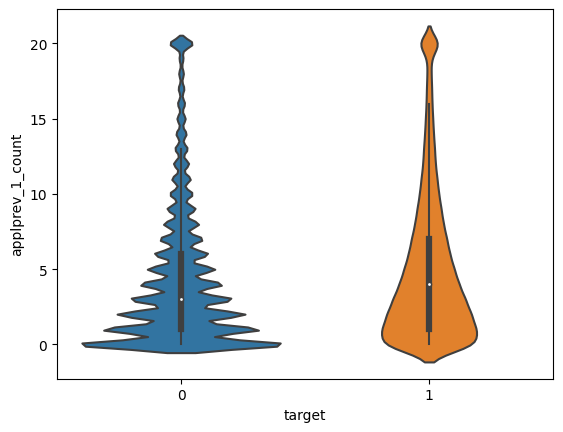

In [69]:
sns.violinplot(
    (
        df_train_base.lazy()
        .join(df_train_applprev_1.group_by('case_id').agg(pl.len().alias('applprev_1_count')), on = 'case_id', how = 'left')
        .select(pl.col('applprev_1_count').fill_null(0), 'target')
        .collect().to_pandas()
    ),
    x = 'target', y = 'applprev_1_count',
    orient = 'v', order = [0, 1],
);

In [70]:
with pl.Config() as cfg:
    cfg.set_tbl_rows(-1)
    for f in glob.iglob('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_applprev_1_*.parquet'):
        display(
            pl.scan_parquet(f)
            .join(df_train_base.lazy(), on = 'case_id', how = 'left')
            .select(pl.col('WEEK_NUM').unique())
            .collect()
        )

WEEK_NUM
i64
50
51
52
53
54
55
56
57
58


WEEK_NUM
i64
0
1
2
3
4
5
6
7
8


# other_1

In [71]:
df_train_other_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_other_1.parquet')

In [72]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_other_1.columns))

Variable,Description
str,str
"""case_id""",null
"""amtdebitincoming_4809443A""","""Incoming debit card transactions amount."""
"""amtdebitoutgoing_4809440A""","""Outgoing debit card transactions amount."""
"""amtdepositbalance_4809441A""","""Deposit balance of client."""
"""amtdepositincoming_4809444A""","""Amount of incoming deposits to client's account."""
"""amtdepositoutgoing_4809442A""","""Amount of outgoing deposits from client's account."""
"""num_group1""",null


In [73]:
display(df_train_other_1.head().collect())

case_id,amtdebitincoming_4809443A,amtdebitoutgoing_4809440A,amtdepositbalance_4809441A,amtdepositincoming_4809444A,amtdepositoutgoing_4809442A,num_group1
i64,f64,f64,f64,f64,f64,i64
43801,12466.601,12291.2,914.2,0.0,304.80002,0
43991,3333.4001,3273.4001,0.0,0.0,0.0,0
44001,10000.0,10000.0,0.0,0.0,0.0,0
44053,0.0,0.0,2586.4001,0.0,88.8,0
44130,63.8,60.8,0.0,0.0,0.0,0


In [74]:
display(df_train_other_1.collect().describe())

describe,case_id,amtdebitincoming_4809443A,amtdebitoutgoing_4809440A,amtdepositbalance_4809441A,amtdepositincoming_4809444A,amtdepositoutgoing_4809442A,num_group1
str,f64,f64,f64,f64,f64,f64,f64
"""count""",51109.0,51109.0,51109.0,51109.0,51109.0,51109.0,51109.0
"""null_count""",0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",1.4195e6,7552.901686,7462.384278,9967.412999,2949.3959,3586.875118,0.0
"""std""",924509.490925,34625.705832,35065.286854,89393.421442,41467.726075,48274.936439,0.0
"""min""",43801.0,0.0,0.0,-335718.0,0.0,0.0,0.0
"""25%""",242241.0,0.0,0.0,0.0,0.0,0.0,0.0
"""50%""",1.811468e6,0.0,0.0,0.0,0.0,1.8000001,0.0
"""75%""",1.916206e6,8000.0,7740.0,288.0,0.0,5.4,0.0
"""max""",2.703453e6,4.957852e6,5168004.5,4256314.5,4180150.5,4622917.5,0.0


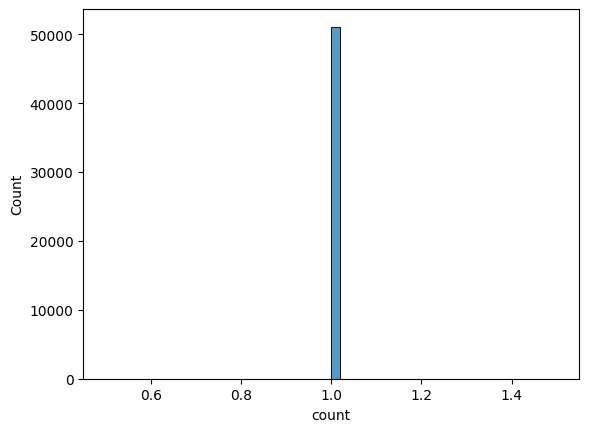

In [75]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_other_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

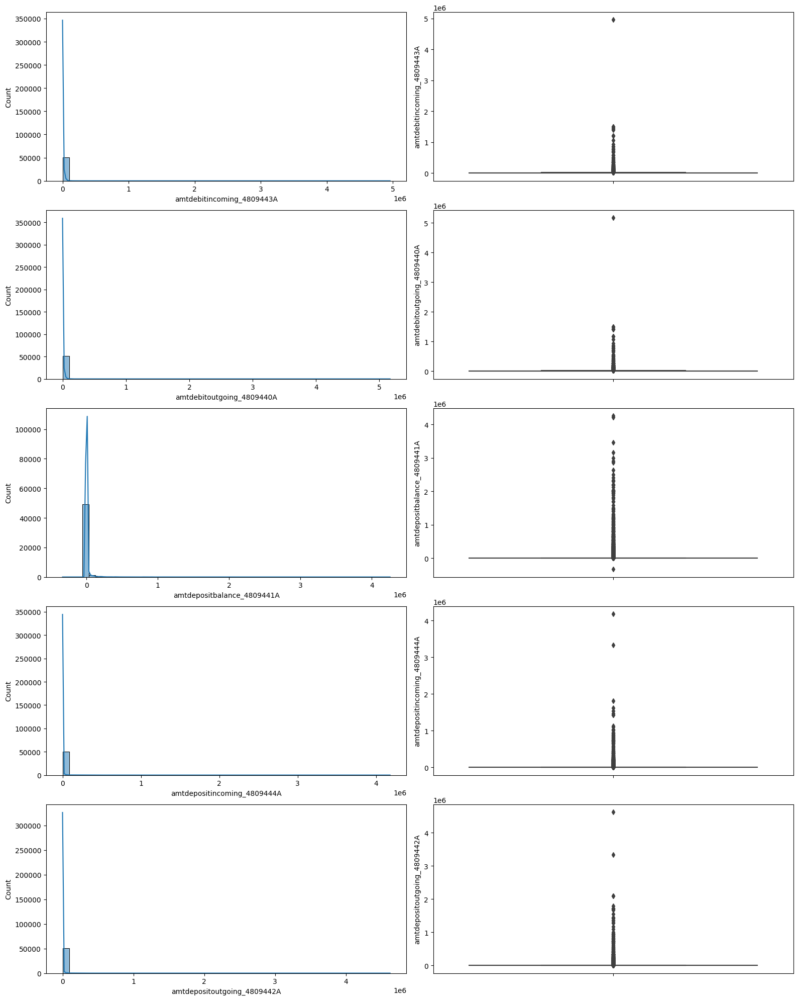

In [76]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_other_1, 'A')

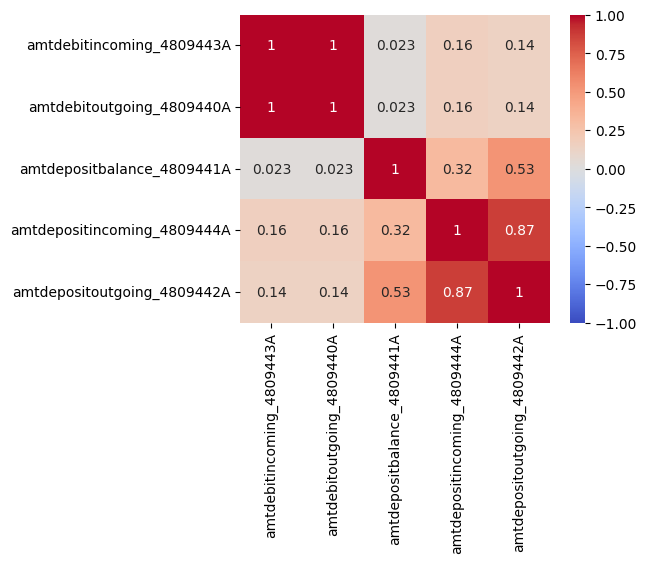

In [77]:
plot_corr(df_train_other_1, 'A')

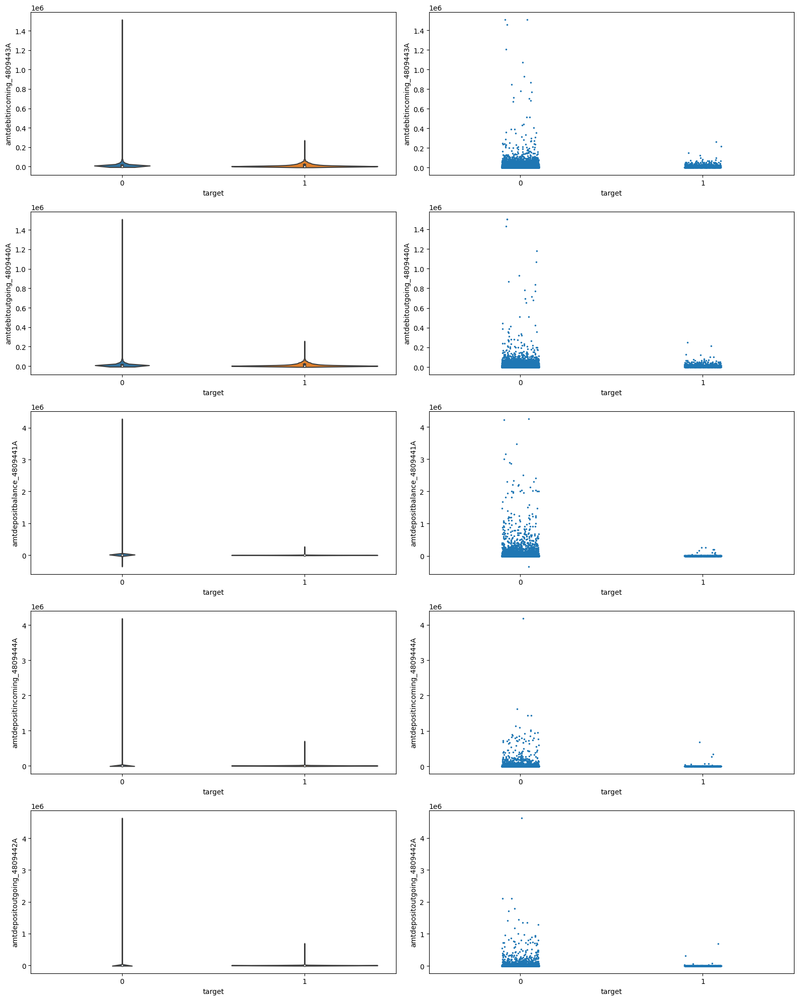

In [78]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_other_1.group_by('case_id').mean(), 'A')

# tax_registry_a_1

In [79]:
df_train_tax_registry_a_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_tax_registry_a_1.parquet')

In [80]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_tax_registry_a_1.columns))

Variable,Description
str,str
"""case_id""",null
"""amount_4527230A""","""Tax deductions amount tracked by the government registry."""
"""name_4527232M""","""Name of employer."""
"""num_group1""",null
"""recorddate_4527225D""","""Date of tax deduction record."""


In [81]:
display(df_train_tax_registry_a_1.head().collect())

case_id,amount_4527230A,name_4527232M,num_group1,recorddate_4527225D
i64,f64,str,i64,datetime[μs]
28631,711.0,"""f980a1ea""",3,2019-09-13 00:00:00
28631,1946.0,"""f980a1ea""",2,2019-09-13 00:00:00
28631,2600.0,"""f980a1ea""",1,2019-09-13 00:00:00
28631,3616.4001,"""f980a1ea""",0,2019-09-13 00:00:00
28632,400.0,"""5f9b74f5""",6,2019-09-13 00:00:00


In [82]:
display(df_train_tax_registry_a_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,amount_4527230A,num_group1,recorddate_4527225D
str,f64,f64,f64,str
"""count""",3.27577e6,3.27577e6,3.27577e6,"""3275770"""
"""null_count""",0.0,0.0,0.0,"""0"""
"""mean""",1.3414e6,2360.421376,4.095616,null
"""std""",649263.451335,3254.871236,3.933319,null
"""min""",28631.0,0.0,0.0,"""2019-09-13 00:…"
"""25%""",877291.0,850.0,1.0,null
"""50%""",1.571545e6,1400.0,3.0,null
"""75%""",1.728466e6,2778.0,5.0,null
"""max""",2.70229e6,87115.6,98.0,"""2020-10-19 00:…"


In [83]:
display(df_train_tax_registry_a_1.select(cs.by_dtype(pl.String).n_unique()).collect())

name_4527232M
u32
147037


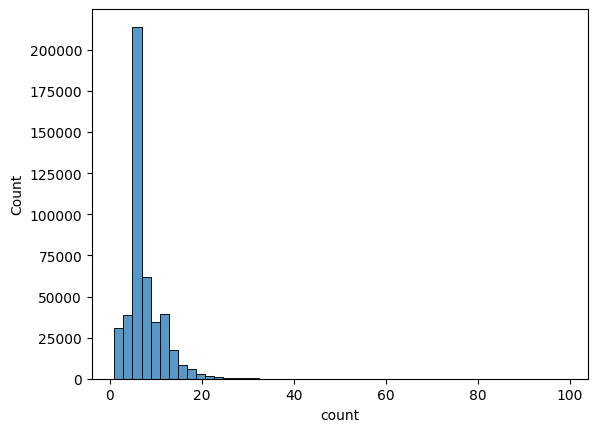

In [84]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_tax_registry_a_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

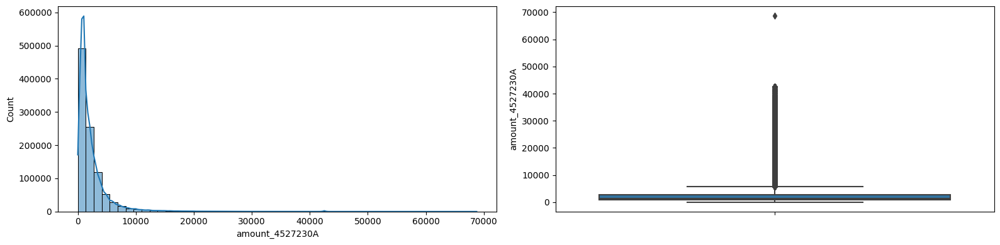

In [85]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_tax_registry_a_1, 'A')

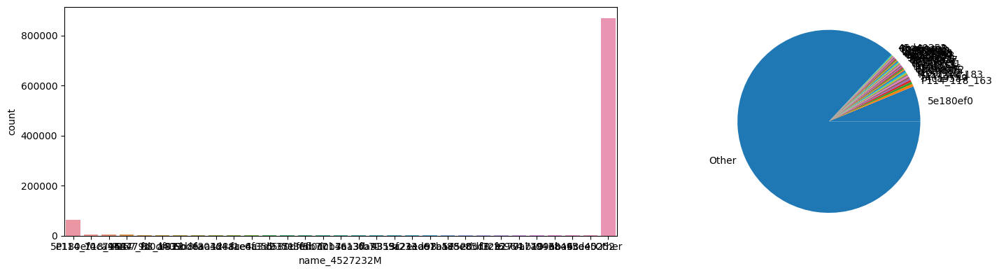

In [86]:
plot_categorical(df_train_tax_registry_a_1, 'M')

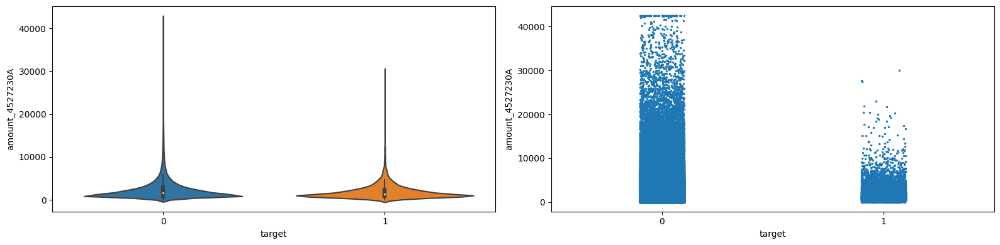

In [87]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_tax_registry_a_1.group_by('case_id').mean(), 'A')

# tax_registry_b_1

In [88]:
df_train_tax_registry_b_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_tax_registry_b_1.parquet')

In [89]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_tax_registry_b_1.columns))

Variable,Description
str,str
"""case_id""",null
"""amount_4917619A""","""Tax deductions amount tracked by the government registry."""
"""deductiondate_4917603D""","""Tax deduction date."""
"""name_4917606M""","""Name of employer."""
"""num_group1""",null


In [90]:
display(df_train_tax_registry_b_1.head().collect())

case_id,amount_4917619A,deductiondate_4917603D,name_4917606M,num_group1
i64,f64,datetime[μs],str,i64
49435,6885.0,2019-10-16 00:00:00,"""6b730375""",0
49435,6885.0,2019-10-16 00:00:00,"""6b730375""",1
49435,6885.0,2019-10-16 00:00:00,"""6b730375""",2
49435,6885.0,2019-10-16 00:00:00,"""6b730375""",3
49435,6885.0,2019-10-16 00:00:00,"""6b730375""",4


In [91]:
display(df_train_tax_registry_b_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,amount_4917619A,deductiondate_4917603D,num_group1
str,f64,f64,str,f64
"""count""",1.107933e6,1.107933e6,"""1107933""",1.107933e6
"""null_count""",0.0,0.0,"""0""",0.0
"""mean""",1.4699e6,20104.965724,null,4.14472
"""std""",705344.777052,25201.745135,null,4.108048
"""min""",49435.0,0.0,"""2019-09-27 00:…",0.0
"""25%""",997668.0,6885.0,null,1.0
"""50%""",1.854645e6,13130.2,null,3.0
"""75%""",1.907416e6,24300.0,null,5.0
"""max""",2.703452e6,344250.0,"""2020-10-16 00:…",100.0


In [92]:
display(df_train_tax_registry_b_1.select(cs.by_dtype(pl.String).n_unique()).collect())

name_4917606M
u32
55857


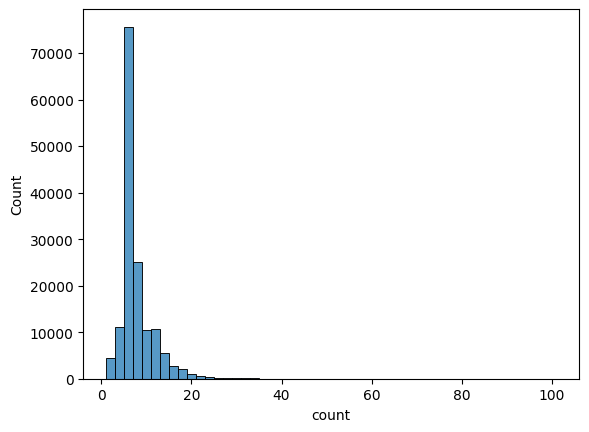

In [93]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_tax_registry_b_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

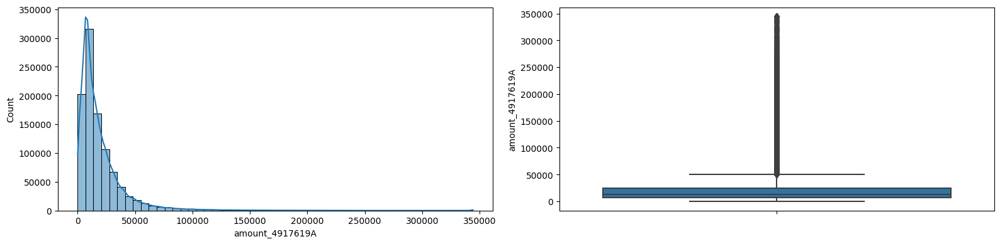

In [94]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_tax_registry_b_1, 'A')

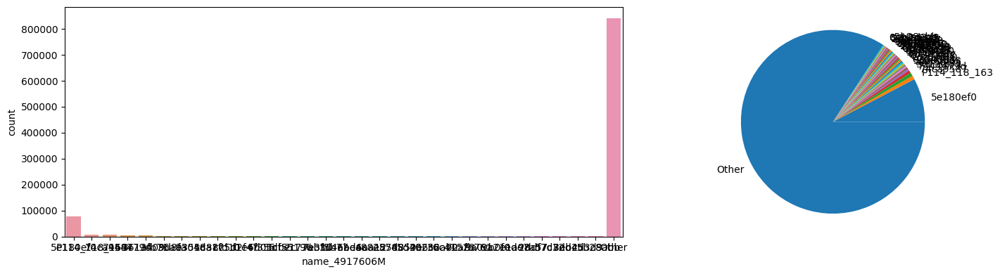

In [95]:
plot_categorical(df_train_tax_registry_b_1, 'M')

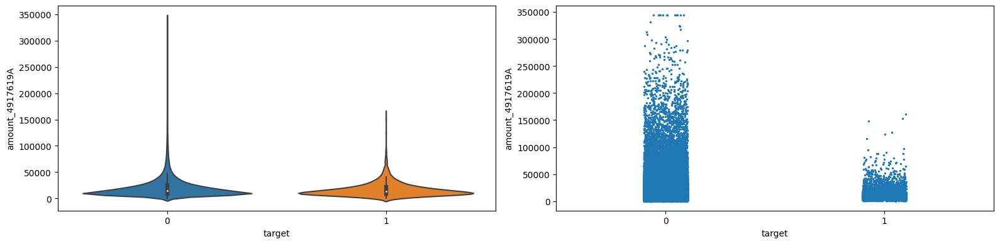

In [96]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_tax_registry_b_1.group_by('case_id').mean(), 'A')

# tax_registry_c_1

In [97]:
df_train_tax_registry_c_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_tax_registry_c_1.parquet')

In [98]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_tax_registry_c_1.columns))

Variable,Description
str,str
"""case_id""",null
"""employername_160M""","""Employer's name."""
"""num_group1""",null
"""pmtamount_36A""","""Tax deductions amount for credit bureau payments."""
"""processingdate_168D""","""Date when the tax deduction is processed."""


In [99]:
display(df_train_tax_registry_c_1.head().collect())

case_id,employername_160M,num_group1,pmtamount_36A,processingdate_168D
i64,str,i64,f64,datetime[μs]
357,"""c91b12ff""",0,1200.0,2019-01-04 00:00:00
357,"""c91b12ff""",1,1200.0,2018-11-28 00:00:00
357,"""c91b12ff""",2,972.8,2018-11-01 00:00:00
357,"""c91b12ff""",3,628.60004,2018-10-08 00:00:00
357,"""c91b12ff""",4,1200.0,2018-09-10 00:00:00


In [100]:
display(df_train_tax_registry_c_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,num_group1,pmtamount_36A,processingdate_168D
str,f64,f64,f64,str
"""count""",3.3438e6,3.3438e6,3.3438e6,"""3343800"""
"""null_count""",0.0,0.0,0.0,"""0"""
"""mean""",1.1613e6,3.893117,2260.537387,null
"""std""",657994.955912,3.736779,3161.294121,null
"""min""",357.0,0.0,0.0,"""2018-07-11 00:…"
"""25%""",700623.0,1.0,745.46,null
"""50%""",1.301411e6,3.0,1365.454,null
"""75%""",1.471673e6,5.0,2632.2,null
"""max""",2.629815e6,120.0,87115.6,"""2019-10-22 00:…"


In [101]:
display(df_train_tax_registry_c_1.select(cs.by_dtype(pl.String).n_unique()).collect())

employername_160M
u32
152835


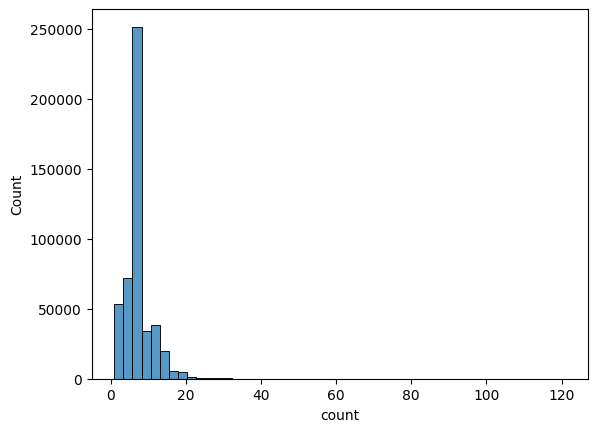

In [102]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_tax_registry_c_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

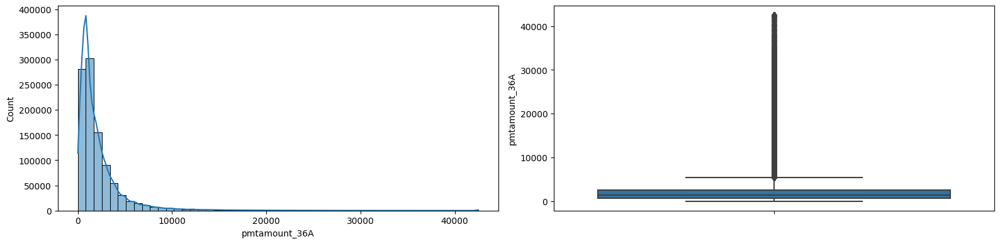

In [103]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_tax_registry_c_1, 'A')

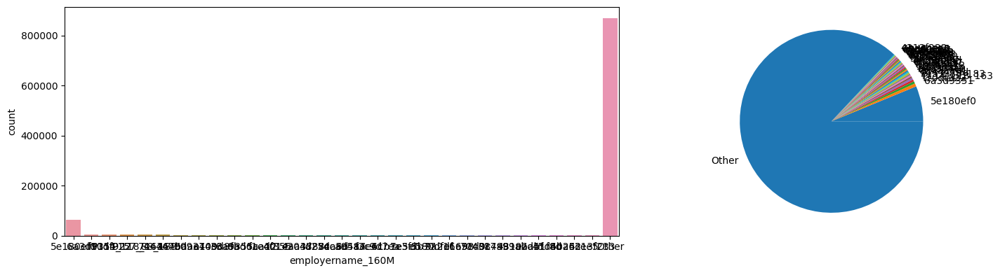

In [104]:
plot_categorical(df_train_tax_registry_c_1, 'M')

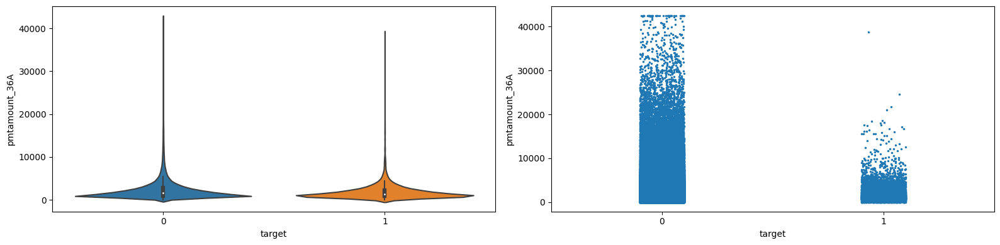

In [105]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_tax_registry_c_1.group_by('case_id').mean(), 'A')

- All of `tax_registry_[a/b/c]_1` seem to have essentially the same columns but with different names.
- Names are high-cardinality categorical variables.
  - Single majority and many minorities.

# credit_bureau_a_1

In [106]:
df_train_credit_bureau_a_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_credit_bureau_a_1_*.parquet')

In [107]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    cfg.set_tbl_rows(-1)
    display(get_feature_definitions(df_train_credit_bureau_a_1.columns))

Variable,Description
str,str
"""case_id""",null
"""annualeffectiverate_199L""","""Interest rate of the closed contracts."""
"""annualeffectiverate_63L""","""Interest rate for the active contracts."""
"""classificationofcontr_13M""","""Classificiation of the active contract."""
"""classificationofcontr_400M""","""Classificiation of the closed contract."""
"""contractst_545M""","""Contract status."""
"""contractst_964M""","""Contract status of terminated credit contract."""
"""contractsum_5085717L""","""Sum of other contract values."""
"""credlmt_230A""","""Credit limit of the closed credit contracts from credit bureau."""


In [108]:
with pl.Config() as cfg:
    cfg.set_tbl_cols(-1)
    display(df_train_credit_bureau_a_1.head().collect())

case_id,annualeffectiverate_199L,annualeffectiverate_63L,classificationofcontr_13M,classificationofcontr_400M,contractst_545M,contractst_964M,contractsum_5085717L,credlmt_230A,credlmt_935A,dateofcredend_289D,dateofcredend_353D,dateofcredstart_181D,dateofcredstart_739D,dateofrealrepmt_138D,debtoutstand_525A,debtoverdue_47A,description_351M,dpdmax_139P,dpdmax_757P,dpdmaxdatemonth_442T,dpdmaxdatemonth_89T,dpdmaxdateyear_596T,dpdmaxdateyear_896T,financialinstitution_382M,financialinstitution_591M,instlamount_768A,instlamount_852A,interestrate_508L,lastupdate_1112D,lastupdate_388D,monthlyinstlamount_332A,monthlyinstlamount_674A,nominalrate_281L,nominalrate_498L,num_group1,numberofcontrsvalue_258L,numberofcontrsvalue_358L,numberofinstls_229L,numberofinstls_320L,numberofoutstandinstls_520L,numberofoutstandinstls_59L,numberofoverdueinstlmax_1039L,numberofoverdueinstlmax_1151L,numberofoverdueinstlmaxdat_148D,numberofoverdueinstlmaxdat_641D,numberofoverdueinstls_725L,numberofoverdueinstls_834L,outstandingamount_354A,outstandingamount_362A,overdueamount_31A,overdueamount_659A,overdueamountmax2_14A,overdueamountmax2_398A,overdueamountmax2date_1002D,overdueamountmax2date_1142D,overdueamountmax_155A,overdueamountmax_35A,overdueamountmaxdatemonth_284T,overdueamountmaxdatemonth_365T,overdueamountmaxdateyear_2T,overdueamountmaxdateyear_994T,periodicityofpmts_1102L,periodicityofpmts_837L,prolongationcount_1120L,prolongationcount_599L,purposeofcred_426M,purposeofcred_874M,refreshdate_3813885D,residualamount_488A,residualamount_856A,subjectrole_182M,subjectrole_93M,totalamount_6A,totalamount_996A,totaldebtoverduevalue_178A,totaldebtoverduevalue_718A,totaloutstanddebtvalue_39A,totaloutstanddebtvalue_668A
i64,f64,f64,str,str,str,str,f64,f64,f64,datetime[μs],datetime[μs],datetime[μs],datetime[μs],datetime[μs],f64,f64,str,f64,f64,f64,f64,f64,f64,str,str,f64,f64,f64,datetime[μs],datetime[μs],f64,f64,f64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,datetime[μs],datetime[μs],f64,f64,f64,f64,f64,f64,f64,f64,datetime[μs],datetime[μs],f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,datetime[μs],f64,f64,str,str,f64,f64,f64,f64,f64,f64
388,null,null,"""ea6782cc""","""a55475b1""","""7241344e""","""a55475b1""",null,null,135806.0,2020-08-06 00:00:00,null,null,2018-08-06 00:00:00,null,null,null,"""a55475b1""",0.0,null,null,8.0,2018.0,null,"""a55475b1""","""P204_66_73""",8742.8,null,null,2019-01-11 00:00:00,null,8742.8,null,null,null,1,null,null,null,null,null,null,0.0,null,null,null,0.0,null,null,null,null,0.0,0.0,null,null,null,0.0,null,null,8.0,2018.0,null,null,null,null,null,"""60c73645""","""a55475b1""",null,null,114325.805,"""a55475b1""","""a55475b1""",null,null,null,null,null,null
388,null,null,"""4408ff0f""","""a55475b1""","""7241344e""","""a55475b1""",null,null,null,2023-06-20 00:00:00,null,null,2018-06-20 00:00:00,null,374419.5,0.0,"""a55475b1""",0.0,null,null,7.0,2018.0,null,"""a55475b1""","""55b002a9""",null,null,null,2019-01-24 00:00:00,null,7811.4463,null,null,null,0,2.0,1.0,null,60.0,null,54.0,0.0,null,null,null,0.0,null,null,260093.7,null,0.0,0.0,null,null,null,0.0,null,null,7.0,2018.0,null,null,30.0,null,null,"""96a8fdfe""","""a55475b1""",null,null,null,"""ab3c25cf""","""ab3c25cf""",null,268897.62,0.0,0.0,374419.5,0.0
388,null,null,"""a55475b1""","""a55475b1""","""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,null,null,null,"""a55475b1""",null,null,null,null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,null,null,2,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,"""a55475b1""","""a55475b1""",2019-01-28 00:00:00,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null
388,null,null,"""a55475b1""","""a55475b1""","""a55475b1""","""a55475b1""",null,null,null,null,null,null,null,null,null,null,"""a55475b1""",null,null,null,null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,nu

In [109]:
with pl.Config() as cfg:
    cfg.set_tbl_cols(-1)
    display(df_train_credit_bureau_a_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,annualeffectiverate_199L,annualeffectiverate_63L,contractsum_5085717L,credlmt_230A,credlmt_935A,dateofcredend_289D,dateofcredend_353D,dateofcredstart_181D,dateofcredstart_739D,dateofrealrepmt_138D,debtoutstand_525A,debtoverdue_47A,dpdmax_139P,dpdmax_757P,dpdmaxdatemonth_442T,dpdmaxdatemonth_89T,dpdmaxdateyear_596T,dpdmaxdateyear_896T,instlamount_768A,instlamount_852A,interestrate_508L,lastupdate_1112D,lastupdate_388D,monthlyinstlamount_332A,monthlyinstlamount_674A,nominalrate_281L,nominalrate_498L,num_group1,numberofcontrsvalue_258L,numberofcontrsvalue_358L,numberofinstls_229L,numberofinstls_320L,numberofoutstandinstls_520L,numberofoutstandinstls_59L,numberofoverdueinstlmax_1039L,numberofoverdueinstlmax_1151L,numberofoverdueinstlmaxdat_148D,numberofoverdueinstlmaxdat_641D,numberofoverdueinstls_725L,numberofoverdueinstls_834L,outstandingamount_354A,outstandingamount_362A,overdueamount_31A,overdueamount_659A,overdueamountmax2_14A,overdueamountmax2_398A,overdueamountmax2date_1002D,overdueamountmax2date_1142D,overdueamountmax_155A,overdueamountmax_35A,overdueamountmaxdatemonth_284T,overdueamountmaxdatemonth_365T,overdueamountmaxdateyear_2T,overdueamountmaxdateyear_994T,periodicityofpmts_1102L,periodicityofpmts_837L,prolongationcount_1120L,prolongationcount_599L,refreshdate_3813885D,residualamount_488A,residualamount_856A,totalamount_6A,totalamount_996A,totaldebtoverduevalue_178A,totaldebtoverduevalue_718A,totaloutstanddebtvalue_39A,totaloutstanddebtvalue_668A
str,f64,f64,f64,f64,f64,f64,str,str,str,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,f64,f64,f64,f64,f64,f64,f64,f64
"""count""",1.5940537e7,726633.0,311243.0,319331.0,896422.0,1.254985e6,"""2659276""","""6752483""","""6752497""","""2659276""","""6714591""",1.385837e6,1.385837e6,2.644036e6,6.526895e6,6.526895e6,2.644036e6,2.644036e6,6.526895e6,1.239194e6,594166.0,65820.0,"""2659276""","""6752296""",2.642642e6,6.292167e6,979557.0,2.309627e6,1.5940537e7,1.305003e6,1.275542e6,5.853138e6,1.403865e6,5.857413e6,1.403822e6,2.659276e6,6.752497e6,"""2024456""","""679882""",2.64379e6,6.74359e6,5.859245e6,1.404228e6,6.745179e6,2.6438e6,2.659276e6,6.752497e6,"""2004700""","""685761""",2.659275e6,6.535045e6,6.535045e6,2.659275e6,2.659275e6,6.535045e6,5.256183e6,1.367495e6,481469.0,38948.0,"""11084697""",887792.0,1.239291e6,5.860881e6,1.404291e6,1.305003e6,1.275542e6,1.305003e6,1.275542e6
"""null_count""",0.0,1.5213904e7,1.5629294e7,1.5621206e7,1.5044115e7,1.4685552e7,"""13281261""","""9188054""","""9188040""","""13281261""","""9225946""",1.45547e7,1.45547e7,1.3296501e7,9.413642e6,9.413642e6,1.3296501e7,1.3296501e7,9.413642e6,1.4701343e7,1.5346371e7,1.5874717e7,"""13281261""","""9188241""",1.3297895e7,9.64837e6,1.496098e7,1.363091e7,0.0,1.4635534e7,1.4664995e7,1.0087399e7,1.4536672e7,1.0083124e7,1.4536715e7,1.3281261e7,9.18804e6,"""13916081""","""15260655""",1.3296747e7,9.196947e6,1.0081292e7,1.4536309e7,9.195358e6,1.3296737e7,1.3281261e7,9.18804e6,"""13935837""","""15254776""",1.3281262e7,9.405492e6,9.405492e6,1.3281262e7,1.3281262e7,9.405492e6,1.0684354e7,1.4573042e7,1.5459068e7,1.5901589e7,"""4855840""",1.5052745e7,1.4701246e7,1.0079656e7,1.4536246e7,1.4635534e7,1.4664995e7,1.4635534e7,1.4664995e7
"""mean""",1.3278e6,1069.1377,155.654591,316107.67957,35122.842082,117062.67106,null,null,null,null,null,202238.035335,2589.099937,12.383255,46.503038,6.546966,6.635924,2018.482255,2014.684199,3565.515559,661.262046,85.923163,null,null,5717.550841,7096.223571,41.782558,105.402893,6.324594,2.025708,6.348578,11.897198,31.389505,0.538629,21.190321,16.002861,53.49102,null,null,7.960372,0.047534,4.944283,166437.099188,16.549824,1704.816573,4144.232719,6011.841028,null,null,3389.167515,5009.504486,6.57743,6.651573,2018.471409,2014.634267,30.107946,30.334535,0.587323,0.930369,null,1.225262,38036.286751,79554.822063,217838.58156

- The max of `dpdmax_757P` is `657458 days ~ 1801 years`!?!?

In [110]:
with pl.Config() as cfg:
    cfg.set_tbl_cols(-1)
    display(df_train_credit_bureau_a_1.select(cs.by_dtype(pl.String).n_unique()).collect())

classificationofcontr_13M,classificationofcontr_400M,contractst_545M,contractst_964M,description_351M,financialinstitution_382M,financialinstitution_591M,purposeofcred_426M,purposeofcred_874M,subjectrole_182M,subjectrole_93M
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
11,389,51,295,12,390,238,19,24,9,9


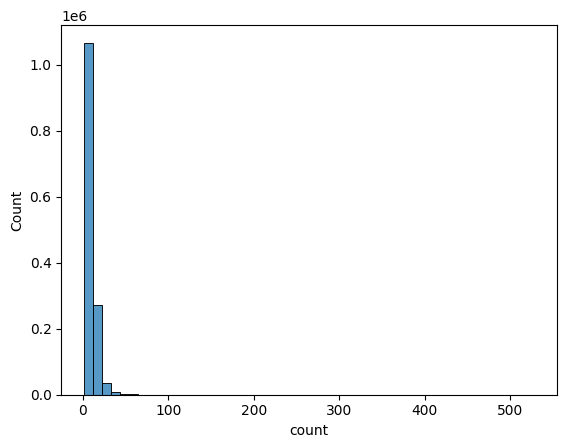

In [111]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_credit_bureau_a_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

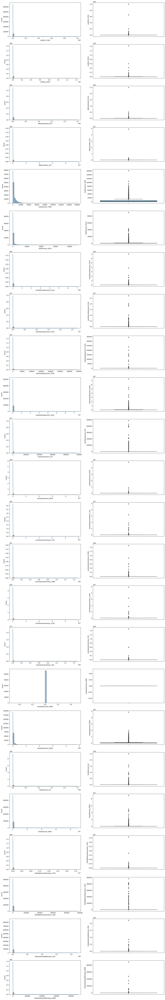

In [112]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_a_1, 'A')

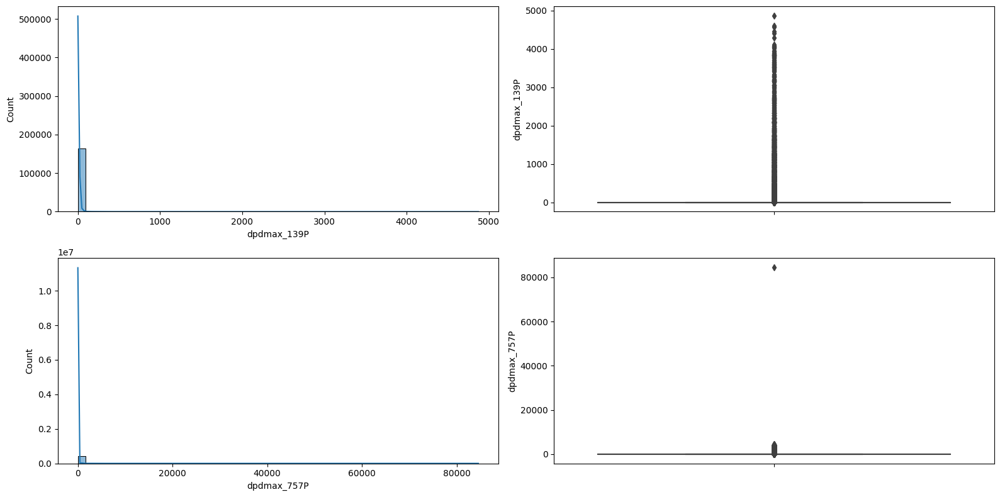

In [113]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_a_1, 'P')

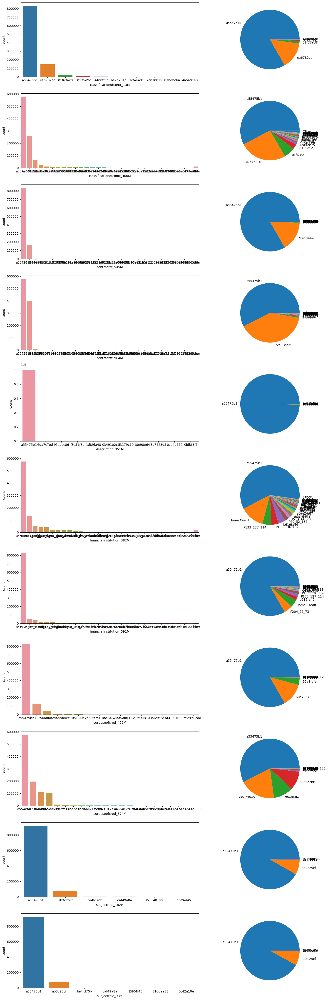

In [114]:
plot_categorical(df_train_credit_bureau_a_1, 'M')

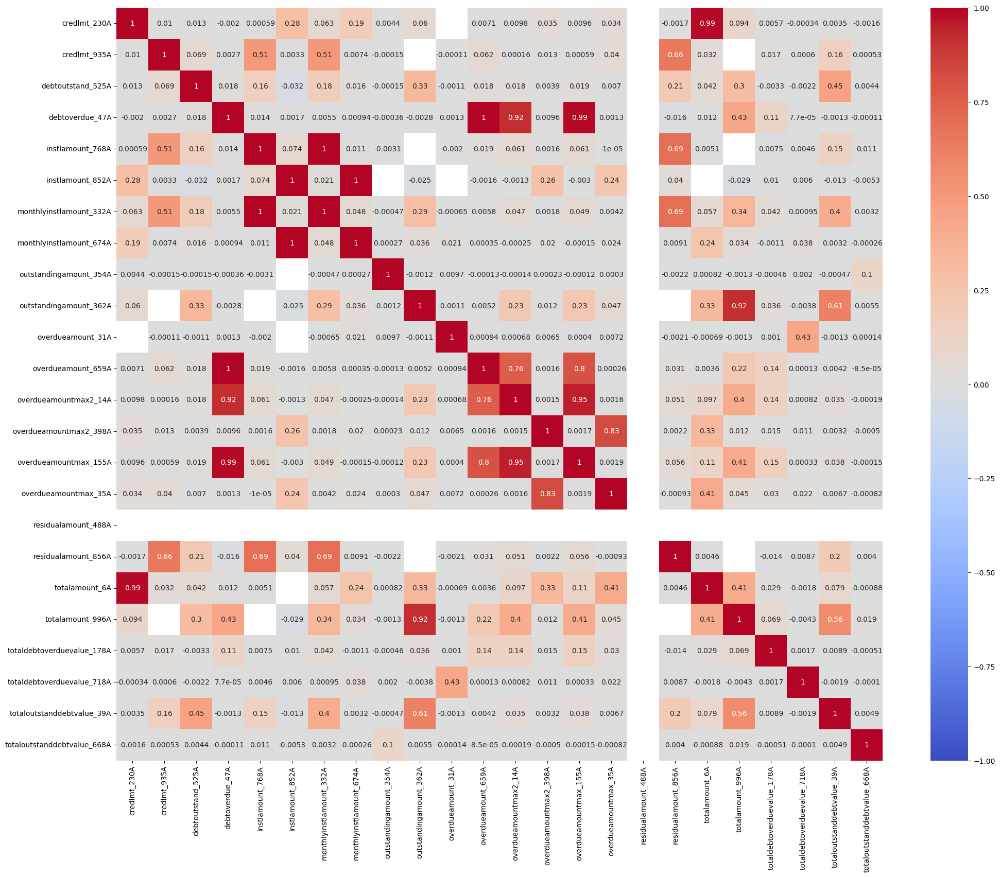

In [115]:
plot_corr(df_train_credit_bureau_a_1, 'A')

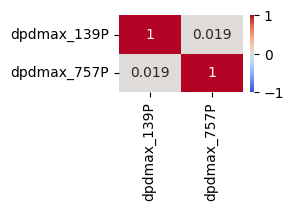

In [116]:
plot_corr(df_train_credit_bureau_a_1, 'P')

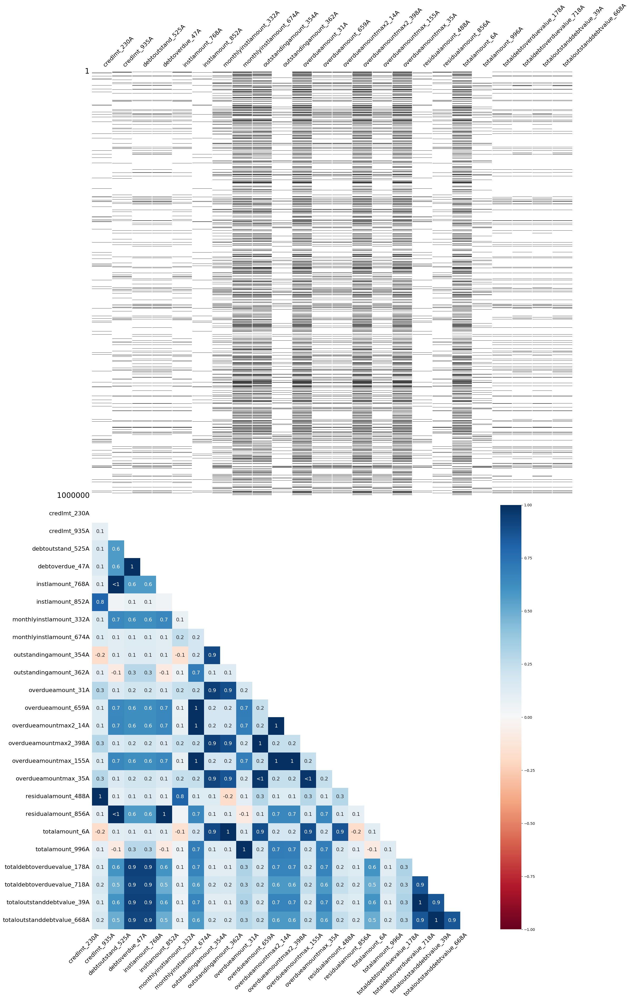

In [117]:
plot_null(df_train_credit_bureau_a_1, 'A')

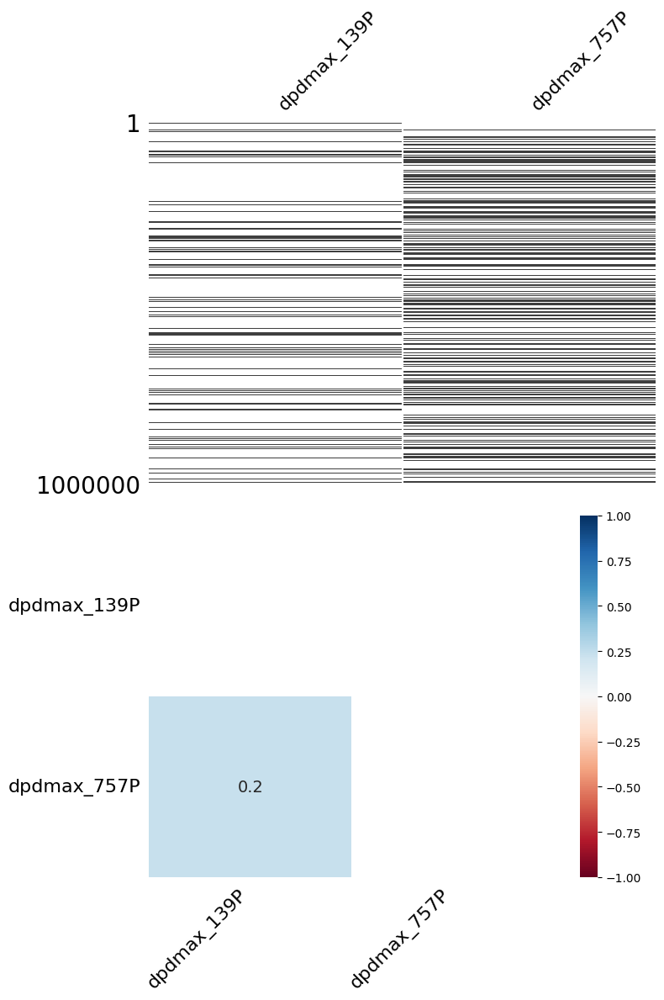

In [118]:
plot_null(df_train_credit_bureau_a_1, 'P')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


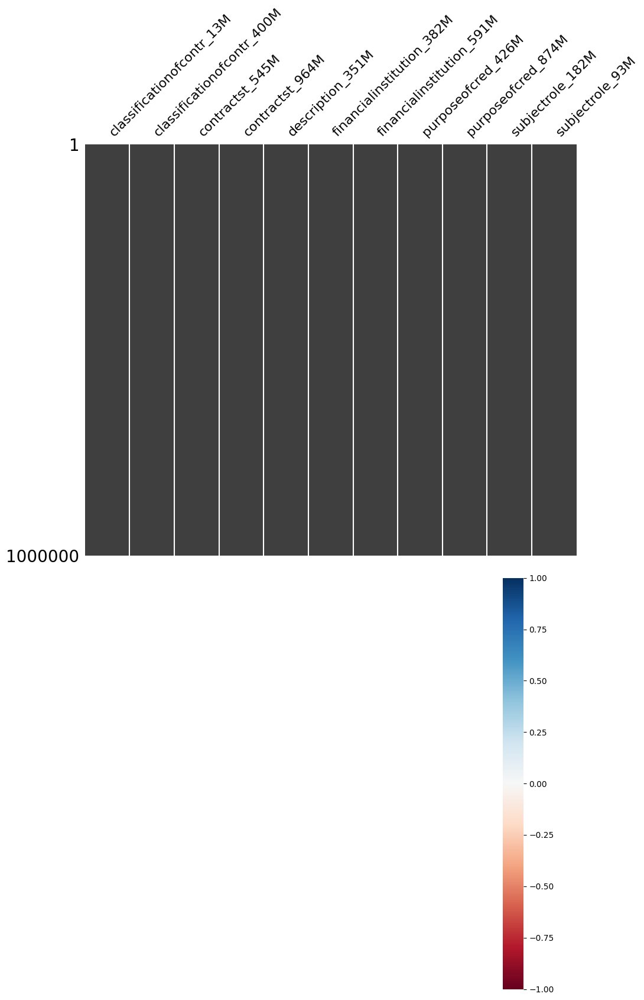

In [119]:
plot_null(df_train_credit_bureau_a_1, 'M')

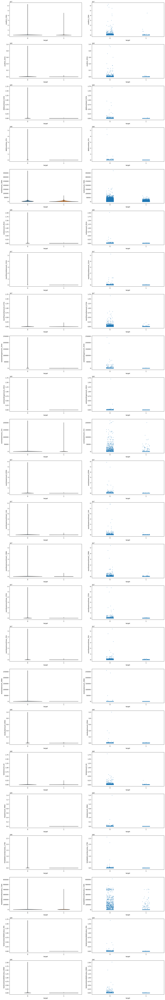

In [120]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_a_1.group_by('case_id').mean(), 'A')

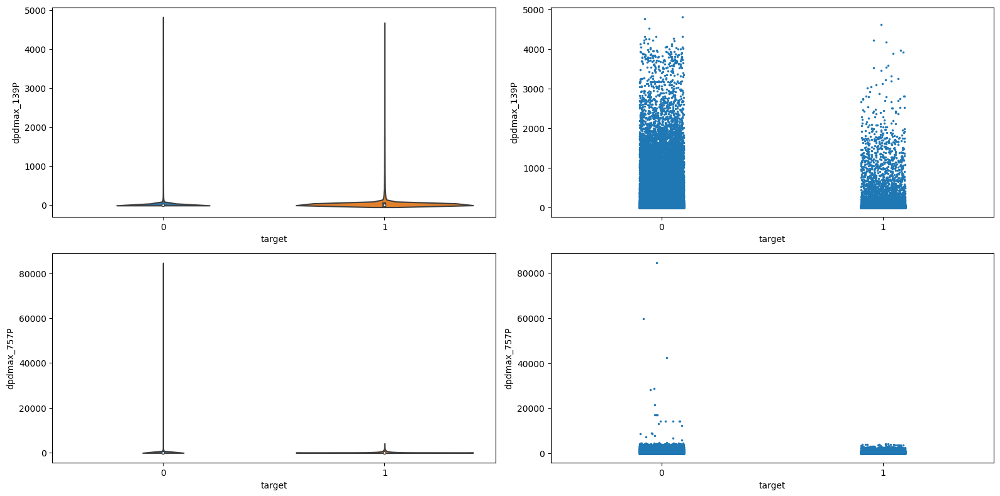

In [121]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_a_1.group_by('case_id').mean(), 'P')

In [122]:
with pl.Config() as cfg:
    cfg.set_tbl_rows(-1)
    for f in glob.iglob('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_credit_bureau_a_1_*.parquet'):
        display(
            pl.scan_parquet(f)
            .join(df_train_base.lazy(), on = 'case_id', how = 'left')
            .select(pl.col('WEEK_NUM').unique())
            .collect()
        )

WEEK_NUM
i64
75
76
77
78
79
80
81
82
83


WEEK_NUM
i64
50
51
52
53
54
55
56
57
58


WEEK_NUM
i64
0
1
2
3
4
5
6
7
8


WEEK_NUM
i64
25
26
27
28
29
30
31
32
33


# credit_bureau_b_1

In [123]:
df_train_credit_bureau_b_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_credit_bureau_b_1.parquet')

In [124]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    cfg.set_tbl_rows(-1)
    display(get_feature_definitions(df_train_credit_bureau_b_1.columns))

Variable,Description
str,str
"""case_id""",null
"""amount_1115A""","""Credit amount of the active contract provided by the credit bureau."""
"""classificationofcontr_1114M""","""Classificiation of the active contract."""
"""contractdate_551D""","""Contract date of the active contract"""
"""contractmaturitydate_151D""","""End date of active contract."""
"""contractst_516M""","""Contract status."""
"""contracttype_653M""","""Contract Type"""
"""credlmt_1052A""","""Credit limit of an active loan."""
"""credlmt_228A""","""Credit limit for closed loans."""


In [125]:
display(df_train_credit_bureau_b_1.head().collect())

case_id,amount_1115A,classificationofcontr_1114M,contractdate_551D,contractmaturitydate_151D,contractst_516M,contracttype_653M,credlmt_1052A,credlmt_228A,credlmt_3940954A,credor_3940957M,credquantity_1099L,credquantity_984L,debtpastduevalue_732A,debtvalue_227A,dpd_550P,dpd_733P,dpdmax_851P,dpdmaxdatemonth_804T,dpdmaxdateyear_742T,installmentamount_644A,installmentamount_833A,instlamount_892A,interesteffectiverate_369L,interestrateyearly_538L,lastupdate_260D,maxdebtpduevalodued_3940955A,num_group1,numberofinstls_810L,overdueamountmax_950A,overdueamountmaxdatemonth_494T,overdueamountmaxdateyear_432T,periodicityofpmts_997L,periodicityofpmts_997M,pmtdaysoverdue_1135P,pmtmethod_731M,pmtnumpending_403L,purposeofcred_722M,residualamount_1093A,residualamount_127A,residualamount_3940956A,subjectrole_326M,subjectrole_43M,totalamount_503A,totalamount_881A
i64,f64,str,datetime[μs],datetime[μs],str,str,f64,f64,f64,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,datetime[μs],f64,i64,f64,f64,f64,f64,str,str,f64,str,f64,str,f64,f64,f64,str,str,f64,f64
467,78000.0,"""ea6782cc""",2016-10-25 00:00:00,2019-10-25 00:00:00,"""7241344e""","""4257cbed""",null,null,null,"""c5a72b57""",null,null,0.0,26571.969,null,null,0.0,11.0,2016.0,null,null,2898.76,null,null,2019-01-10 00:00:00,0.0,2,36.0,0.0,11.0,2016.0,null,"""a0b598e4""",0.0,"""e914c86c""",10.0,"""96a8fdfe""",null,null,null,"""a55475b1""","""a55475b1""",null,null
467,null,"""ea6782cc""",2011-06-15 00:00:00,2031-06-13 00:00:00,"""7241344e""","""724be82a""",3e6,10000.0,3e6,"""P164_34_168""",2.0,1.0,null,null,0.0,0.0,null,null,null,0.0,0.0,null,null,null,2019-01-20 00:00:00,null,0,null,null,null,null,null,"""a55475b1""",null,"""a55475b1""",null,"""96a8fdfe""",0.0,0.0,null,"""fa4f56f1""","""ab3c25cf""",3e6,10000.0
467,null,"""ea6782cc""",2019-01-04 00:00:00,2021-08-04 00:00:00,"""7241344e""","""724be82a""",null,null,130365.0,"""P164_34_168""",1.0,2.0,null,null,0.0,0.0,null,null,null,0.0,26571.969,null,null,null,2019-01-20 00:00:00,null,1,null,null,null,null,null,"""a55475b1""",null,"""a55475b1""",null,"""96a8fdfe""",null,null,null,"""ab3c25cf""","""ab3c25cf""",78000.0,960000.0
1445,12000.0,"""ea6782cc""",2018-12-31 00:00:00,2019-01-29 00:00:00,"""7241344e""","""4257cbed""",null,null,null,"""0aebc0bb""",null,null,0.0,19066.64,null,null,0.0,1.0,2019.0,null,null,19571.412,null,null,2019-01-27 00:00:00,0.0,2,1.0,0.0,1.0,2019.0,null,"""d479a207""",0.0,"""dbcbe8f8""",1.0,"""96a8fdfe""",null,null,null,"""a55475b1""","""a55475b1""",null,null
1445,31400.0,"""01f63ac8""",2018-07-25 00:00:00,2019-12-25 00:00:00,"""7241344e""","""4257cbed""",null,null,null,"""50babcd4""",null,null,0.0,23390.16,null,null,0.0,8.0,2018.0,null,null,2124.142,null,null,2019-01-28 00:00:00,0.0,3,17.0,0.0,8.0,2018.0,null,"""a0b598e4""",0.0,"""dbcbe8f8""",12.0,"""60c73645""",null,null,null,"""a55475b1""","""a55475b1""",null,null


In [126]:
display(df_train_credit_bureau_b_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,amount_1115A,contractdate_551D,contractmaturitydate_151D,credlmt_1052A,credlmt_228A,credlmt_3940954A,credquantity_1099L,credquantity_984L,debtpastduevalue_732A,debtvalue_227A,dpd_550P,dpd_733P,dpdmax_851P,dpdmaxdatemonth_804T,dpdmaxdateyear_742T,installmentamount_644A,installmentamount_833A,instlamount_892A,interesteffectiverate_369L,interestrateyearly_538L,lastupdate_260D,maxdebtpduevalodued_3940955A,num_group1,numberofinstls_810L,overdueamountmax_950A,overdueamountmaxdatemonth_494T,overdueamountmaxdateyear_432T,pmtdaysoverdue_1135P,pmtnumpending_403L,residualamount_1093A,residualamount_127A,residualamount_3940956A,totalamount_503A,totalamount_881A
str,f64,f64,str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""",85791.0,43681.0,"""81899""","""81712""",27581.0,16130.0,38218.0,53018.0,46228.0,81217.0,43681.0,53018.0,46228.0,81224.0,81224.0,81224.0,46228.0,53018.0,43493.0,9506.0,28825.0,"""81899""",81224.0,85791.0,43493.0,81224.0,81224.0,81224.0,81217.0,43680.0,16125.0,27581.0,37519.0,53018.0,46228.0
"""null_count""",0.0,42110.0,"""3892""","""4079""",58210.0,69661.0,47573.0,32773.0,39563.0,4574.0,42110.0,32773.0,39563.0,4567.0,4567.0,4567.0,39563.0,32773.0,42298.0,76285.0,56966.0,"""3892""",4567.0,0.0,42298.0,4567.0,4567.0,4567.0,4574.0,42111.0,69666.0,58210.0,48272.0,32773.0,39563.0
"""mean""",1.2190e6,214110.489172,null,null,178935.649783,52317.522928,130360.343545,1.54474,4.56522,3791.878351,165118.33062,25696.752499,372.260102,35378.960837,6.610263,2018.226226,347.658029,156888.861336,9814.832671,504.6124,52.493346,null,15.074052,1.011749,30.496264,18.251589,6.630676,2018.290825,71.478619,20.264675,0.019969,57942.299117,43011.067285,257008.919323,293763.163789
"""std""",686332.01612,691019.602446,null,null,5.2740e6,128082.458166,2.5703e6,0.86419,5.170388,158238.060488,550497.132636,968643.444869,71871.367487,877296.79366,3.485599,1.783528,54110.262336,626662.666932,211973.800418,5337.928146,636.04721,null,1036.106798,1.234288,36.06007,1036.772496,3.494757,1.741405,4664.51105,29.017417,2.535748,110621.4657,93146.195308,3.8765e6,1.2028e6
"""min""",467.0,0.2,"""2000-01-15 00:…","""2003-04-11 00:…",0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1900.0,0.0,0.0,0.0,-1.1,0.0,"""2015-03-30 00:…",0.0,0.0,0.0,0.0,1.0,1900.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""25%""",727216.0,25998.0,null,null,0.0,0.0,0.0,1.0,1.0,0.0,12946.0,0.0,0.0,0.0,4.0,2018.0,0.0,6115.6,2372.6,5.35,7.0,null,0.0,0.0,12.0,0.0,4.0,2018.0,0.0,5.0,0.0,0.0,0.0,20000.0,25726.0
"""50%""",1.413976e6,60000.0,null,null,36184.0,22600.0,20000.0,1.0,3.0,0.0,35893.414,0.0,0.0,0.0,7.0,2019.0,0.0,36265.227,4228.2,23.55,39.0,null,0.0,1.0,22.0,0.0,7.0,2019.0,0.0,11.0,0.0,14461.327,7483.786,68382.0,84441.2
"""75%""",1.778253e6,160000.0,null,null,121778.0,60000.0,78000.0,2.0,6.0,0.0,110801.625,0.0,0.0,7073.0,10.0,2019.0,0.0,128582.4,7804.8003,40.59,42.0,null,0.2,2.0,36.0,0.4,10.0,2019.0,0.0,24.0,0.0,70925.4,41323.73,200000.0,276099.0
"""max""",2.703436e6,5.4833332e7,"""2020-10-14 00:…","""2045-08-17 00:…",7.968e8,4.42e6,3e8,16.0,146.0,4.113871e7,4.161905e7,2.07823776e8,1.5443942e7,1.85124192e8,12.0,2020.0,1.1418603e7,6.9658536e7,4.113871e7,73000.0,46334.1,"""2020-10-19 00:…",147470.61,20.0,358.0,147470.61,12.0,2020.0,663618.0,300.0,322.0,2187568.2,2022909.2,7.968e8,1.3908e8


- The max values of `dpd_500P`, `dpd_733P`, `dpdmax_851P`, and `pmtdaysoverdue_1135P` are greater than `600000 days ~ 1643 years`.

In [127]:
display(df_train_credit_bureau_b_1.select(cs.by_dtype(pl.String).n_unique()).collect())

classificationofcontr_1114M,contractst_516M,contracttype_653M,credor_3940957M,periodicityofpmts_997L,periodicityofpmts_997M,pmtmethod_731M,purposeofcred_722M,subjectrole_326M,subjectrole_43M
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
10,15,25,151,6,11,10,16,6,6


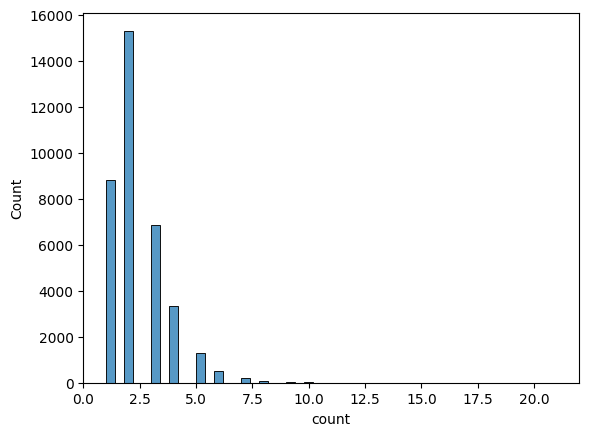

In [128]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_credit_bureau_b_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

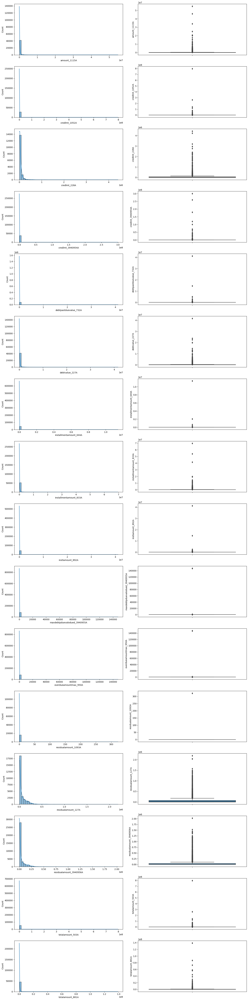

In [129]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_b_1, 'A')

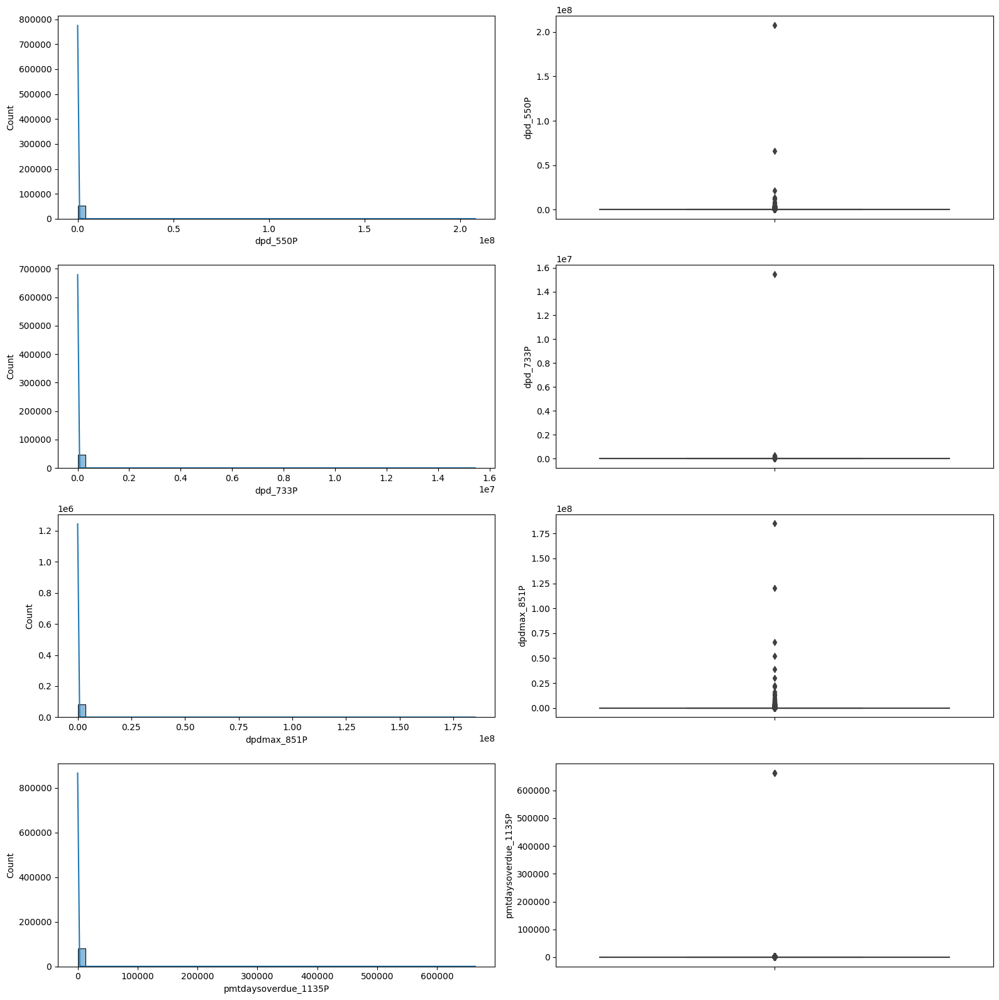

In [130]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_b_1, 'P')

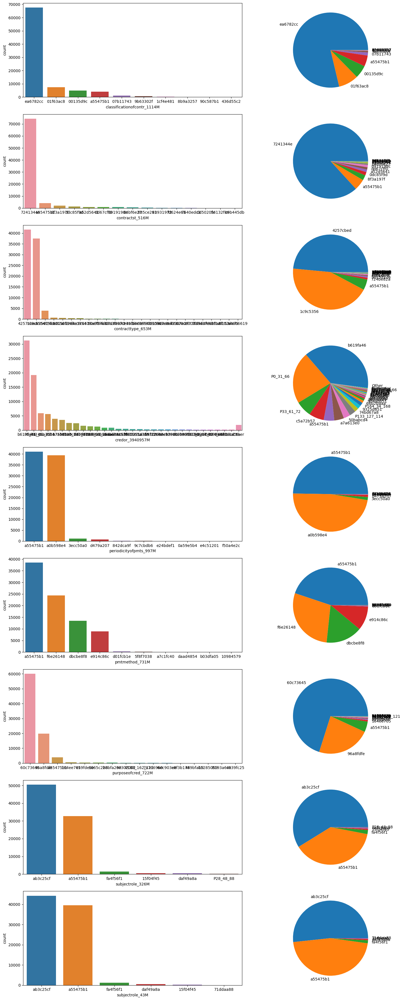

In [131]:
plot_categorical(df_train_credit_bureau_b_1, 'M')

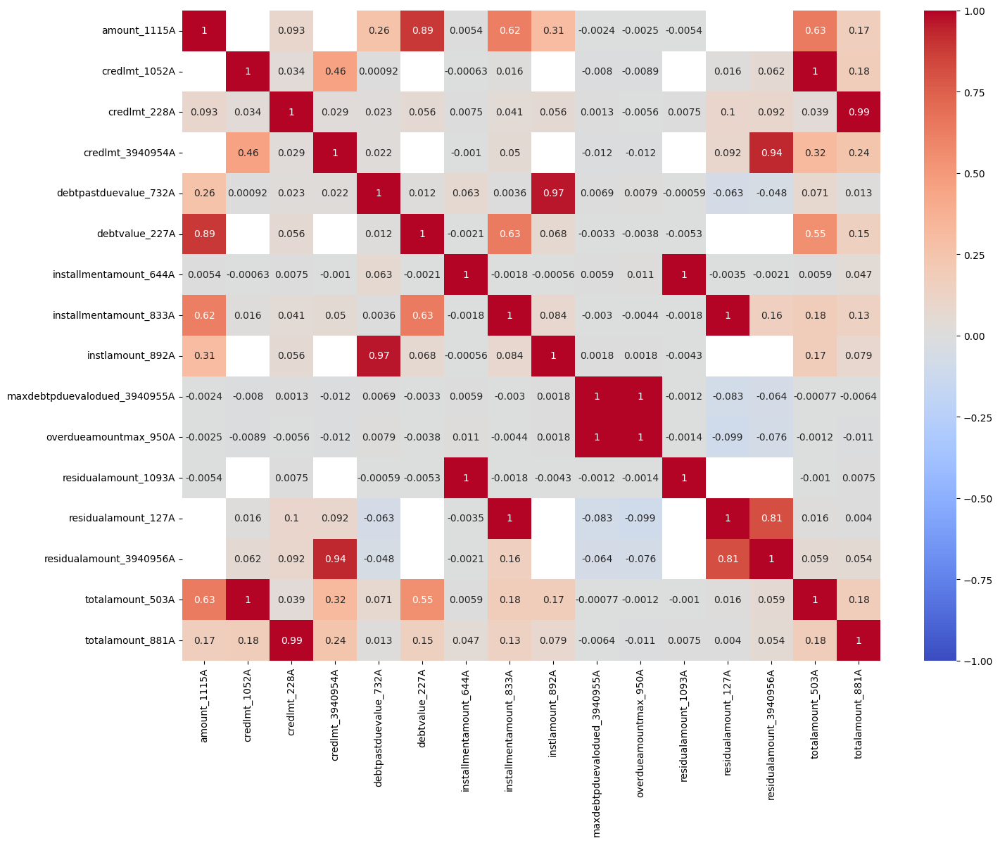

In [132]:
plot_corr(df_train_credit_bureau_b_1, 'A')

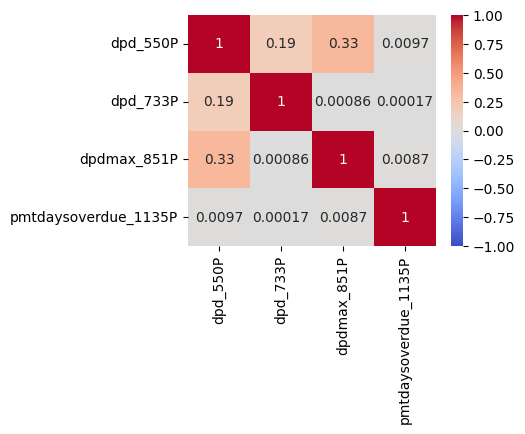

In [133]:
plot_corr(df_train_credit_bureau_b_1, 'P')

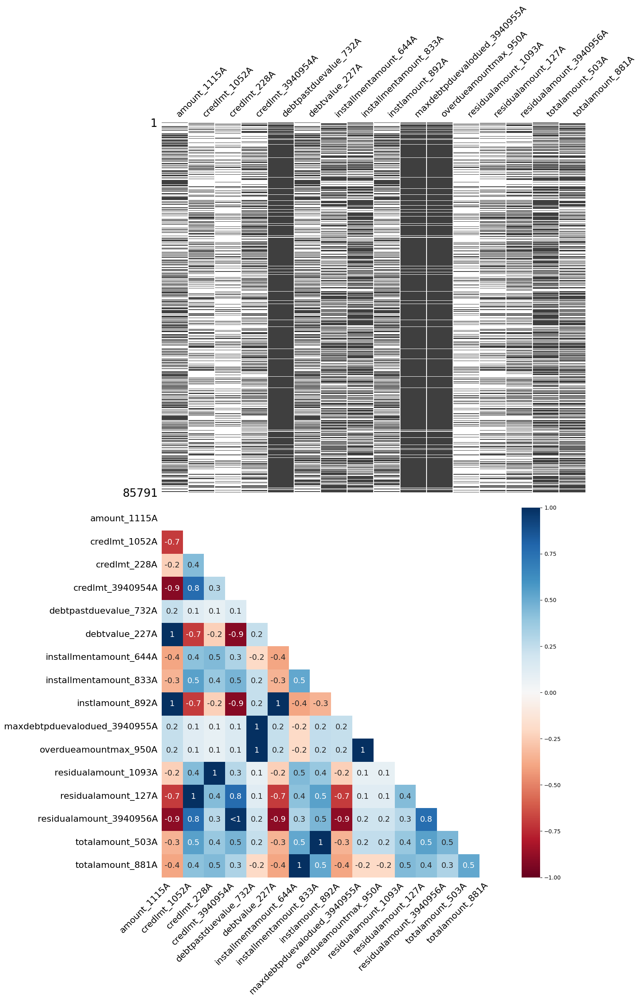

In [134]:
plot_null(df_train_credit_bureau_b_1, 'A')

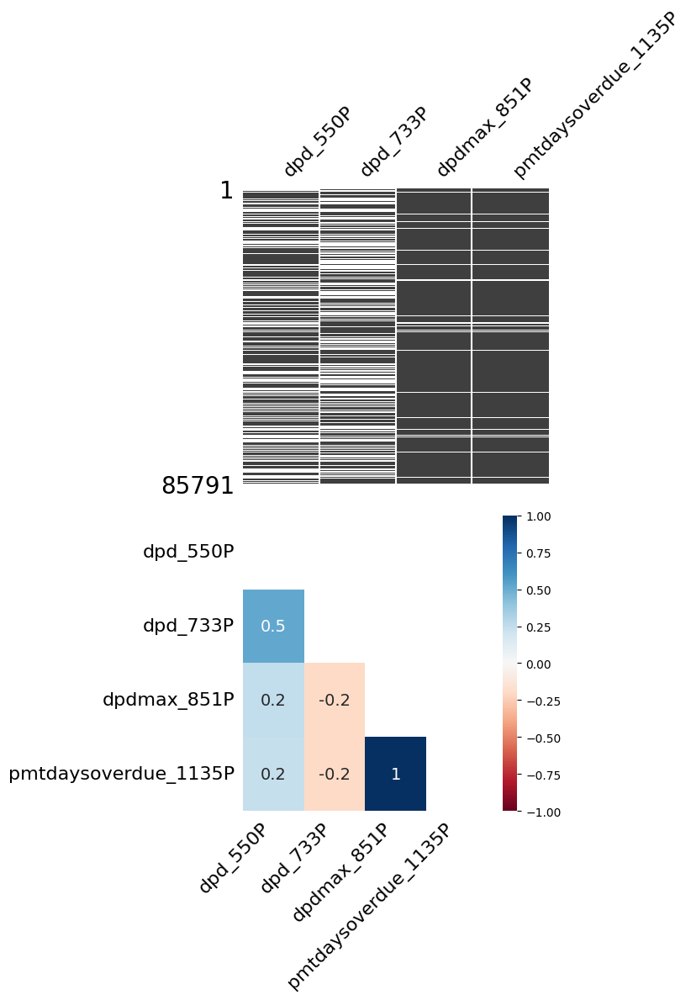

In [135]:
plot_null(df_train_credit_bureau_b_1, 'P')

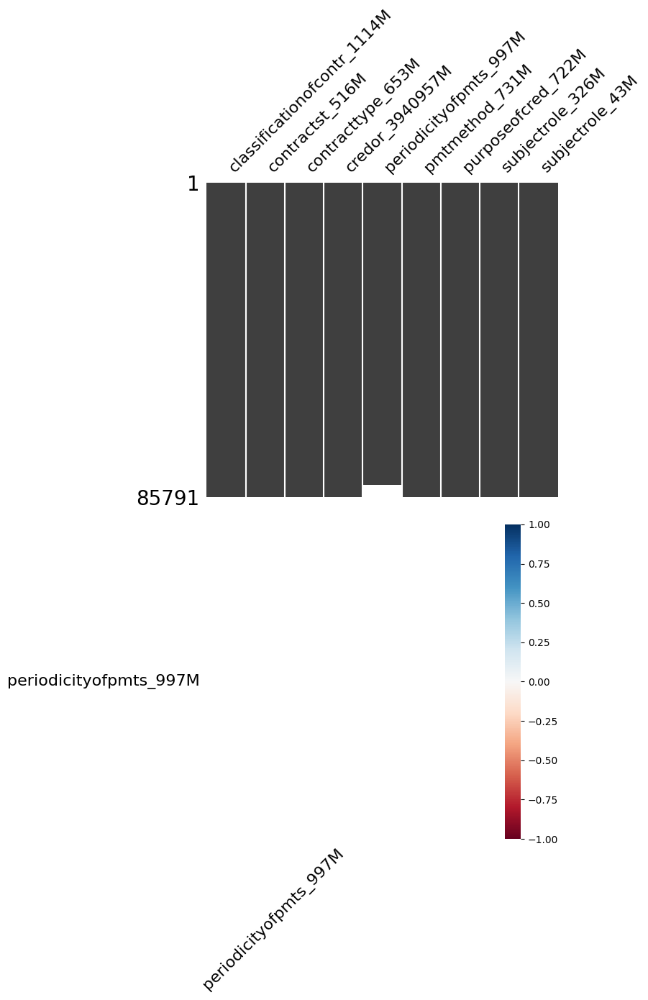

In [136]:
plot_null(df_train_credit_bureau_b_1, 'M')

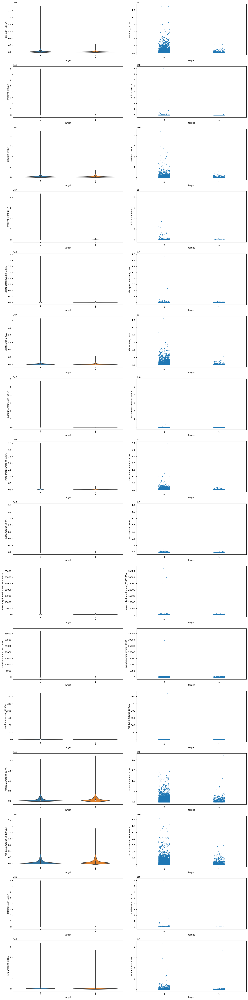

In [137]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_b_1.group_by('case_id').mean(), 'A')

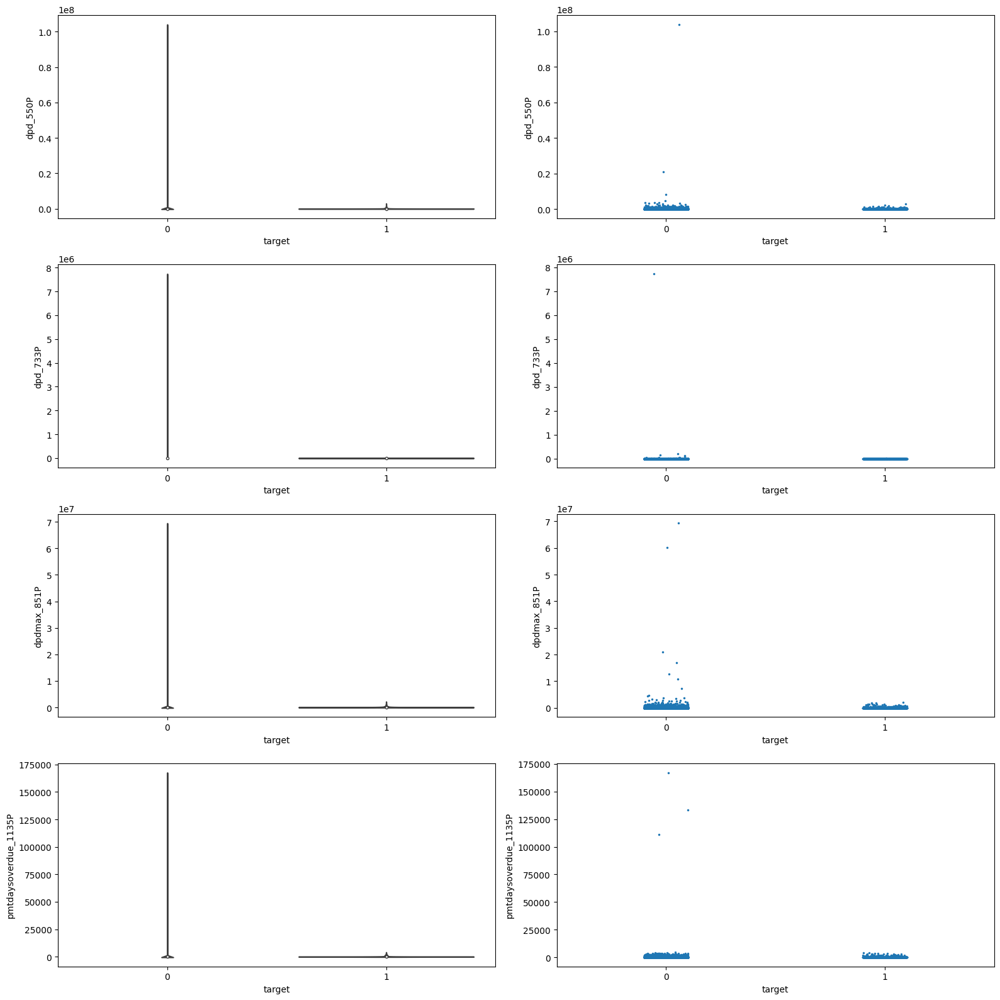

In [138]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_b_1.group_by('case_id').mean(), 'P')

# deposit_1

In [139]:
df_train_deposit_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_deposit_1.parquet')

In [140]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_deposit_1.columns))

Variable,Description
str,str
"""case_id""",null
"""amount_416A""","""Deposit amount."""
"""contractenddate_991D""","""End date of deposit contract."""
"""num_group1""",null
"""openingdate_313D""","""Deposit account opening date."""


In [141]:
display(df_train_deposit_1.head().collect())

case_id,amount_416A,contractenddate_991D,num_group1,openingdate_313D
i64,f64,datetime[μs],i64,datetime[μs]
225,0.0,null,0,2016-08-16 00:00:00
331,260.374,2018-03-18 00:00:00,0,2015-03-19 00:00:00
358,0.0,null,0,2014-09-02 00:00:00
390,203.602,2017-09-30 00:00:00,1,2015-10-01 00:00:00
390,223.68001,null,2,2016-06-08 00:00:00


In [142]:
display(df_train_deposit_1.collect().describe())

describe,case_id,amount_416A,contractenddate_991D,num_group1,openingdate_313D
str,f64,f64,str,f64,str
"""count""",145086.0,145086.0,"""65404""",145086.0,"""145086"""
"""null_count""",0.0,0.0,"""79682""",0.0,"""0"""
"""mean""",1.4662e6,8422.304482,null,0.522531,null
"""std""",886528.958911,86232.120476,null,1.620954,null
"""min""",225.0,-40000.0,"""2002-02-27 00:…",0.0,"""2001-11-19 00:…"
"""25%""",660041.0,0.0,null,0.0,null
"""50%""",1.556939e6,223.658,null,0.0,null
"""75%""",2.530539e6,478.34,null,1.0,null
"""max""",2.703453e6,1.2213286e7,"""2020-03-18 00:…",64.0,"""2017-07-31 00:…"


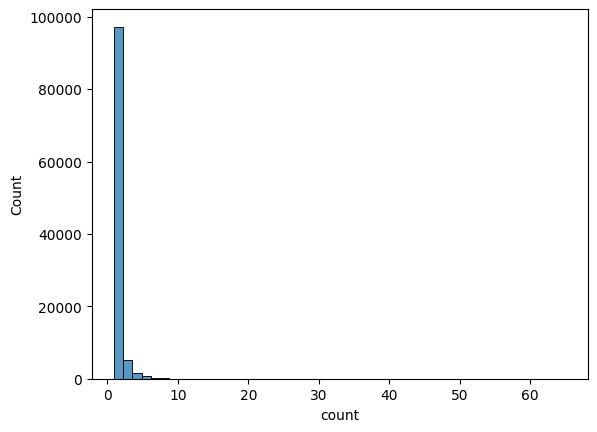

In [143]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_deposit_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

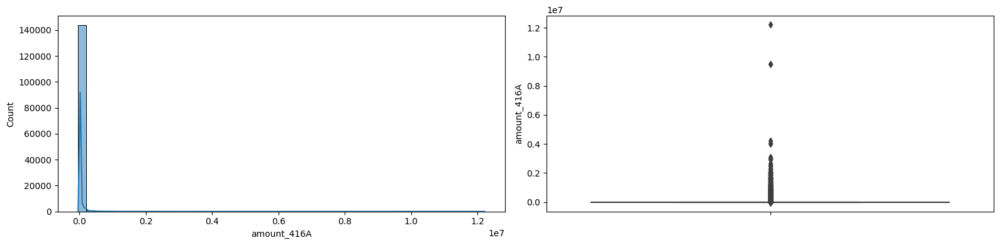

In [144]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_deposit_1, 'A')

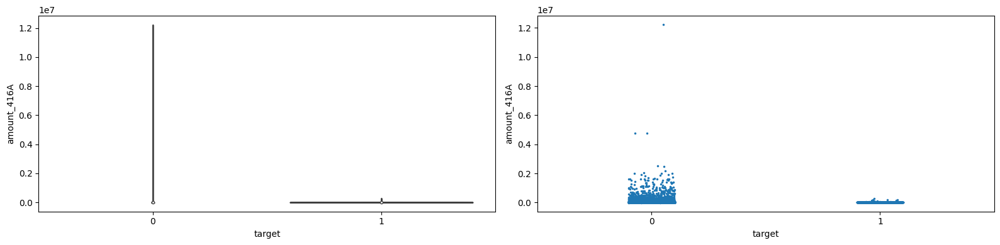

In [145]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_deposit_1.group_by('case_id').mean(), 'A')

# person_1

In [146]:
df_train_person_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_person_1.parquet')

In [147]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    cfg.set_tbl_rows(-1)
    display(get_feature_definitions(df_train_person_1.columns))

Variable,Description
str,str
"""case_id""",null
"""birth_259D""","""Date of birth of the person."""
"""birthdate_87D""","""Birth date of the person."""
"""childnum_185L""","""Number of children of the applicant."""
"""contaddr_district_15M""","""Zip code of a contact person's address."""
"""contaddr_matchlist_1032L""","""Indicates whether the contact address is found in a code list."""
"""contaddr_smempladdr_334L""","""Indicates whether the contact address is the same as the employment address."""
"""contaddr_zipcode_807M""","""Zip code of contact address."""
"""education_927M""","""Education level of the person."""


In [148]:
display(df_train_person_1.head().collect())

case_id,birth_259D,birthdate_87D,childnum_185L,contaddr_district_15M,contaddr_matchlist_1032L,contaddr_smempladdr_334L,contaddr_zipcode_807M,education_927M,empl_employedfrom_271D,empl_employedtotal_800L,empl_industry_691L,empladdr_district_926M,empladdr_zipcode_114M,familystate_447L,gender_992L,housetype_905L,housingtype_772L,incometype_1044T,isreference_387L,language1_981M,mainoccupationinc_384A,maritalst_703L,num_group1,personindex_1023L,persontype_1072L,persontype_792L,registaddr_district_1083M,registaddr_zipcode_184M,relationshiptoclient_415T,relationshiptoclient_642T,remitter_829L,role_1084L,role_993L,safeguarantyflag_411L,sex_738L,type_25L
i64,datetime[μs],datetime[μs],f64,str,bool,bool,str,str,datetime[μs],str,str,str,str,str,str,str,str,str,bool,str,f64,str,i64,f64,f64,f64,str,str,str,str,bool,str,str,bool,str,str
0,1986-07-01 00:00:00,null,null,"""P88_18_84""",false,false,"""P167_100_165""","""P97_36_170""",2017-09-15 00:00:00,"""MORE_FIVE""","""OTHER""","""P142_57_166""","""P167_100_165""","""MARRIED""",null,null,null,"""SALARIED_GOVT""",null,"""P10_39_147""",10800.0,null,0,0.0,1.0,1.0,"""P88_18_84""","""P167_100_165""",null,null,null,"""CL""",null,true,"""F""","""PRIMARY_MOBILE…"
0,null,null,null,"""a55475b1""",null,null,"""a55475b1""","""a55475b1""",null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,"""a55475b1""",null,null,1,1.0,1.0,4.0,"""a55475b1""","""a55475b1""","""SPOUSE""",null,false,"""EM""",null,null,null,"""PHONE"""
0,null,null,null,"""a55475b1""",null,null,"""a55475b1""","""a55475b1""",null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,"""a55475b1""",null,null,2,2.0,4.0,5.0,"""a55475b1""","""a55475b1""","""COLLEAGUE""","""SPOUSE""",false,"""PE""",null,null,null,"""PHONE"""
0,null,null,null,"""a55475b1""",null,null,"""a55475b1""","""a55475b1""",null,null,null,"""a55475b1""","""a55475b1""",null,null,null,null,null,null,"""a55475b1""",null,null,3,null,5.0,null,"""a55475b1""","""a55475b1""",null,"""COLLEAGUE""",null,"""PE""",null,null,null,"""PHONE"""
1,1957-08-01 00:00:00,null,null,"""P103_93_94""",false,false,"""P176_37_166""","""P97_36_170""",2008-10-29 00:00:00,"""MORE_FIVE""","""OTHER""","""P49_46_174""","""P160_59_140""","""DIVORCED""",null,null,null,"""SALARIED_GOVT""",null,"""P10_39_147""",10000.0,null,0,0.0,1.0,1.0,"""P103_93_94""","""P176_37_166""",null,null,null,"""CL""",null,true,"""M""","""PRIMARY_MOBILE…"


In [149]:
display(df_train_person_1.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,birth_259D,birthdate_87D,childnum_185L,empl_employedfrom_271D,mainoccupationinc_384A,num_group1,personindex_1023L,persontype_1072L,persontype_792L
str,f64,str,str,f64,str,f64,f64,f64,f64,f64
"""count""",2.973991e6,"""1526659""","""24916""",9907.0,"""566701""",1.526659e6,2.973991e6,2.331708e6,2.967874e6,2.331708e6
"""null_count""",0.0,"""1447332""","""2949075""",2.964084e6,"""2407290""",1.447332e6,0.0,642283.0,6117.0,642283.0
"""mean""",1.0552e6,null,null,0.616029,null,57707.483462,0.796532,0.438357,2.034862,2.315691
"""std""",724571.385118,null,null,0.96608,null,33348.302845,0.977789,0.659662,1.707171,1.826378
"""min""",0.0,"""1943-03-01 00:…","""1911-12-01 00:…",0.0,"""1963-06-15 00:…",0.0,0.0,0.0,1.0,1.0
"""25%""",637354.0,null,null,0.0,null,36000.0,0.0,0.0,1.0,1.0
"""50%""",890817.0,null,null,0.0,null,50000.0,0.0,0.0,1.0,1.0
"""75%""",1.568334e6,null,null,1.0,null,70000.0,1.0,1.0,4.0,5.0
"""max""",2.703454e6,"""1999-10-01 00:…","""2015-12-01 00:…",11.0,"""2020-09-15 00:…",200000.0,9.0,6.0,5.0,5.0


In [150]:
display(df_train_person_1.select(cs.by_dtype(pl.String).n_unique()).collect())

contaddr_district_15M,contaddr_zipcode_807M,education_927M,empl_employedtotal_800L,empl_industry_691L,empladdr_district_926M,empladdr_zipcode_114M,familystate_447L,gender_992L,housetype_905L,housingtype_772L,incometype_1044T,language1_981M,maritalst_703L,registaddr_district_1083M,registaddr_zipcode_184M,relationshiptoclient_415T,relationshiptoclient_642T,role_1084L,role_993L,sex_738L,type_25L
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
975,3530,6,4,25,223,3339,6,3,7,7,10,3,6,991,3531,11,11,4,2,3,9


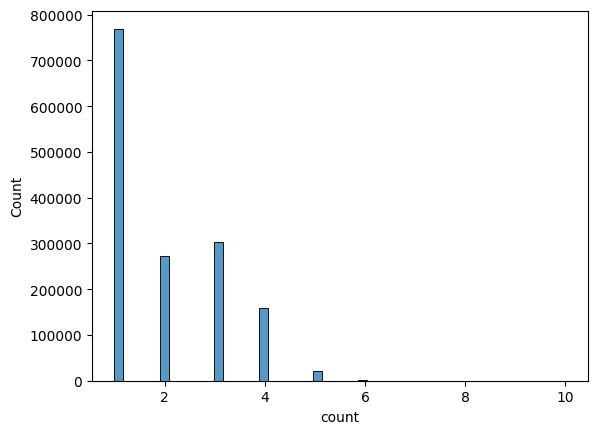

In [151]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_person_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

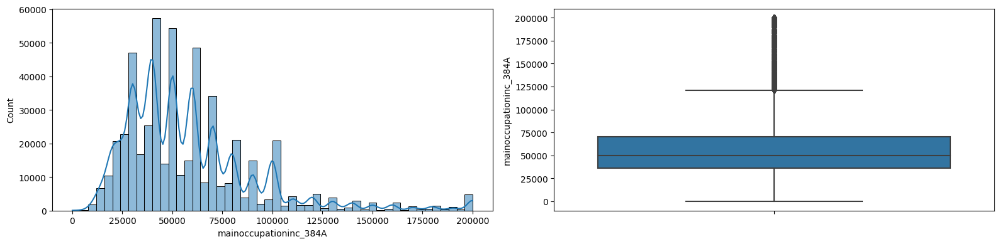

In [152]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_person_1, 'A')

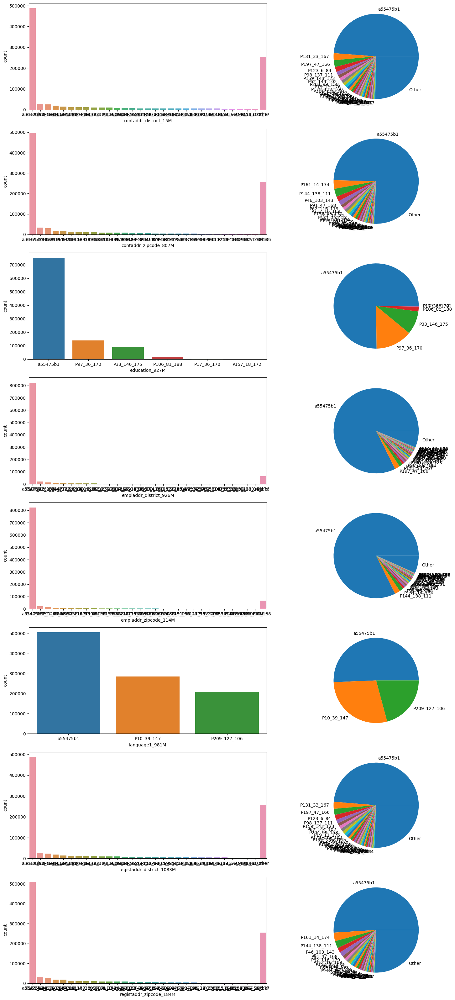

In [153]:
plot_categorical(df_train_person_1, 'M')

- Addresses and zip codes are high-cardinality variables.
  - One majority and many minorities.

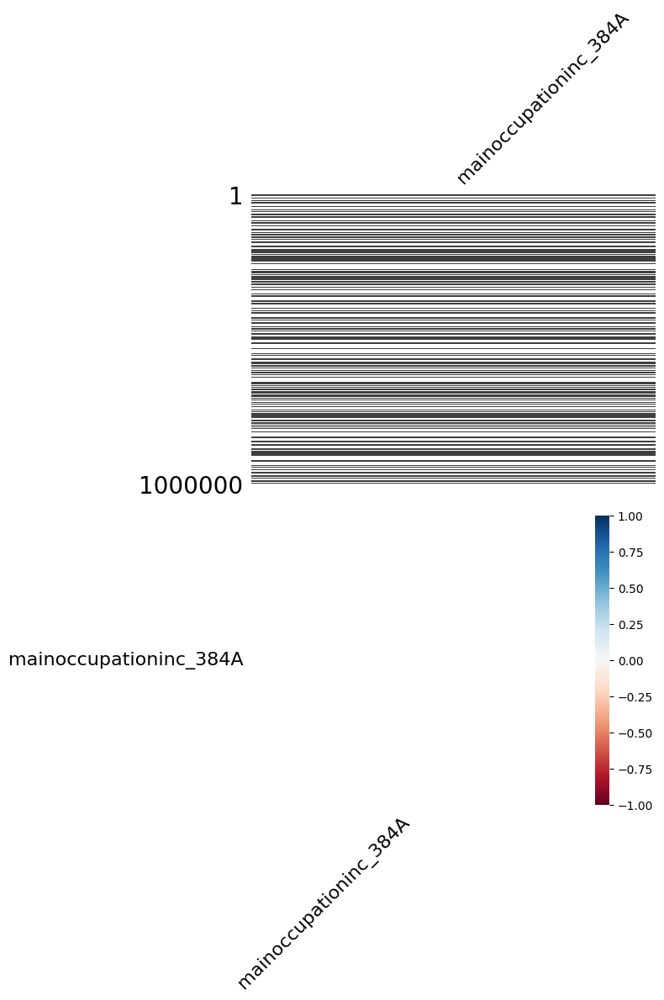

In [154]:
plot_null(df_train_person_1, 'A')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


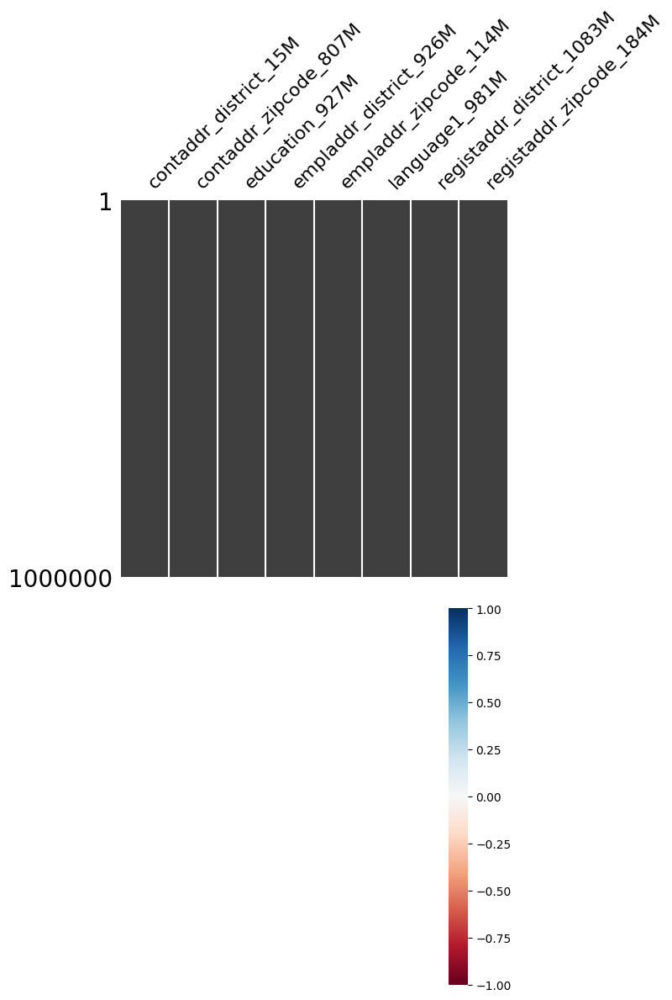

In [155]:
plot_null(df_train_person_1, 'M')

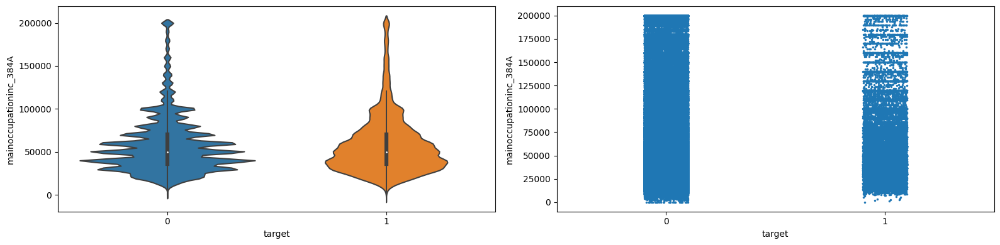

In [156]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_person_1.group_by('case_id').mean(), 'A')

> In case `num_group1` or `num_group2` stands for person index (this is clear with predictor definitions) the zero index has special meaning. When `num_groupN=0` it is the applicant (the person who applied for a loan).

In [157]:
display(df_train_person_1.filter(pl.col('num_group1') == 0).collect().describe())

describe,case_id,birth_259D,birthdate_87D,childnum_185L,contaddr_district_15M,contaddr_matchlist_1032L,contaddr_smempladdr_334L,contaddr_zipcode_807M,education_927M,empl_employedfrom_271D,empl_employedtotal_800L,empl_industry_691L,empladdr_district_926M,empladdr_zipcode_114M,familystate_447L,gender_992L,housetype_905L,housingtype_772L,incometype_1044T,isreference_387L,language1_981M,mainoccupationinc_384A,maritalst_703L,num_group1,personindex_1023L,persontype_1072L,persontype_792L,registaddr_district_1083M,registaddr_zipcode_184M,relationshiptoclient_415T,relationshiptoclient_642T,remitter_829L,role_1084L,role_993L,safeguarantyflag_411L,sex_738L,type_25L
str,f64,str,str,f64,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,f64,str,f64,f64,f64,f64,str,str,str,str,str,str,str,str,str,str
"""count""",1.526659e6,"""1526659""","""12458""",0.0,"""1526659""","""1526218""","""1526218""","""1526659""","""1526659""","""566701""","""528315""","""522236""","""1526659""","""1526659""","""728613""","""12458""","""100818""","""0""","""1526659""","""12458""","""1526659""",1.526659e6,"""1""",1.526659e6,1.526659e6,1.526659e6,1.526659e6,"""1526659""","""1526659""","""0""","""0""","""0""","""1526659""","""12458""","""1526657""","""1526659""","""1526659"""
"""null_count""",0.0,"""0""","""1514201""",1.526659e6,"""0""","""441""","""441""","""0""","""0""","""959958""","""998344""","""1004423""","""0""","""0""","""798046""","""1514201""","""1425841""","""1526659""","""0""","""1514201""","""0""",0.0,"""1526658""",0.0,0.0,0.0,0.0,"""0""","""0""","""1526659""","""1526659""","""1526659""","""0""","""1514201""","""2""","""0""","""0"""
"""mean""",1.2861e6,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,57707.483462,null,0.0,0.0,1.0,1.0,null,null,null,null,null,null,null,null,null,null
"""std""",718946.592285,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,33348.302845,null,0.0,0.0,0.0,0.0,null,null,null,null,null,null,null,null,null,null
"""min""",0.0,"""1943-03-01 00:…","""1943-08-01 00:…",null,"""P0_111_121""","""False""","""False""","""P0_101_75""","""P106_81_188""","""1963-06-15 00:…","""LESS_ONE""","""AGRICULTURE""","""P0_140_162""","""P0_101_75""","""DIVORCED""","""F""","""COMPANY_FLAT""",null,"""EMPLOYED""","""True""","""P10_39_147""",0.0,"""MARRIED""",0.0,0.0,1.0,1.0,"""P0_111_121""","""P0_101_75""",null,null,null,"""CL""","""FULL""","""False""","""F""","""HOME_PHONE"""
"""25%""",766198.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,36000.0,null,0.0,0.0,1.0,1.0,null,null,null,null,null,null,null,null,null,null
"""50%""",1.357358e6,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,50000.0,null,0.0,0.0,1.0,1.0,null,null,null,null,null,null,null,null,null,null
"""75%""",1.739023e6,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,70000.0,null,0.0,0.0,1.0,1.0,null,null,null,null,null,null,null,null,null,null
"""max""",2.703454e6,"""1999-10-01 00:…","""1999-06-01 00:…",null,"""a55475b1""","""False""","""True""","""a55475b1""","""a55475b1""","""2020-09-15 00:…","""MORE_ONE""","""WELNESS""","""a55475b1""","""a55475b1""","""WIDOWED""","""M""","""STATE_FLAT""",null,"""SELFEMPLOYED""","""True""","""a55475b1""",200000.0,"""MARRIED""",0.0,0.0,1.0,1.0,"""a55475b1""","""a55475b1""",null,null,null,"""EM""","""FULL""","""True""","""M""","""WHATSAPP"""


In [158]:
display(df_train_person_1.filter(pl.col('num_group1') != 0).collect().describe())

describe,case_id,birth_259D,birthdate_87D,childnum_185L,contaddr_district_15M,contaddr_matchlist_1032L,contaddr_smempladdr_334L,contaddr_zipcode_807M,education_927M,empl_employedfrom_271D,empl_employedtotal_800L,empl_industry_691L,empladdr_district_926M,empladdr_zipcode_114M,familystate_447L,gender_992L,housetype_905L,housingtype_772L,incometype_1044T,isreference_387L,language1_981M,mainoccupationinc_384A,maritalst_703L,num_group1,personindex_1023L,persontype_1072L,persontype_792L,registaddr_district_1083M,registaddr_zipcode_184M,relationshiptoclient_415T,relationshiptoclient_642T,remitter_829L,role_1084L,role_993L,safeguarantyflag_411L,sex_738L,type_25L
str,f64,str,str,f64,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,f64,str,f64,f64,f64,f64,str,str,str,str,str,str,str,str,str,str
"""count""",1.447332e6,"""0""","""12458""",9907.0,"""1447332""","""0""","""0""","""1447332""","""1447332""","""0""","""0""","""0""","""1447332""","""1447332""","""0""","""12458""","""0""","""9815""","""0""","""12458""","""1447332""",0.0,"""11344""",1.447332e6,805049.0,1.441215e6,805049.0,"""1447332""","""1447332""","""805049""","""805942""","""805049""","""1441215""","""12458""","""0""","""0""","""1441215"""
"""null_count""",0.0,"""1447332""","""1434874""",1.437425e6,"""0""","""1447332""","""1447332""","""0""","""0""","""1447332""","""1447332""","""1447332""","""0""","""0""","""1447332""","""1434874""","""1447332""","""1437517""","""1447332""","""1434874""","""0""",1.447332e6,"""1435988""",0.0,642283.0,6117.0,642283.0,"""0""","""0""","""642283""","""641390""","""642283""","""6117""","""1434874""","""1447332""","""1447332""","""6117"""
"""mean""",811660.268004,null,null,0.616029,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1.636721,1.269637,3.131077,4.810708,null,null,null,null,null,null,null,null,null,null
"""std""",646553.439039,null,null,0.96608,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,0.767717,0.452698,1.914558,0.39174,null,null,null,null,null,null,null,null,null,null
"""min""",0.0,null,"""1911-12-01 00:…",0.0,"""a55475b1""",null,null,"""a55475b1""","""P106_81_188""",null,null,null,"""a55475b1""","""a55475b1""",null,"""F""",null,"""COMPANY_FLAT""",null,"""False""","""a55475b1""",null,"""DIVORCED""",1.0,1.0,1.0,4.0,"""a55475b1""","""a55475b1""","""CHILD""","""CHILD""","""False""","""CL""","""FULL""",null,null,"""ALTERNATIVE_PH…"
"""25%""",207167.0,null,null,0.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1.0,1.0,1.0,5.0,null,null,null,null,null,null,null,null,null,null
"""50%""",754229.0,null,null,0.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1.0,1.0,4.0,5.0,null,null,null,null,null,null,null,null,null,null
"""75%""",948289.0,null,null,1.0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2.0,2.0,5.0,5.0,null,null,null,null,null,null,null,null,null,null
"""max""",2.703453e6,null,"""2015-12-01 00:…",11.0,"""a55475b1""",null,null,"""a55475b1""","""a55475b1""",null,null,null,"""a55475b1""","""a55475b1""",null,"""M""",null,"""STATE_FLAT""",null,"""False""","""a55475b1""",null,"""WIDOWED""",9.0,6.0,5.0,5.0,"""a55475b1""","""a55475b1""","""SPOUSE""","""SPOUSE""","""False""","""PE""","""FULL""",null,null,"""WHATSAPP"""


- Some columns missing all values for one of `num_group1 == 0` and `num_group1 != 0`

# debitcard_1

In [159]:
df_train_debitcard_1 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_debitcard_1.parquet')

In [160]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_debitcard_1.columns))

Variable,Description
str,str
"""case_id""",null
"""last180dayaveragebalance_704A""","""Average balance on debit card in the last 180 days."""
"""last180dayturnover_1134A""","""Debit card's turnover within the last 180 days."""
"""last30dayturnover_651A""","""Debit card turnover for the last 30 days."""
"""num_group1""",null
"""openingdate_857D""","""Debit card opening date."""


In [161]:
display(df_train_debitcard_1.head().collect())

case_id,last180dayaveragebalance_704A,last180dayturnover_1134A,last30dayturnover_651A,num_group1,openingdate_857D
i64,f64,f64,f64,i64,datetime[μs]
225,null,null,null,0,2016-08-16 00:00:00
331,null,null,null,0,2015-03-19 00:00:00
358,null,null,null,0,2014-09-02 00:00:00
390,null,null,null,0,2014-07-23 00:00:00
390,null,null,null,1,2015-10-01 00:00:00


In [162]:
display(df_train_debitcard_1.collect().describe())

describe,case_id,last180dayaveragebalance_704A,last180dayturnover_1134A,last30dayturnover_651A,num_group1,openingdate_857D
str,f64,f64,f64,f64,f64,str
"""count""",157302.0,12216.0,11081.0,11081.0,157302.0,"""144591"""
"""null_count""",0.0,145086.0,146221.0,146221.0,0.0,"""12711"""
"""mean""",1.4688e6,109.635884,38494.508518,4955.383495,0.549306,null
"""std""",888331.57638,949.997458,41400.589013,19217.736947,1.639082,null
"""min""",225.0,-308.79413,-187780.0,-477.506,0.0,"""2001-11-19 00:…"
"""25%""",649173.0,0.0,7878.0,0.0,0.0,null
"""50%""",1.560138e6,0.0,30000.0,0.0,0.0,null
"""75%""",2.531591e6,1.053812,60000.0,0.0,1.0,null
"""max""",2.703453e6,67777.77,1.16182e6,390000.0,65.0,"""2017-07-31 00:…"


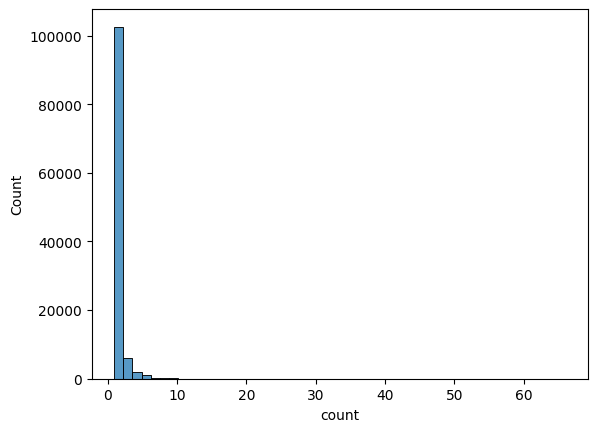

In [163]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_debitcard_1.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

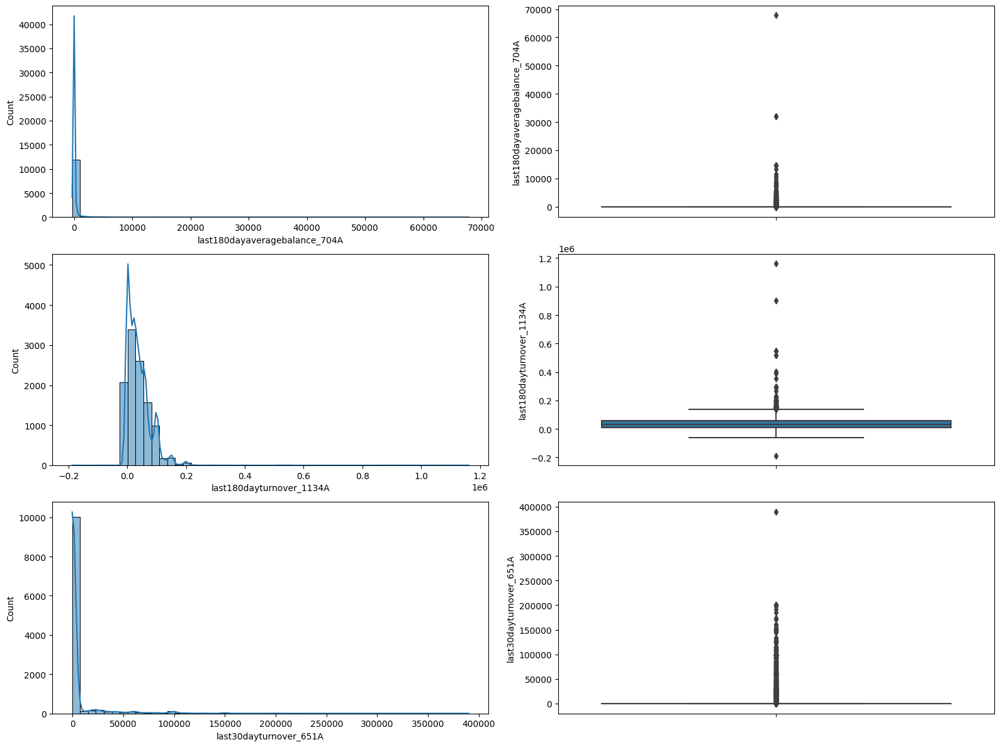

In [164]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_debitcard_1, 'A')

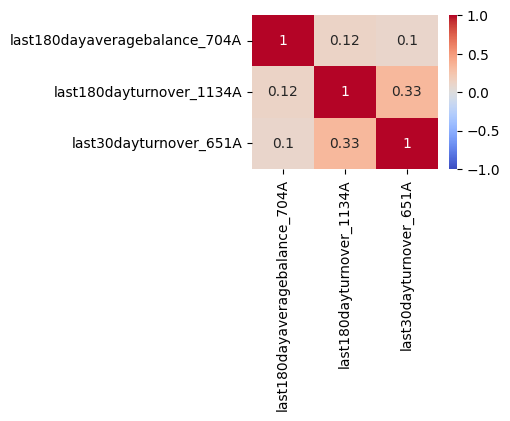

In [165]:
plot_corr(df_train_debitcard_1, 'A')

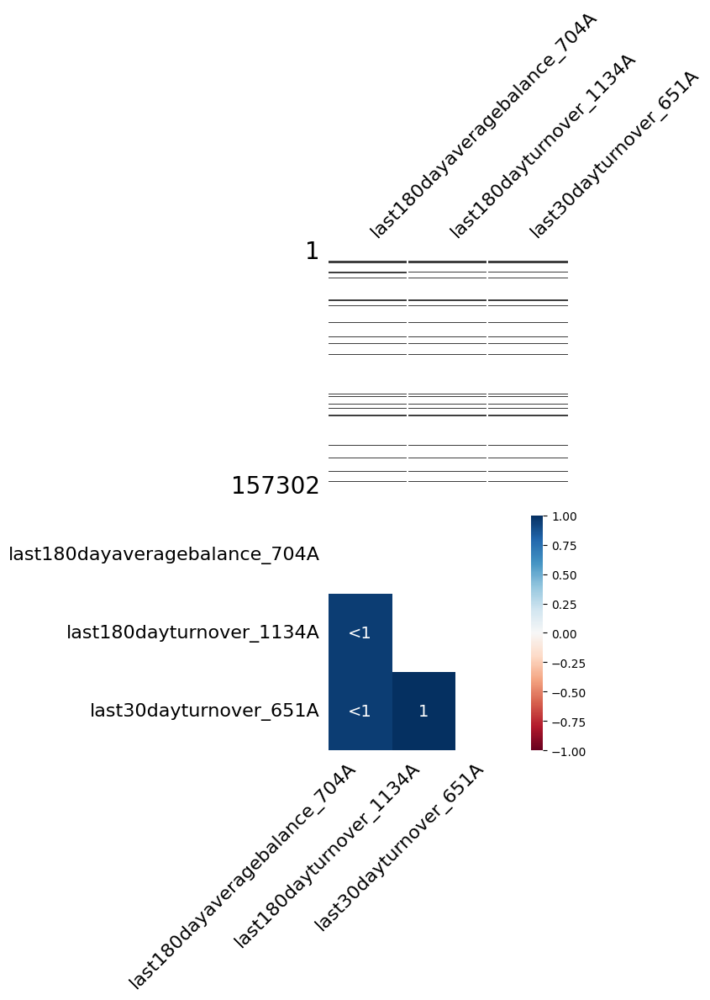

In [166]:
plot_null(df_train_debitcard_1, 'A')

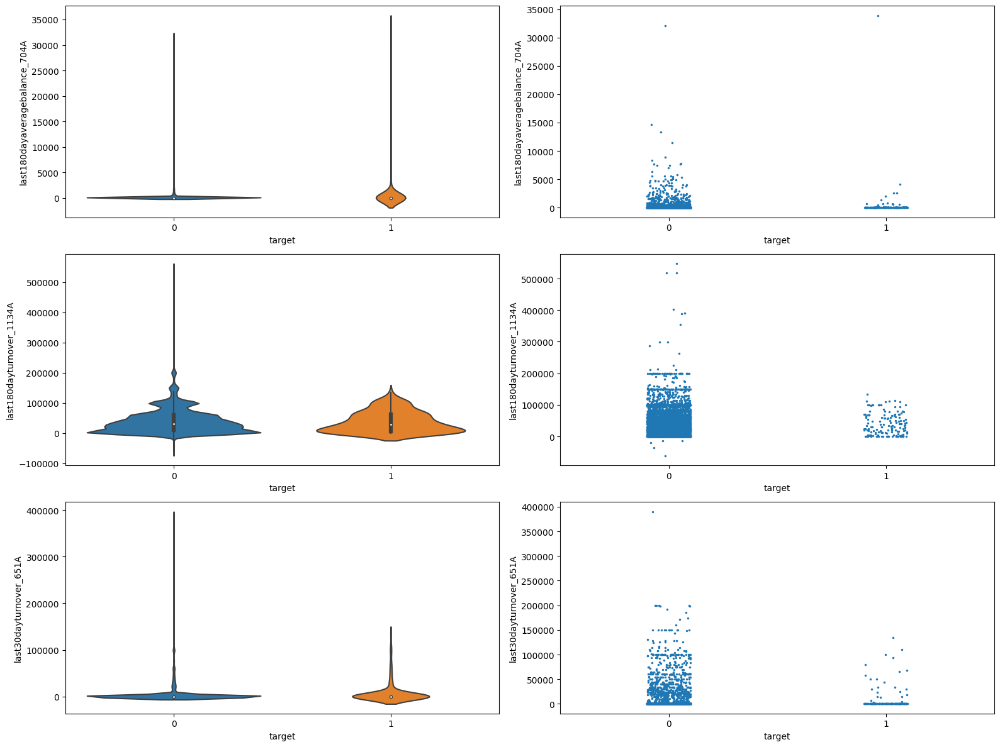

In [167]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_debitcard_1.group_by('case_id').mean(), 'A')

# applprev_2

In [168]:
df_train_applprev_2 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_applprev_2.parquet')

In [169]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_applprev_2.columns))

Variable,Description
str,str
"""case_id""",null
"""cacccardblochreas_147M""","""Card blocking reason."""
"""conts_type_509L""","""Person contact type in previous application."""
"""credacc_cards_status_52L""","""Card status of the previous credit account."""
"""num_group1""",null
"""num_group2""",null


In [170]:
display(df_train_applprev_2.head().collect())

case_id,cacccardblochreas_147M,conts_type_509L,credacc_cards_status_52L,num_group1,num_group2
i64,str,str,str,i64,i64
2,null,"""PRIMARY_MOBILE…",null,0,0
2,null,"""EMPLOYMENT_PHO…",null,0,1
2,null,"""PRIMARY_MOBILE…",null,1,0
2,null,"""EMPLOYMENT_PHO…",null,1,1
3,null,"""PHONE""",null,0,0


In [171]:
display(df_train_applprev_2.select(cs.by_dtype(pl.String).n_unique()).collect())

cacccardblochreas_147M,conts_type_509L,credacc_cards_status_52L
u32,u32,u32
10,10,7


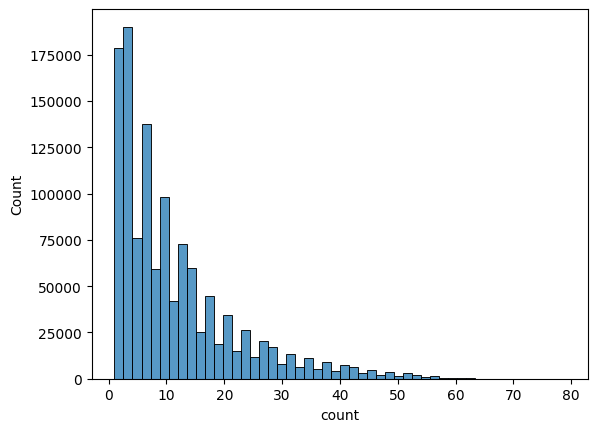

In [172]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_applprev_2.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

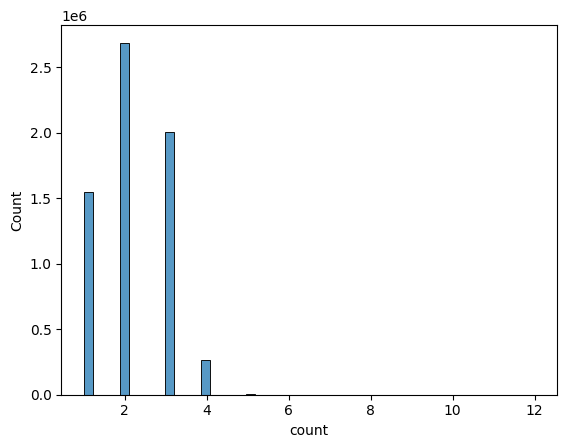

In [173]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_applprev_2.group_by('case_id', 'num_group1')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

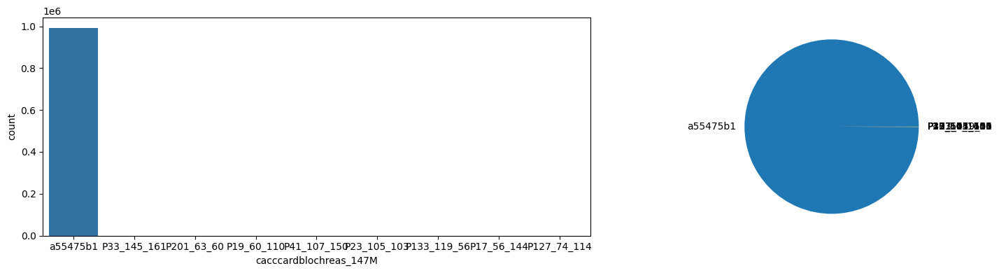

In [174]:
plot_categorical(df_train_applprev_2, 'M')

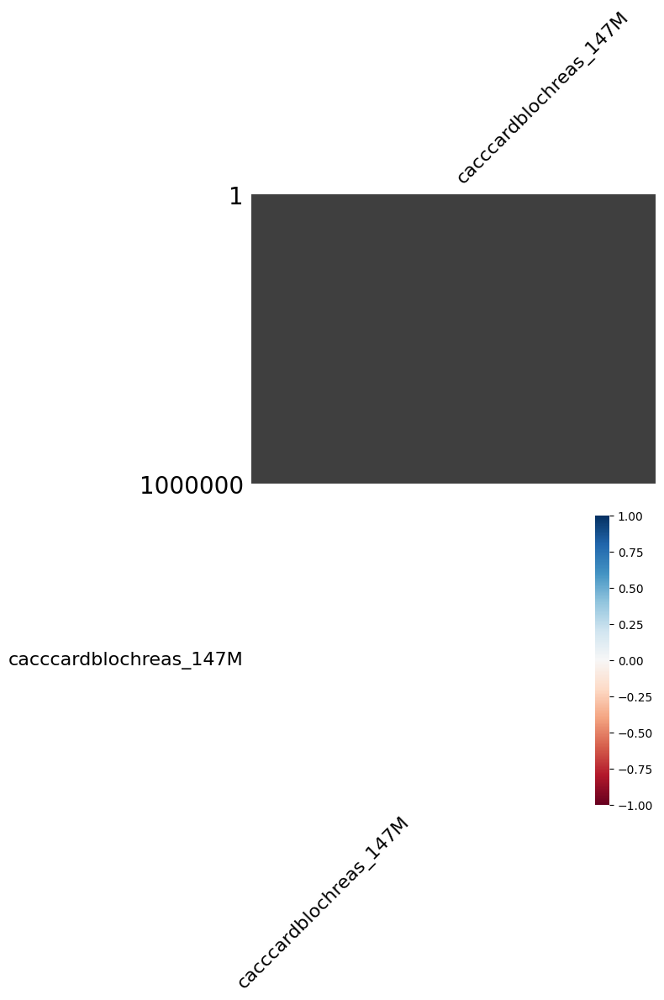

In [175]:
plot_null(df_train_applprev_2, 'M')

# person_2

In [176]:
df_train_person_2 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_person_2.parquet')

In [177]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_person_2.columns))

Variable,Description
str,str
"""case_id""",null
"""addres_district_368M""","""District of the person's address."""
"""addres_role_871L""","""Role of person's address."""
"""addres_zip_823M""","""Zip code of the address."""
"""conts_role_79M""","""Type of contact role of a person."""
"""empls_economicalst_849M""","""The economical status of the person (num_group1 - person, num_group2 - employment)."""
"""empls_employedfrom_796D""","""Start of employment (num_group1 - person, num_group2 - employment)."""
"""empls_employer_name_740M""","""Employer's name (num_group1 - person, num_group2 - employment)."""
"""num_group1""",null


In [178]:
display(df_train_person_2.head().collect())

case_id,addres_district_368M,addres_role_871L,addres_zip_823M,conts_role_79M,empls_economicalst_849M,empls_employedfrom_796D,empls_employer_name_740M,num_group1,num_group2,relatedpersons_role_762T
i64,str,str,str,str,str,datetime[μs],str,i64,i64,str
5,"""a55475b1""",null,"""a55475b1""","""a55475b1""","""a55475b1""",null,"""a55475b1""",0,0,null
6,"""P55_110_32""","""CONTACT""","""P10_68_40""","""P38_92_157""","""P164_110_33""",null,"""a55475b1""",0,0,null
6,"""P55_110_32""","""PERMANENT""","""P10_68_40""","""a55475b1""","""a55475b1""",null,"""a55475b1""",0,1,null
6,"""P204_92_178""","""CONTACT""","""P65_136_169""","""P38_92_157""","""P164_110_33""",null,"""a55475b1""",1,0,"""OTHER_RELATIVE…"
6,"""P191_109_75""","""CONTACT""","""P10_68_40""","""P7_147_157""","""a55475b1""",null,"""a55475b1""",1,1,"""OTHER_RELATIVE…"


In [179]:
display(df_train_person_2.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,empls_employedfrom_796D,num_group1,num_group2
str,f64,str,f64,f64
"""count""",1.64341e6,"""5757""",1.64341e6,1.64341e6
"""null_count""",0.0,"""1637653""",0.0,0.0
"""mean""",1.2640e6,null,0.111542,0.123701
"""std""",699545.475531,null,0.322408,0.761245
"""min""",5.0,"""1972-08-15 00:…",0.0,0.0
"""25%""",761958.0,null,0.0,0.0
"""50%""",1.323516e6,null,0.0,0.0
"""75%""",1.695937e6,null,0.0,0.0
"""max""",2.703454e6,"""2020-01-19 00:…",4.0,31.0


In [180]:
display(df_train_person_2.select(cs.by_dtype(pl.String).n_unique()).collect())

addres_district_368M,addres_role_871L,addres_zip_823M,conts_role_79M,empls_economicalst_849M,empls_employer_name_740M,relatedpersons_role_762T
u32,u32,u32,u32,u32,u32,u32
508,9,2027,11,10,7153,11


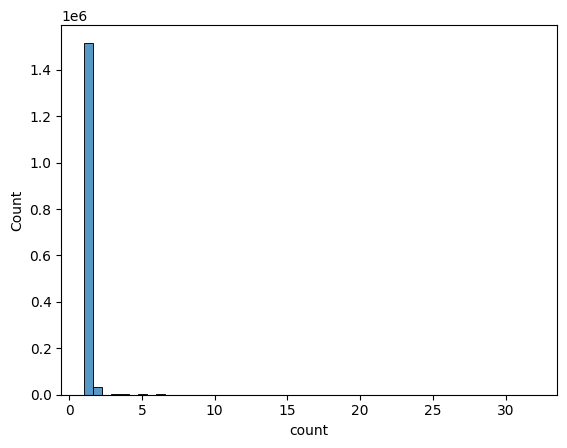

In [181]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_person_2.group_by('case_id', 'num_group1')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

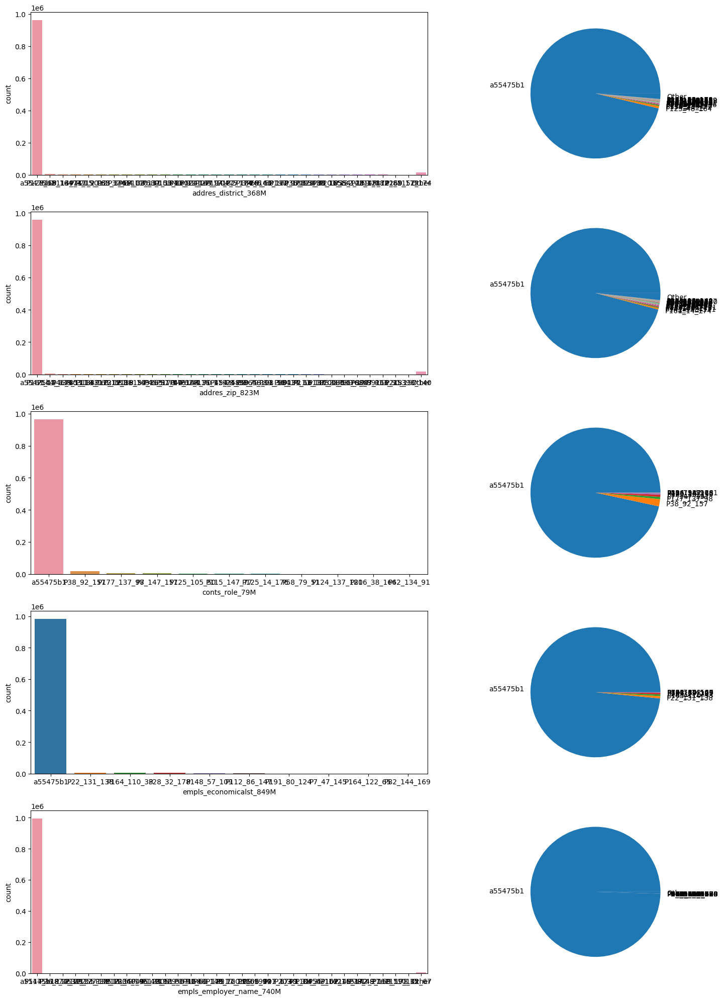

In [182]:
plot_categorical(df_train_person_2, 'M')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


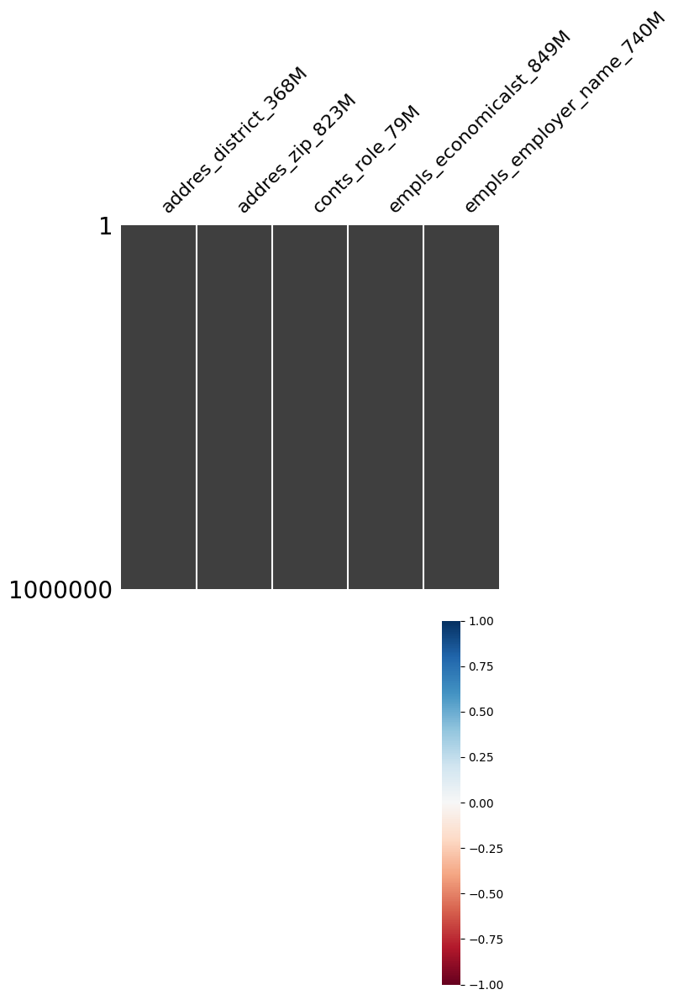

In [183]:
plot_null(df_train_person_2, 'M')

- Addresses, zip codes, and names are high-cardinality variables.

In [184]:
display(df_train_person_2.filter(pl.col('num_group1') == 0).collect().describe())

describe,case_id,addres_district_368M,addres_role_871L,addres_zip_823M,conts_role_79M,empls_economicalst_849M,empls_employedfrom_796D,empls_employer_name_740M,num_group1,num_group2,relatedpersons_role_762T
str,f64,str,str,str,str,str,str,str,f64,f64,str
"""count""",1.463928e6,"""1463928""","""16690""","""1463928""","""1463928""","""1463928""","""1""","""1463928""",1.463928e6,1.463928e6,"""1"""
"""null_count""",0.0,"""0""","""1447238""","""0""","""0""","""0""","""1463927""","""0""",0.0,0.0,"""1463927"""
"""mean""",1.2955e6,null,null,null,null,null,null,null,0.0,0.020649,null
"""std""",709572.572444,null,null,null,null,null,null,null,0.0,0.149099,null
"""min""",5.0,"""P0_111_121""","""CONTACT""","""P0_101_75""","""P125_14_176""","""P112_86_147""","""2012-07-15 00:…","""P207_71_72""",0.0,0.0,"""SPOUSE"""
"""25%""",776995.0,null,null,null,null,null,null,null,0.0,0.0,null
"""50%""",1.359957e6,null,null,null,null,null,null,null,0.0,0.0,null
"""75%""",1.719454e6,null,null,null,null,null,null,null,0.0,0.0,null
"""max""",2.703454e6,"""a55475b1""","""PERMANENT""","""a55475b1""","""a55475b1""","""a55475b1""","""2012-07-15 00:…","""a55475b1""",0.0,8.0,"""SPOUSE"""


In [185]:
display(df_train_person_2.filter(pl.col('num_group1') != 0).collect().describe())

describe,case_id,addres_district_368M,addres_role_871L,addres_zip_823M,conts_role_79M,empls_economicalst_849M,empls_employedfrom_796D,empls_employer_name_740M,num_group1,num_group2,relatedpersons_role_762T
str,f64,str,str,str,str,str,str,str,f64,f64,str
"""count""",179482.0,"""179482""","""50984""","""179482""","""179482""","""179482""","""5756""","""179482""",179482.0,179482.0,"""28725"""
"""null_count""",0.0,"""0""","""128498""","""0""","""0""","""0""","""173726""","""0""",0.0,0.0,"""150757"""
"""mean""",1.0073e6,null,null,null,null,null,null,null,1.021328,0.964242,null
"""std""",547842.338066,null,null,null,null,null,null,null,0.150297,2.081264,null
"""min""",6.0,"""P0_159_155""","""CONTACT""","""P0_101_75""","""P115_147_77""","""P112_86_147""","""1972-08-15 00:…","""P0_112_117""",1.0,0.0,"""CHILD"""
"""25%""",701891.0,null,null,null,null,null,null,null,1.0,0.0,null
"""50%""",872131.0,null,null,null,null,null,null,null,1.0,0.0,null
"""75%""",1.413552e6,null,null,null,null,null,null,null,1.0,1.0,null
"""max""",2.703094e6,"""a55475b1""","""TEMPORARY""","""a55475b1""","""a55475b1""","""a55475b1""","""2020-01-19 00:…","""a55475b1""",4.0,31.0,"""SPOUSE"""


# credit_bureau_a_2

In [186]:
df_train_credit_bureau_a_2 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_credit_bureau_a_2_*.parquet')

In [187]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_credit_bureau_a_2.columns))

Variable,Description
str,str
"""case_id""",null
"""collater_typofvalofguarant_298M""","""Collateral valuation type (active contract)."""
"""collater_typofvalofguarant_407M""","""Collateral valuation type (closed contract)."""
"""collater_valueofguarantee_1124L""","""Value of collateral for active contract."""
"""collater_valueofguarantee_876L""","""Value of collateral for closed contract."""
"""collaterals_typeofguarante_359M""","""Type of collateral that was used as a guarantee for a closed contract."""
"""collaterals_typeofguarante_669M""","""Collateral type for the active contract."""
"""num_group1""",null
"""num_group2""",null


In [188]:
display(df_train_credit_bureau_a_2.head().collect())

case_id,collater_typofvalofguarant_298M,collater_typofvalofguarant_407M,collater_valueofguarantee_1124L,collater_valueofguarantee_876L,collaterals_typeofguarante_359M,collaterals_typeofguarante_669M,num_group1,num_group2,pmts_dpd_1073P,pmts_dpd_303P,pmts_month_158T,pmts_month_706T,pmts_overdue_1140A,pmts_overdue_1152A,pmts_year_1139T,pmts_year_507T,subjectroles_name_541M,subjectroles_name_838M
i64,str,str,f64,f64,str,str,i64,i64,f64,f64,f64,f64,f64,f64,f64,f64,str,str
388,"""8fd95e4b""","""a55475b1""",0.0,null,"""a55475b1""","""c7a5ad39""",0,0,null,null,2.0,null,null,null,2018.0,null,"""a55475b1""","""ab3c25cf"""
388,"""9a0c095e""","""a55475b1""",0.0,null,"""a55475b1""","""c7a5ad39""",1,0,null,null,2.0,null,null,null,2018.0,null,"""a55475b1""","""ab3c25cf"""
388,"""a55475b1""","""a55475b1""",null,null,"""a55475b1""","""a55475b1""",0,1,null,null,3.0,null,null,null,2018.0,null,"""a55475b1""","""a55475b1"""
388,"""a55475b1""","""a55475b1""",null,null,"""a55475b1""","""a55475b1""",0,2,null,null,4.0,null,null,null,2018.0,null,"""a55475b1""","""a55475b1"""
388,"""a55475b1""","""a55475b1""",null,null,"""a55475b1""","""a55475b1""",0,3,null,null,5.0,null,null,null,2018.0,null,"""a55475b1""","""a55475b1"""


In [189]:
display(df_train_credit_bureau_a_2.select(cs.by_dtype(pl.NUMERIC_DTYPES, pl.Datetime)).collect().describe())

describe,case_id,collater_valueofguarantee_1124L,collater_valueofguarantee_876L,num_group1,num_group2,pmts_dpd_1073P,pmts_dpd_303P,pmts_month_158T,pmts_month_706T,pmts_overdue_1140A,pmts_overdue_1152A,pmts_year_1139T,pmts_year_507T
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""",1.88298452e8,2.753335e6,6.88425e6,1.88298452e8,1.88298452e8,3.53073e7,7.4833006e7,6.6129816e7,1.58729472e8,3.5447932e7,7.4920812e7,6.6129816e7,1.58729472e8
"""null_count""",0.0,1.85545117e8,1.81414202e8,0.0,0.0,1.52991152e8,1.13465446e8,1.22168636e8,2.956898e7,1.5285052e8,1.1337764e8,1.22168636e8,2.956898e7
"""mean""",1.4175e6,5.0781e6,3.3279e6,4.49829,13.551397,10.96705,55.740284,6.5,6.5,1965.965534,4156.582218,2018.712112,2014.450049
"""std""",743710.919371,1.9357e8,1.0386e8,6.58235,9.393154,130.17975,289.843378,3.452053,3.452053,329113.00755,152052.657167,0.901424,3.95377
"""min""",388.0,0.0,0.0,0.0,0.0,0.0,-30.0,1.0,1.0,0.0,0.0,2008.0,2000.0
"""25%""",882722.0,0.0,0.0,1.0,6.0,0.0,0.0,4.0,4.0,0.0,0.0,2018.0,2012.0
"""50%""",1.557341e6,0.0,0.0,3.0,12.0,0.0,0.0,7.0,7.0,0.0,0.0,2019.0,2015.0
"""75%""",1.832773e6,0.0,0.0,6.0,20.0,0.0,0.0,9.0,9.0,0.0,0.0,2019.0,2018.0
"""max""",2.703454e6,9.8780e10,9.8780e10,332.0,100.0,4877.0,657458.0,12.0,12.0,4.373397e8,5.93465e8,2021.0,2028.0


- The max of `pmts_dpd_303P` is greater than `600000 days ~ 1643 years`.

In [190]:
display(df_train_credit_bureau_a_2.select(cs.by_dtype(pl.String).n_unique()).collect())

collater_typofvalofguarant_298M,collater_typofvalofguarant_407M,collaterals_typeofguarante_359M,collaterals_typeofguarante_669M,subjectroles_name_541M,subjectroles_name_838M
u32,u32,u32,u32,u32,u32
5,8,15,15,11,9


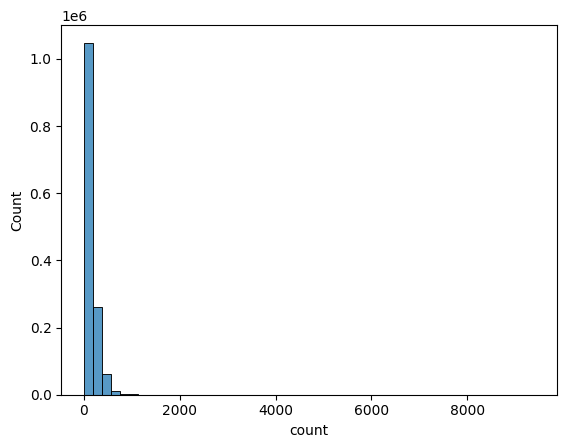

In [191]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_credit_bureau_a_2.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

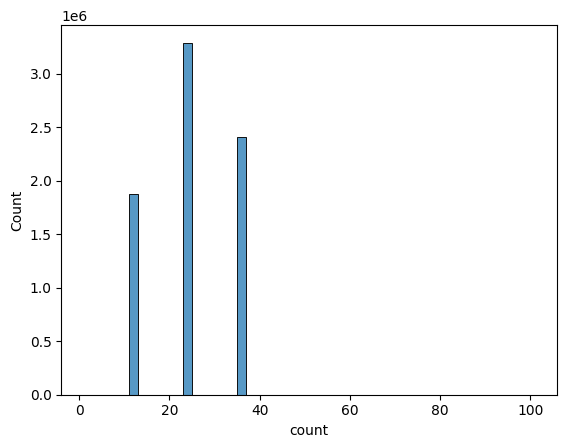

In [192]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_credit_bureau_a_2.group_by('case_id', 'num_group1')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

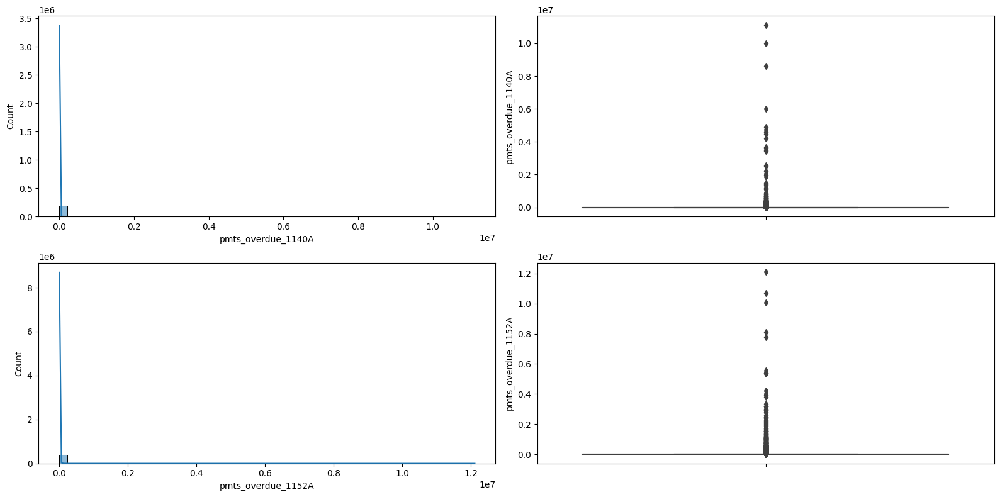

In [193]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_a_2, 'A')

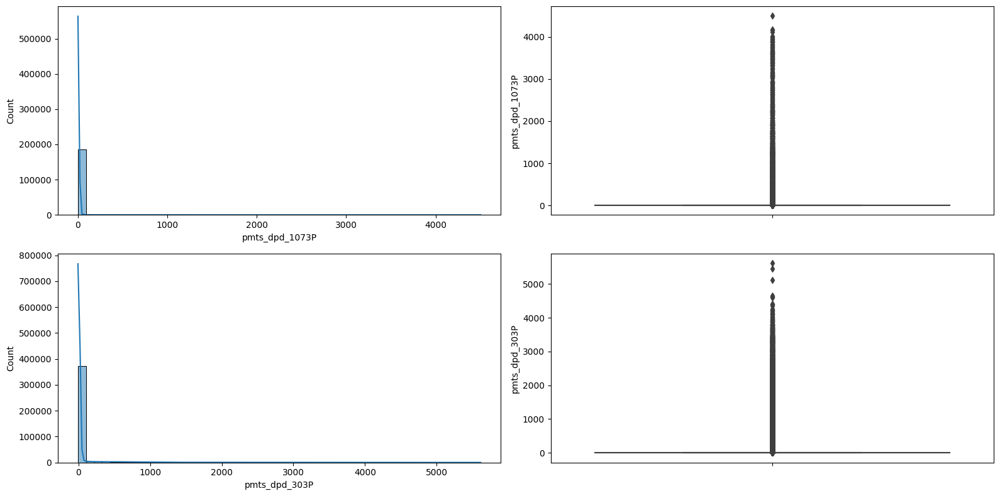

In [194]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_a_2, 'P')

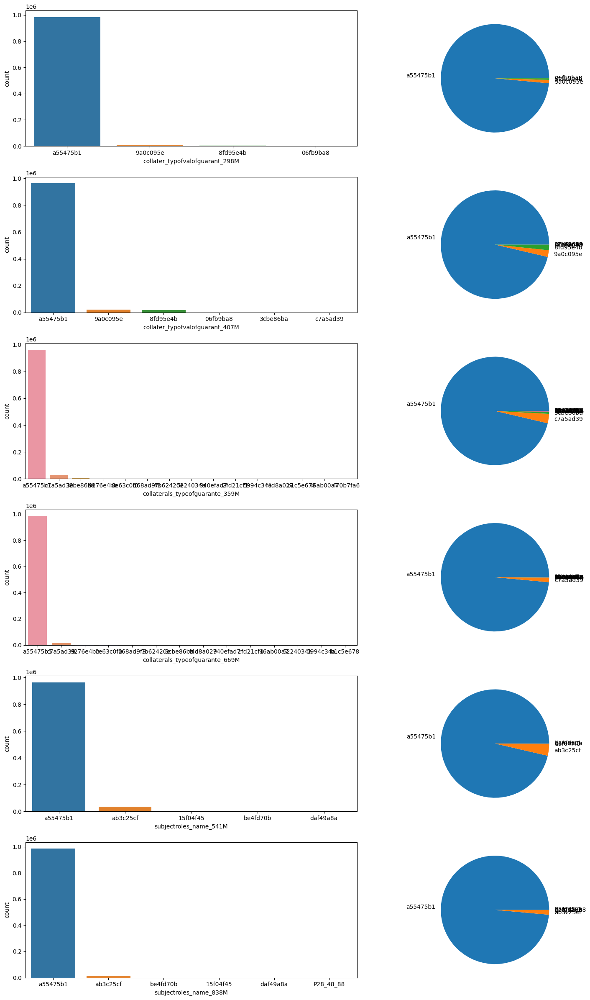

In [195]:
plot_categorical(df_train_credit_bureau_a_2, 'M')

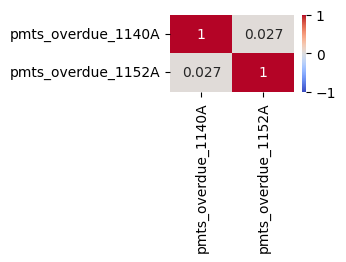

In [196]:
plot_corr(df_train_credit_bureau_a_2, 'A')

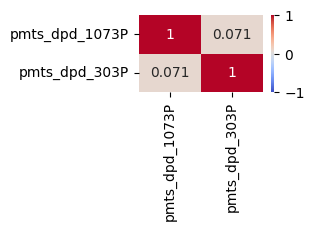

In [197]:
plot_corr(df_train_credit_bureau_a_2, 'P')

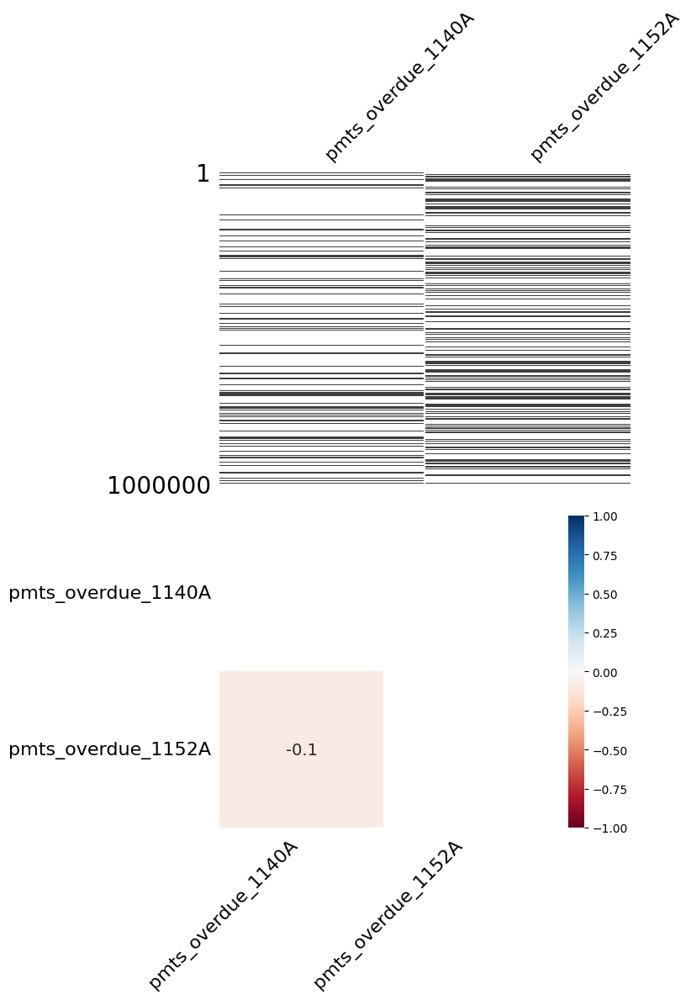

In [198]:
plot_null(df_train_credit_bureau_a_2, 'A')

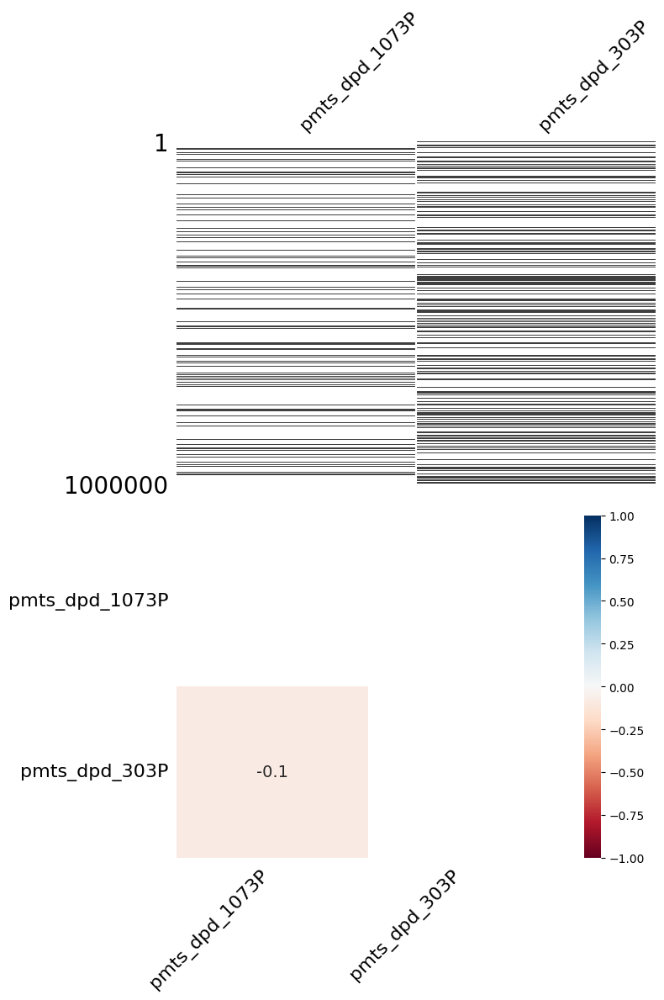

In [199]:
plot_null(df_train_credit_bureau_a_2, 'P')

/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))
/opt/conda/lib/python3.10/site-packages/seaborn/matrix.py:309: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set(xlim=(0, self.data.shape[1]), ylim=(0, self.data.shape[0]))


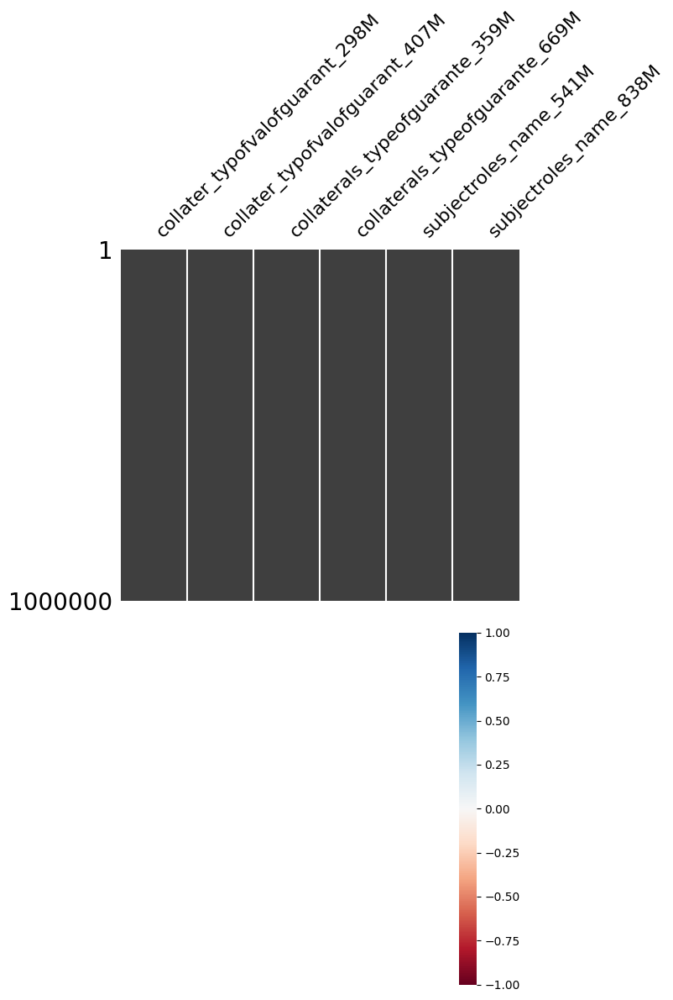

In [200]:
plot_null(df_train_credit_bureau_a_2, 'M')

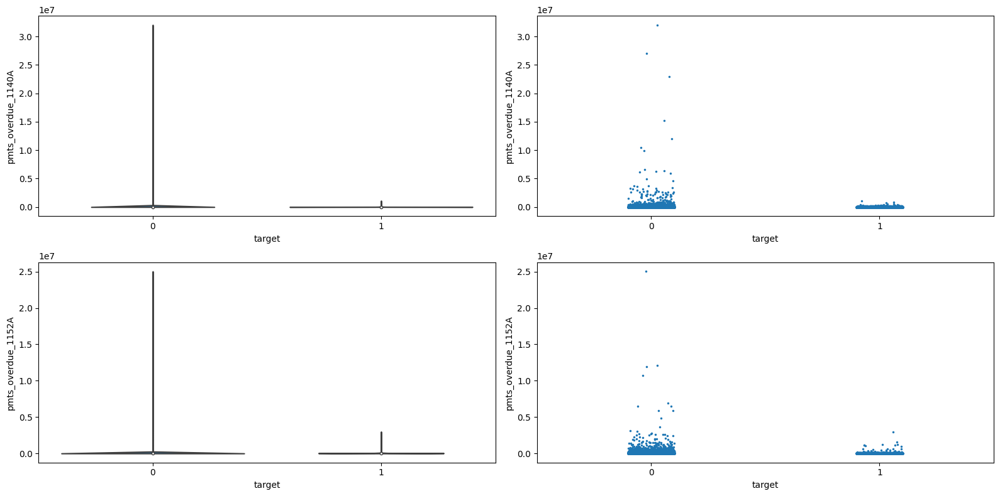

In [201]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_a_2.group_by('case_id').mean(), 'A')

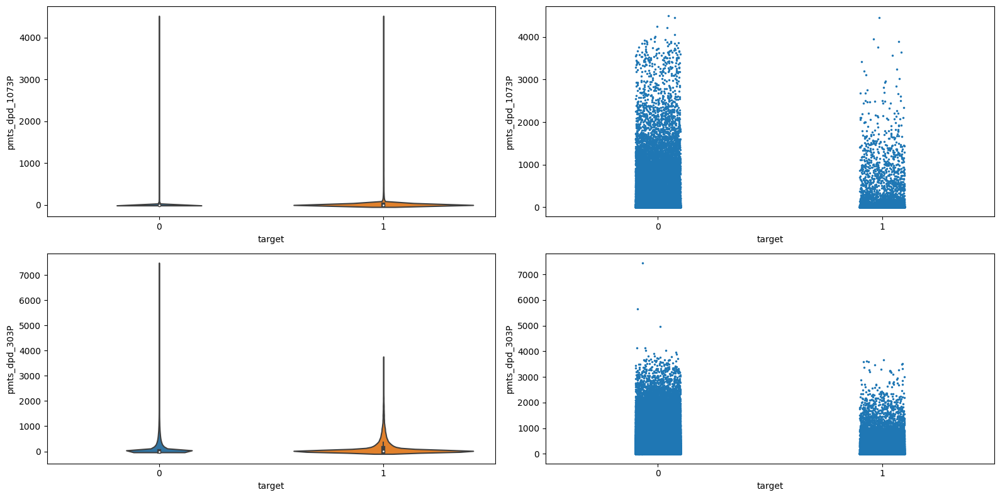

In [202]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_a_2.group_by('case_id').mean(), 'P')

In [203]:
with pl.Config() as cfg:
    cfg.set_tbl_rows(-1)
    for f in glob.iglob('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_credit_bureau_a_2_*.parquet'):
        display(
            pl.scan_parquet(f)
            .join(df_train_base.lazy(), on = 'case_id', how = 'left')
            .select(pl.col('WEEK_NUM').unique())
            .collect()
        )

WEEK_NUM
i64
54
55
56
57
58
59
60
61
62


WEEK_NUM
i64
9
10
11
12
13
14
15
16
17


WEEK_NUM
i64
0
1
2
3
4
5
6
7
8


WEEK_NUM
i64
63
64
65
66
67
68
69
70
71


WEEK_NUM
i64
45
46
47
48
49
50
51
52
53


WEEK_NUM
i64
18
19
20
21
22
23
24
25
26


WEEK_NUM
i64
36
37
38
39
40
41
42
43
44


WEEK_NUM
i64
81
82
83
84
85
86
87
88
89


WEEK_NUM
i64
27
28
29
30
31
32
33
34
35


WEEK_NUM
i64
90
91


WEEK_NUM
i64
72
73
74
75
76
77
78
79
80


# credit_bureau_b_2

In [204]:
df_train_credit_bureau_b_2 = scan_data_and_parse_dates('/kaggle/input/home-credit-credit-risk-model-stability/parquet_files/train/train_credit_bureau_b_2.parquet')

In [205]:
with pl.Config() as cfg:
    cfg.set_fmt_str_lengths(150)
    display(get_feature_definitions(df_train_credit_bureau_b_2.columns))

Variable,Description
str,str
"""case_id""",null
"""num_group1""",null
"""num_group2""",null
"""pmts_date_1107D""","""Payment date for an active contract according to credit bureau (num_group1 - contract, num_group2 - payment)."""
"""pmts_dpdvalue_108P""","""Value of past due payment for active contract (num_group1 - existing contract, num_group2 - payment)."""
"""pmts_pmtsoverdue_635A""","""Active contract that has overdue payments (num_group1 - existing contract, num_group2 - payment)."""


In [206]:
display(df_train_credit_bureau_b_2.head().collect())

case_id,num_group1,num_group2,pmts_date_1107D,pmts_dpdvalue_108P,pmts_pmtsoverdue_635A
i64,i64,i64,datetime[μs],f64,f64
467,0,0,2018-11-15 00:00:00,null,null
467,0,1,2018-12-15 00:00:00,null,null
467,1,0,2018-12-15 00:00:00,null,null
467,2,0,2016-10-15 00:00:00,0.0,0.0
467,2,1,2016-11-15 00:00:00,0.0,0.0


In [207]:
display(df_train_credit_bureau_b_2.collect().describe())

describe,case_id,num_group1,num_group2,pmts_date_1107D,pmts_dpdvalue_108P,pmts_pmtsoverdue_635A
str,f64,f64,f64,str,f64,f64
"""count""",1.286755e6,1.286755e6,1.286755e6,"""1286755""",1.281394e6,1.281394e6
"""null_count""",0.0,0.0,0.0,"""0""",5361.0,5361.0
"""mean""",1.2294e6,0.74674,12.319729,null,24370.454599,11.859454
"""std""",679992.304346,1.121661,10.017129,null,574795.539374,455.176242
"""min""",467.0,0.0,0.0,"""2016-01-15 00:…",0.0,0.0
"""25%""",741898.0,0.0,4.0,null,0.0,0.0
"""50%""",1.416105e6,0.0,10.0,null,0.0,0.0
"""75%""",1.781534e6,1.0,19.0,null,0.0,0.0
"""max""",2.703436e6,20.0,36.0,"""2020-10-15 00:…",1.85124192e8,147470.61


- The max of `pmts_dpdvalue_108P` is more than `100000000 days ~ 273972 years`.

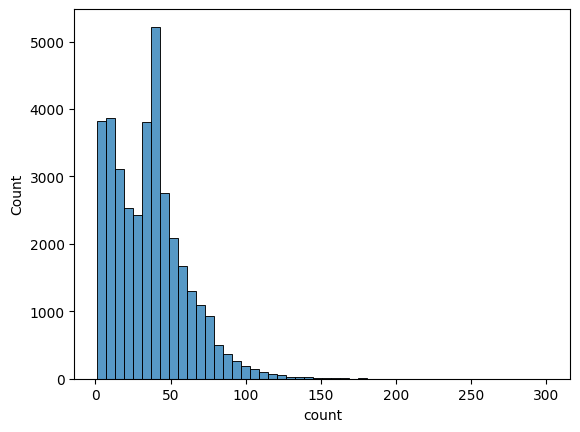

In [208]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_credit_bureau_b_2.group_by('case_id')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

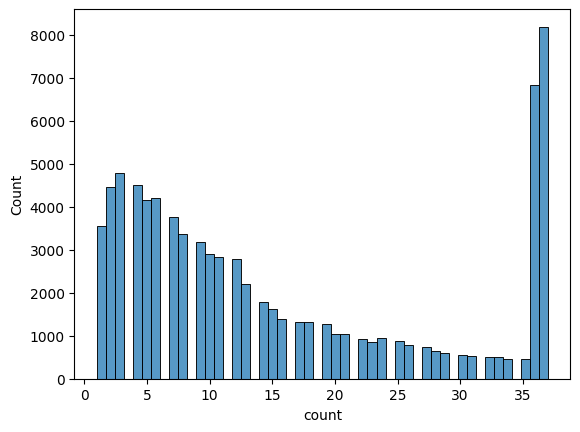

In [209]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    sns.histplot(df_train_credit_bureau_b_2.group_by('case_id', 'num_group1')
                 .agg(pl.len().alias('count'))
                 .select('count').collect()['count'].to_pandas(),
                 bins = 50);

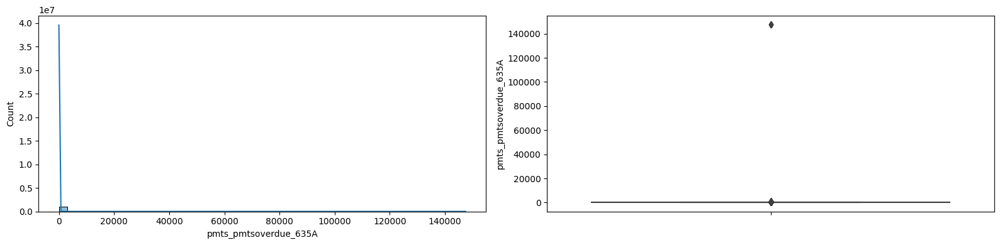

In [210]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_b_2, 'A')

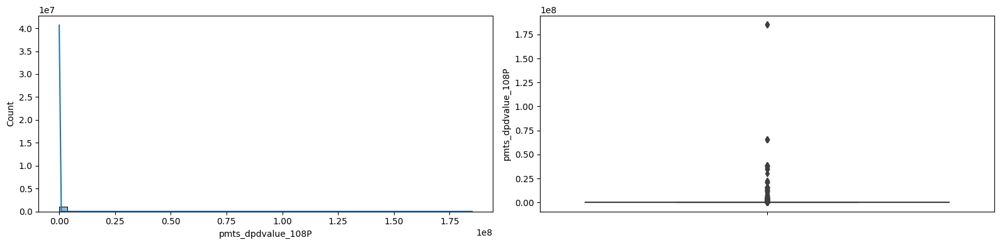

In [211]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical(df_train_credit_bureau_b_2, 'P')

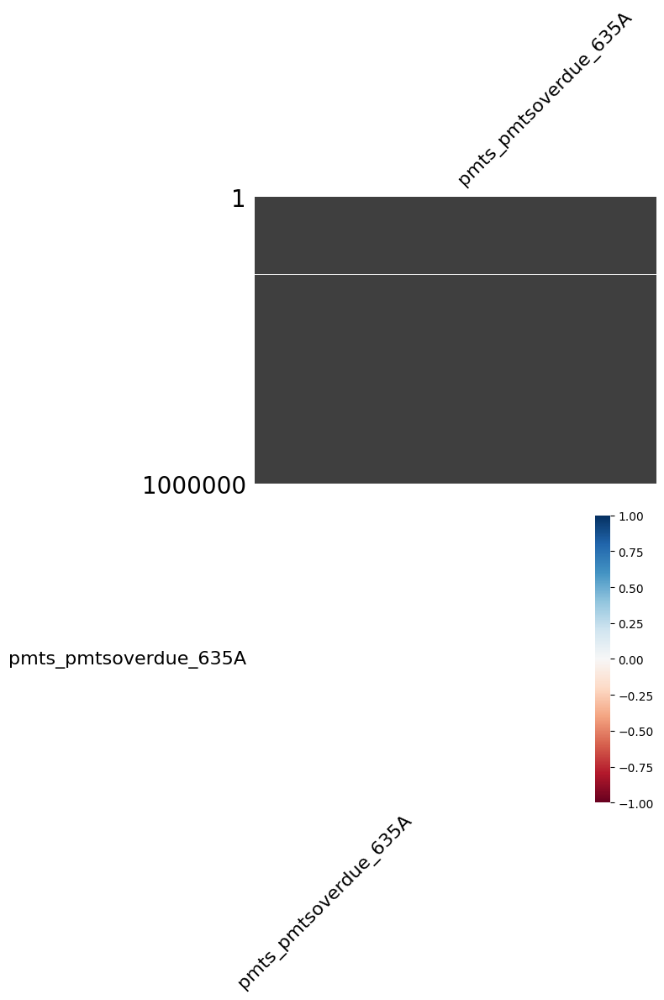

In [212]:
plot_null(df_train_credit_bureau_b_2, 'A')

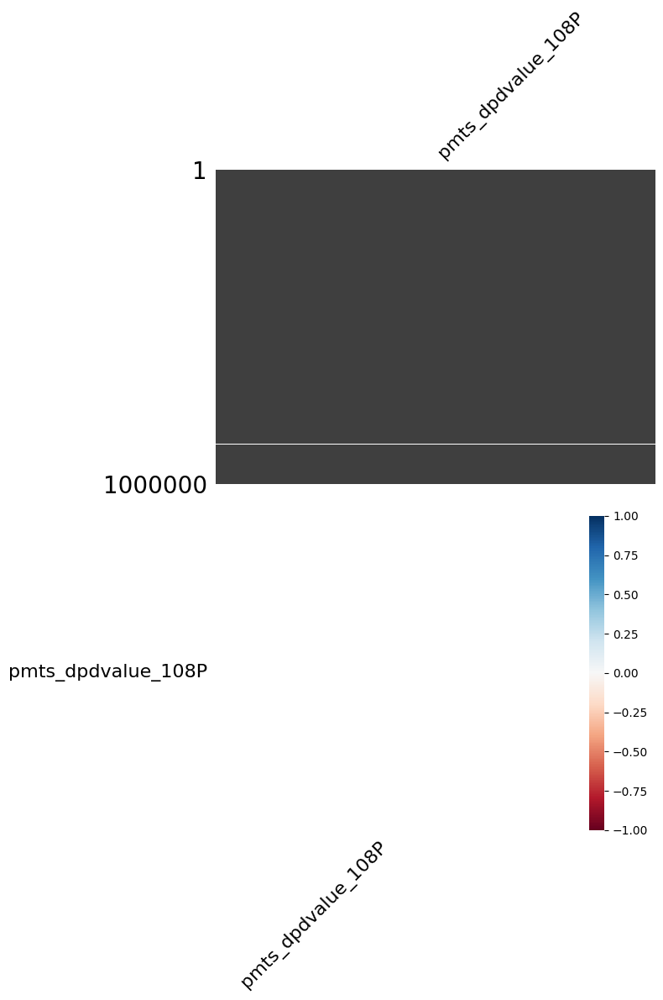

In [213]:
plot_null(df_train_credit_bureau_b_2, 'P')

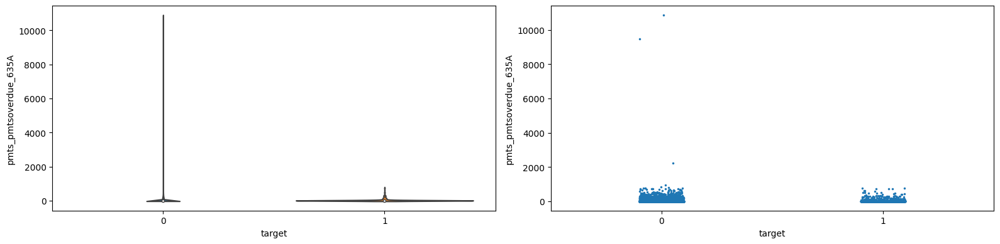

In [214]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_b_2.group_by('case_id').mean(), 'A')

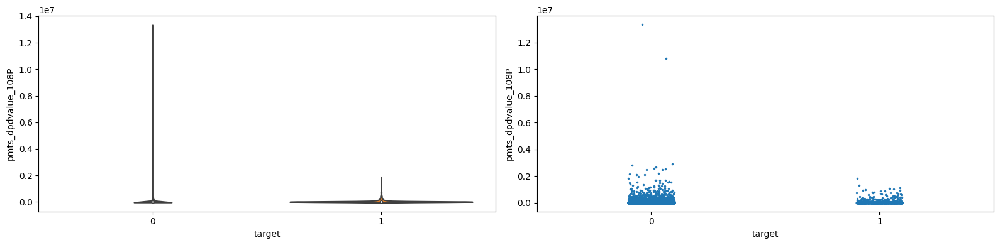

In [215]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    plot_numerical_by_target(df_train_base, df_train_credit_bureau_b_2.group_by('case_id').mean(), 'P')

# To be continued

- Visualization. Since the number of features is large, we should select good features to visualize.
  - E.g. features used in the [Starter Notebook](https://www.kaggle.com/code/jetakow/home-credit-2024-starter-notebook)
  - See also <https://www.kaggle.com/code/thomasmeiner/home-credit-eda-feature-engineering-modelling>
  - We have plotted `A`, `P`, and `M` groups.
- Bivariate analysis. There are some features with similar/same descriptions. Those can be related.
  - We have plotted correlations in `A` and `P` groups.
  - We have plotted distributions of `A` and `P` groups by target. For depth>=1 tables we have used the mean for each `case_id`, but other aggregations might make some sense. Remember that `num_group1` and `num_group2` may have specific meanings.

# Some consideration

- Cast string features to `Categorical` to save memory.
- Use `float32` to further reduce memory.
- Think about high-cardinality features such as addresses and names.
- Think about high proportion of null values.
- Think about target imbalance.
- Features and target can be time-dependent.